In [ ]:
import yt
from yt.analysis_modules.halo_analysis.api import HaloCatalog
from yt.analysis_modules.halo_finding.api import HOPHaloFinder
from yt.data_objects.particle_filters import add_particle_filter

for n in range(955,956):
    fn='%04d'%n
    fd='/DD'+str(fn)
    ff='/DD'+str(fn)
    fpath='/mnt/scratch/deovratd/Cosmological/AP_test'+fd+ff
    data_ds = yt.load(fpath)
    time = data_ds.current_time.in_units('Gyr')
    Redshift = data_ds.current_redshift
    L = [0,0,1] # vector normal to cutting plane
    north_vector = [1,0,0]
    #d, c = data_ds.find_max("Dark_Matter_Density") 
    #center = ([0.105694,0.428903,0.535743])
    prj = yt.OffAxisProjectionPlot(data_ds,L, "density",center=[0.5078583,0.4575653,0.7079010],
                            width=((40,'kpc'),(40,'kpc')), depth=(20,'kpc'), north_vector=north_vector)
    colorbar = prj.set_cmap(field='density', cmap='plasma')
    prj.set_zlim('density', 1.0e-3,1.0e-1)
    #prj.annotate_title("Redshift="+str(Redshift))
    prj.annotate_title("time="+str(time))
    prj.set_xlabel('y (kpc)')
    prj.set_ylabel('x (kpc)')
    #prj.annotate_marker((c[0],c[1]), coord_system='plot',
    #              plot_args={'color':'red','s':500})
    #slc.annotate_text([-28,28], 'Cold mode FB, Self consistent jet axis, kinetic jet', coord_system='plot')
    #slc.annotate_quiver('velocity_y', 'velocity_z', factor=16,
    #                  plot_args={"color": "purple"})
    prj.save("/mnt/scratch/deovratd/Cosmological/AP_test/zax_"+str(fn))
    prj.show()

yt : [INFO     ] 2022-04-13 12:13:34,678 Parameters: current_time              = 157.71650202002
yt : [INFO     ] 2022-04-13 12:13:34,680 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2022-04-13 12:13:34,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-04-13 12:13:34,685 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-04-13 12:13:34,687 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-04-13 12:13:34,689 Parameters: current_redshift          = 1.961785989861
yt : [INFO     ] 2022-04-13 12:13:34,691 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2022-04-13 12:13:34,693 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2022-04-13 12:13:34,695 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-04-13 12:13:34,697 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 39139/39139 [00:08<00:00, 4650.68it/s]
yt : [INFO     ] 2022-04-

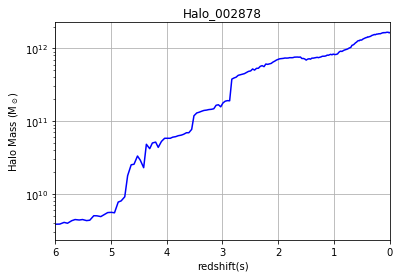

In [14]:
import h5py
import matplotlib.pyplot as plt
fh = h5py.File('/mnt/scratch/deovratd/Cosmological/jet_feedback/mw_trees.h5', 'r')
m = fh['Tree_002878/mass'][()] / 1.989e33
z = fh['Tree_002878/redshift'][()]
fig, ax = plt.subplots()
ax.semilogy(z,m,'b-')
ax.set_xlim(6,0)
ax.set_xlabel('redshift(s)')
ax.set_ylabel('Halo Mass (M$_\odot$)')
ax.set_title('Halo_002878')
ax.grid(True)
fh.close()

In [20]:
import yt
from yt.analysis_modules.star_analysis.api import StarFormationRate
from yt.data_objects.particle_filters import add_particle_filter

def Stars(pfilter, data):
      return data[("DarkMatter", "particle_type")] == 2
add_particle_filter("stars", function=Stars, filtered_type='DarkMatter',
                    requires=["particle_type"])


ds = yt.load("/mnt/scratch/deovratd/Cosmological/eff_3-e3/DD0260/DD0260")
ds.add_particle_filter('stars')
v, center = ds.find_max("Dark_Matter_Density")
sp = ds.sphere(center, (20, "kpc"))

# This puts the particle data for *all* the particles in the sphere sp
# into the arrays sm and ct.
mass = sp[("stars", "particle_mass")].in_units('Msun')
age = sp[("stars", "age")].in_units('Myr')
ct = sp[("stars", "creation_time")].in_units('Myr')

# Pick out only old stars using Numpy array fancy indexing.
threshold = ds.quan(10.0, "Myr")
mass_old = mass[age > threshold]
ct_old = ct[age > threshold]

#sfr = StarFormationRate(ds, star_mass=mass_old, star_creation_time=ct_old,
#                        volume=sp.volume())
sfr = StarFormationRate(ds, star_mass=mass, star_creation_time=ct,
                        volume=sp.volume())
#sfr.write_out(name="/mnt/scratch/deovratd/Cosmological/eff_3-e3/StarFormationRate_260.out")

yt : [WARNING  ] 2021-11-02 12:39:02,789 The stars particle filter already exists. Overriding.
yt : [INFO     ] 2021-11-02 12:39:02,863 Parameters: current_time              = 260.81660281079
yt : [INFO     ] 2021-11-02 12:39:02,865 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 12:39:02,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 12:39:02,867 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 12:39:02,868 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 12:39:02,869 Parameters: current_redshift          = 1.0805102612753
yt : [INFO     ] 2021-11-02 12:39:02,871 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 12:39:02,872 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 12:39:02,873 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 12:39:02,874 Parameters: hubble_constant           = 0.695
Parsi

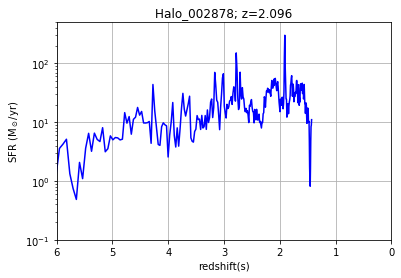

In [19]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
ax.semilogy(sfr.redshift,sfr.Msol_yr,'b-')
ax.set_xlim(6,0)
ax.set_ylim(0.1,500)
ax.set_xlabel('redshift(s)')
ax.set_ylabel('SFR (M$_\odot$/yr)')
ax.set_title('Halo_002878; z=2.096')
ax.grid(True)

In [7]:
ds.find_max("Dark_Matter_Density")

yt : [INFO     ] 2020-11-20 19:13:35,932 Max Value is 8.86453e+08 at 0.5075941085815430 0.5082101821899414 0.4896631240844727


(886453467.798676 code_mass/code_length**3,
 YTArray([0.50759411, 0.50821018, 0.48966312]) code_length)

yt : [INFO     ] 2021-10-07 15:08:48,211 Parameters: current_time              = 123.81653315489
yt : [INFO     ] 2021-10-07 15:08:48,215 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 15:08:48,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 15:08:48,219 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 15:08:48,222 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 15:08:48,224 Parameters: current_redshift          = 2.4941699344802
yt : [INFO     ] 2021-10-07 15:08:48,226 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 15:08:48,227 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 15:08:48,229 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 15:08:48,231 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3232/3232 [00:00<00:00, 4697.54it/s]
yt : [INFO     ] 2021-10-0


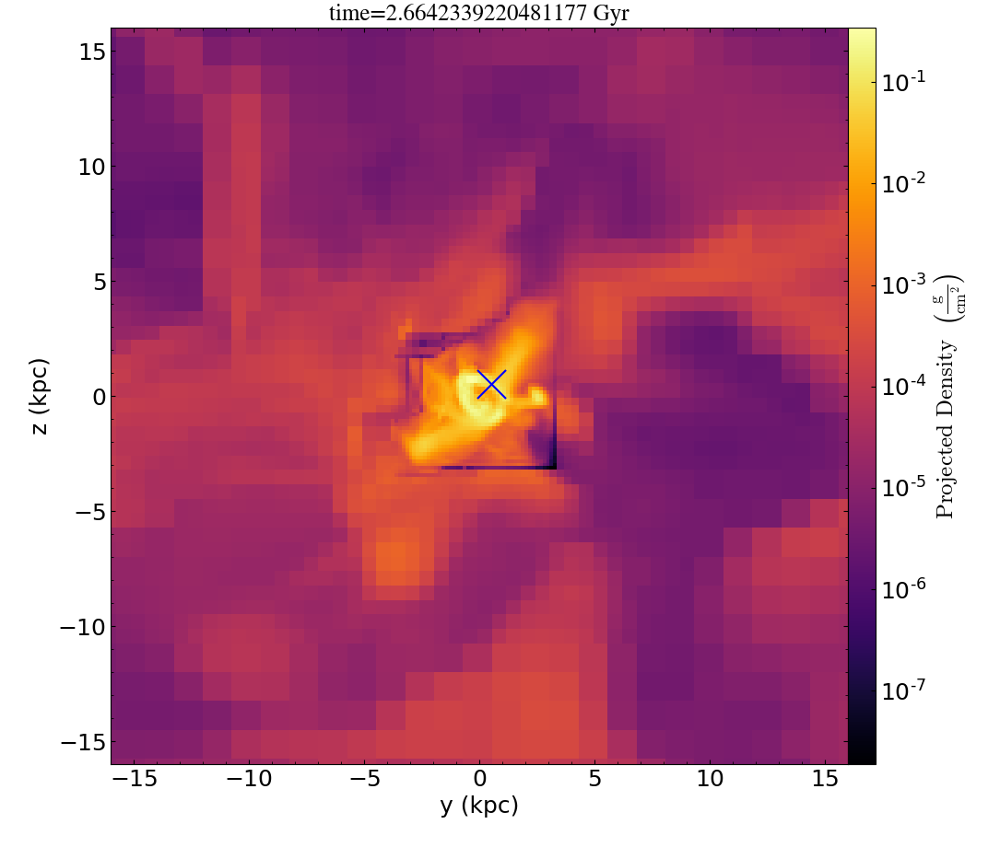

yt : [INFO     ] 2021-10-07 15:09:57,809 Parameters: current_time              = 124.81660281776
yt : [INFO     ] 2021-10-07 15:09:57,811 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 15:09:57,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 15:09:57,816 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 15:09:57,818 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 15:09:57,820 Parameters: current_redshift          = 2.4751240873046
yt : [INFO     ] 2021-10-07 15:09:57,822 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 15:09:57,824 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 15:09:57,826 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 15:09:57,827 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3231/3231 [00:00<00:00, 4493.27it/s]
yt : [INFO     ] 2021-10-0

In [ ]:
import yt
from yt.analysis_modules.halo_analysis.api import HaloCatalog
from yt.analysis_modules.halo_finding.api import HOPHaloFinder
from yt.data_objects.particle_filters import add_particle_filter
for n in range(123,191):
    fn='%04d'%n
    fd='/DD'+str(fn)
    ff='/DD'+str(fn)
    fpath='/mnt/scratch/deovratd/Cosmological/eff_3-e3'+fd+ff
    data_ds = yt.load(fpath)
    time = data_ds.current_time.in_units('Gyr')

    ad = data_ds.all_data()
    L = [1,0,0] #vector normal to cutting plane
    north_vector = [0,0,1]
    d, c = data_ds.find_max("Dark_Matter_Density") 
    prj = yt.OffAxisProjectionPlot(data_ds,L, "density",center=("max","Dark_Matter_Density"), width=(32,'kpc'), 
                               depth=(4,'kpc'), north_vector=north_vector)
    colorbar = prj.set_cmap(field='density', cmap='inferno')
    #prj.annotate_grids()
    #prj.annotate_cell_edges()
    prj.set_font({'family': 'sans-serif', 'style': 'normal', 'weight': 'normal', 'size': 18})
    prj.set_xlabel('y (kpc)')
    prj.set_ylabel('z (kpc)')
    prj.annotate_marker((c[0],c[1]), coord_system='plot',
                    plot_args={'color':'blue','s':500})
    prj.annotate_title("time="+str(time))
    #prj.annotate_title("$\epsilon=0.003$")
    #prj.annotate_quiver('velocity_y', 'velocity_z', factor=16,
    #                  plot_args={"color": "purple"})
    prj.save("/mnt/scratch/deovratd/Cosmological/eff_3-e3/prjz_"+str(fn))
    prj.show()

yt : [INFO     ] 2021-10-07 13:30:51,951 Parameters: current_time              = 157.81660281079
yt : [INFO     ] 2021-10-07 13:30:51,953 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:30:51,955 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:30:51,957 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:30:51,959 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:30:51,961 Parameters: current_redshift          = 1.9604945911687
yt : [INFO     ] 2021-10-07 13:30:51,962 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:30:51,964 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:30:51,966 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:30:51,967 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3380/3380 [00:00<00:00, 6347.70it/s]
yt : [INFO     ] 2021-10-0


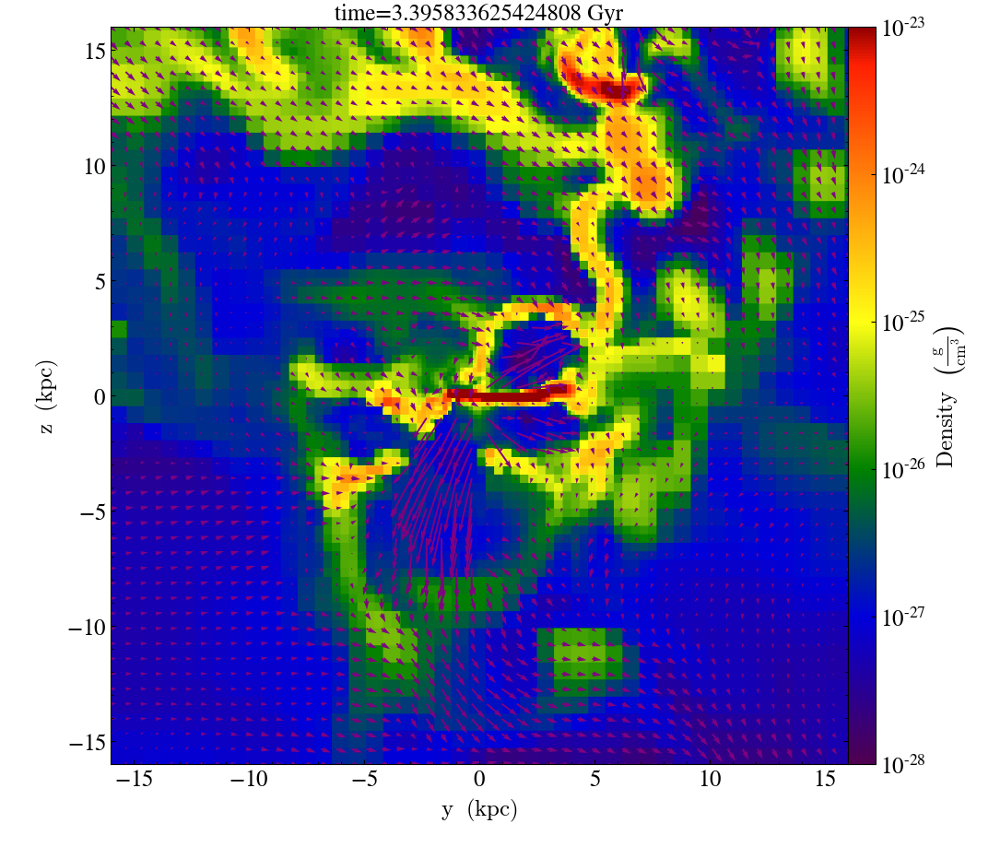

yt : [INFO     ] 2021-10-07 13:31:53,891 Parameters: current_time              = 158.81660281079
yt : [INFO     ] 2021-10-07 13:31:53,893 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:31:53,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:31:53,897 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:31:53,899 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:31:53,901 Parameters: current_redshift          = 1.9476690529888
yt : [INFO     ] 2021-10-07 13:31:53,902 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:31:53,904 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:31:53,906 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:31:53,908 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3413/3413 [00:00<00:00, 5356.83it/s]
yt : [INFO     ] 2021-10-0


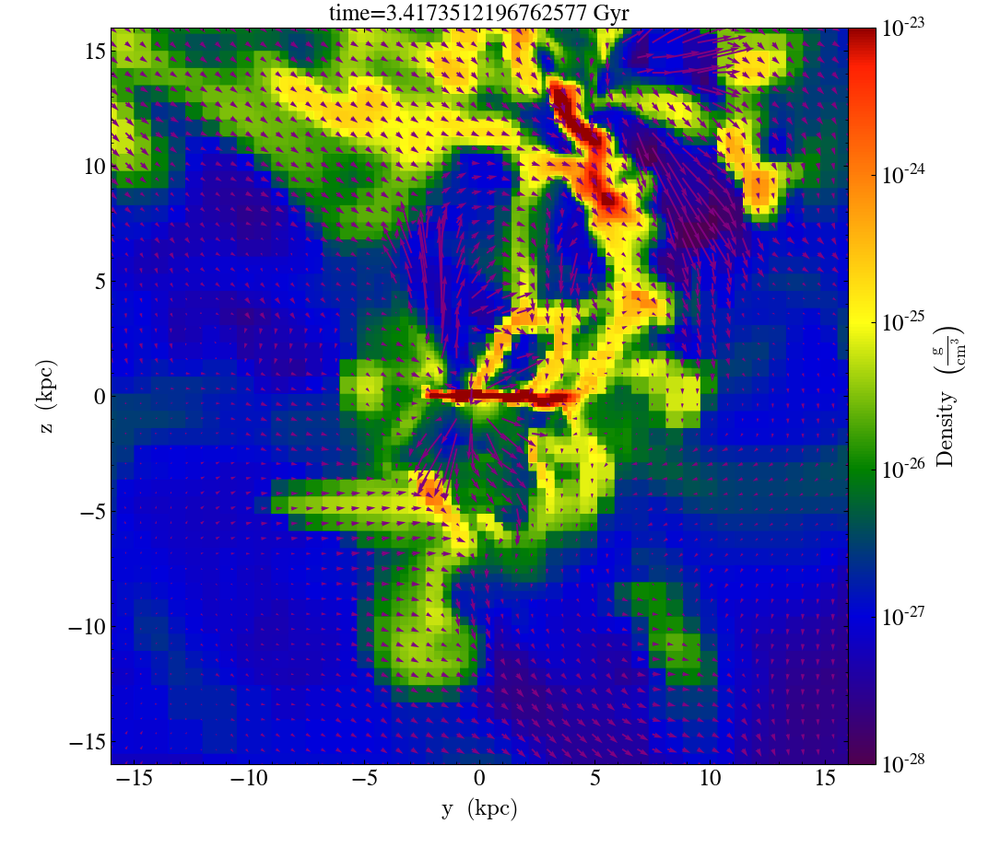

yt : [INFO     ] 2021-10-07 13:32:43,995 Parameters: current_time              = 159.81660281079
yt : [INFO     ] 2021-10-07 13:32:43,997 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:32:43,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:32:44,001 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:32:44,003 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:32:44,005 Parameters: current_redshift          = 1.9349719009497
yt : [INFO     ] 2021-10-07 13:32:44,006 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:32:44,008 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:32:44,010 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:32:44,012 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3443/3443 [00:00<00:00, 5649.18it/s]
yt : [INFO     ] 2021-10-0


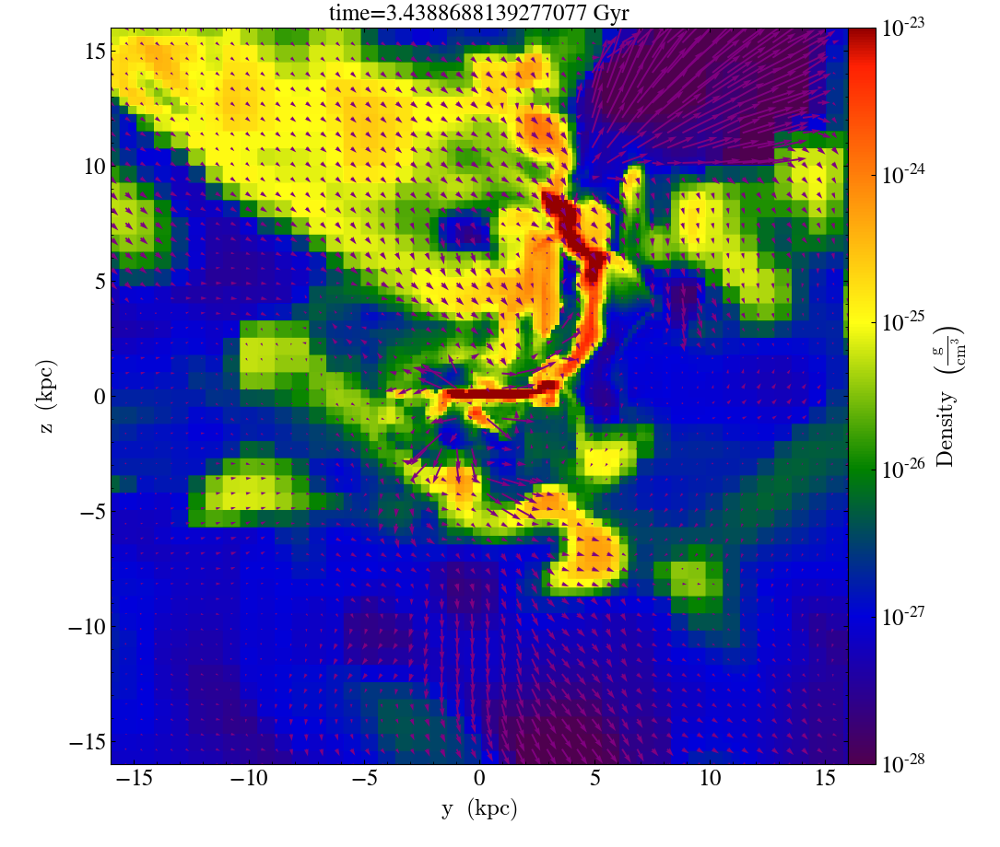

yt : [INFO     ] 2021-10-07 13:33:33,177 Parameters: current_time              = 160.81660281079
yt : [INFO     ] 2021-10-07 13:33:33,179 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:33:33,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:33:33,183 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:33:33,185 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:33:33,187 Parameters: current_redshift          = 1.9223998442962
yt : [INFO     ] 2021-10-07 13:33:33,188 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:33:33,190 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:33:33,192 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:33:33,194 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3342/3342 [00:00<00:00, 4115.52it/s]
yt : [INFO     ] 2021-10-0


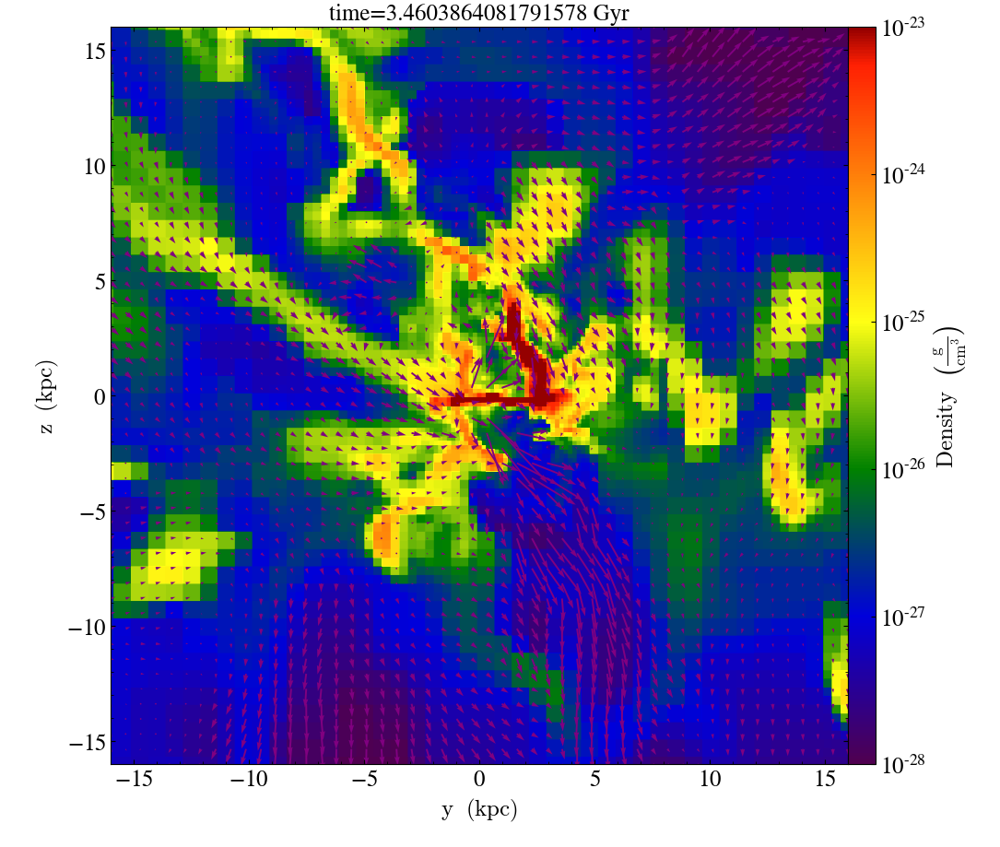

yt : [INFO     ] 2021-10-07 13:34:23,886 Parameters: current_time              = 161.81660281079
yt : [INFO     ] 2021-10-07 13:34:23,889 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:34:23,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:34:23,892 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:34:23,894 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:34:23,896 Parameters: current_redshift          = 1.9099590758029
yt : [INFO     ] 2021-10-07 13:34:23,898 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:34:23,900 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:34:23,901 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:34:23,903 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3339/3339 [00:00<00:00, 5754.33it/s]
yt : [INFO     ] 2021-10-0


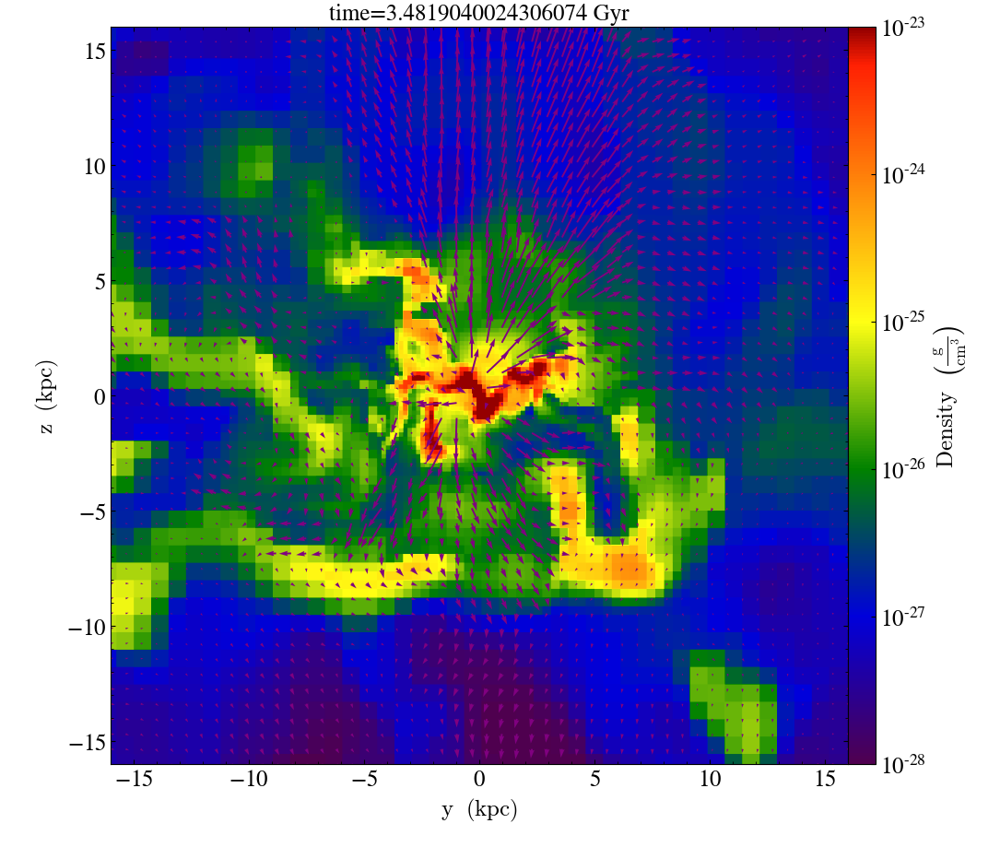

yt : [INFO     ] 2021-10-07 13:35:13,728 Parameters: current_time              = 162.81660281079
yt : [INFO     ] 2021-10-07 13:35:13,730 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:35:13,732 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:35:13,734 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:35:13,736 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:35:13,738 Parameters: current_redshift          = 1.8976438834237
yt : [INFO     ] 2021-10-07 13:35:13,739 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:35:13,741 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:35:13,743 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:35:13,744 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3380/3380 [00:00<00:00, 5405.14it/s]
yt : [INFO     ] 2021-10-0


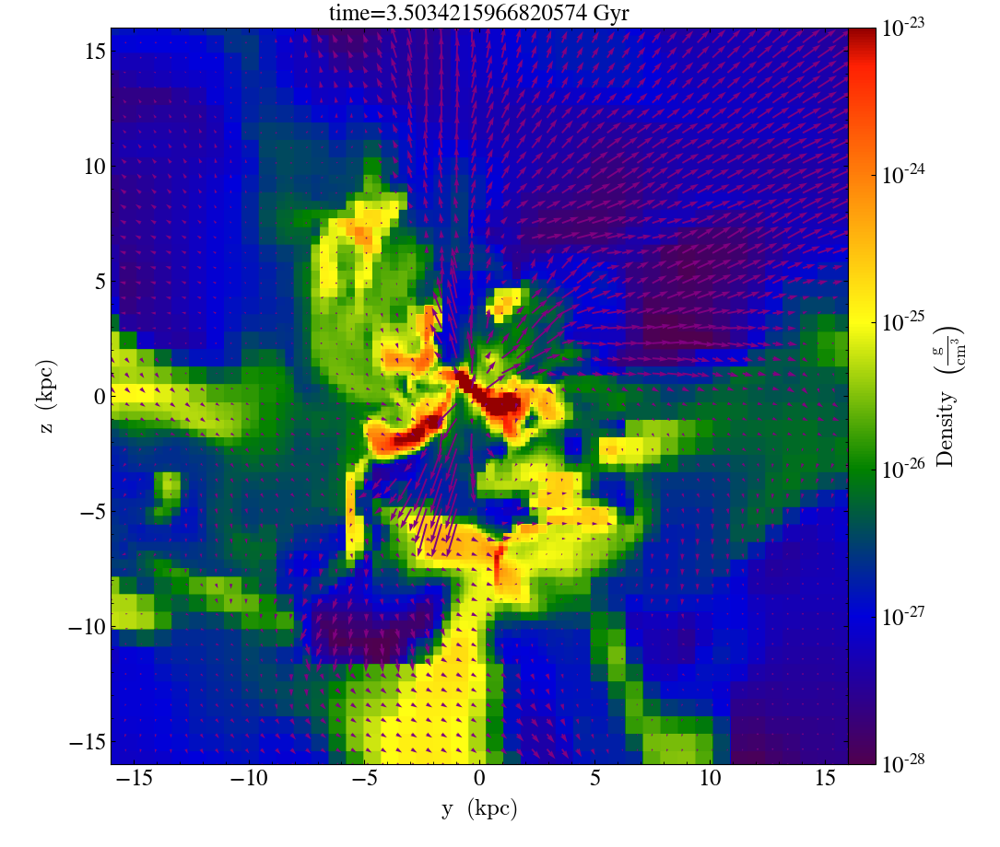

yt : [INFO     ] 2021-10-07 13:36:05,576 Parameters: current_time              = 163.81660281079
yt : [INFO     ] 2021-10-07 13:36:05,578 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:36:05,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:36:05,582 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:36:05,584 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:36:05,585 Parameters: current_redshift          = 1.8854437623787
yt : [INFO     ] 2021-10-07 13:36:05,587 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:36:05,589 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:36:05,590 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:36:05,592 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3396/3396 [00:00<00:00, 5515.47it/s]
yt : [INFO     ] 2021-10-0


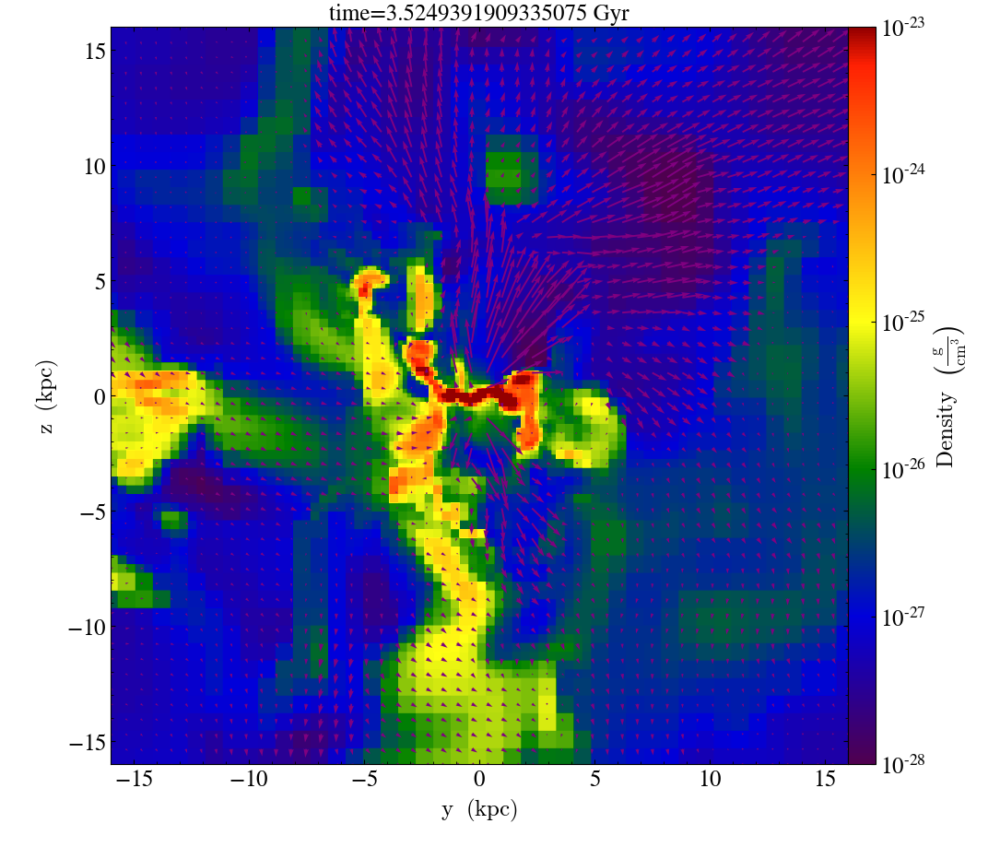

yt : [INFO     ] 2021-10-07 13:37:11,778 Parameters: current_time              = 164.81660281079
yt : [INFO     ] 2021-10-07 13:37:11,781 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:37:11,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:37:11,784 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:37:11,786 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:37:11,788 Parameters: current_redshift          = 1.8733687887993
yt : [INFO     ] 2021-10-07 13:37:11,790 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:37:11,791 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:37:11,793 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:37:11,795 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3411/3411 [00:00<00:00, 5433.14it/s]
yt : [INFO     ] 2021-10-0


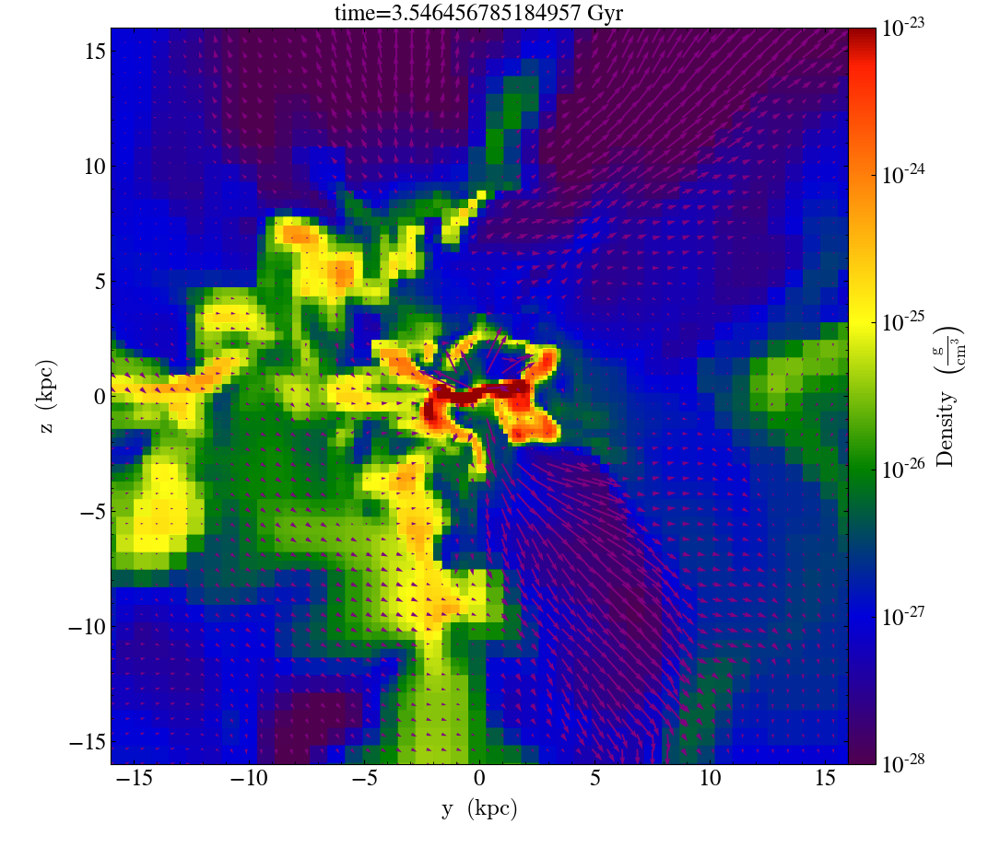

yt : [INFO     ] 2021-10-07 13:38:02,328 Parameters: current_time              = 165.81660281079
yt : [INFO     ] 2021-10-07 13:38:02,330 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:38:02,332 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:38:02,334 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:38:02,336 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:38:02,337 Parameters: current_redshift          = 1.8614169312397
yt : [INFO     ] 2021-10-07 13:38:02,339 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:38:02,341 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:38:02,343 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:38:02,344 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3457/3457 [00:00<00:00, 4987.50it/s]
yt : [INFO     ] 2021-10-0


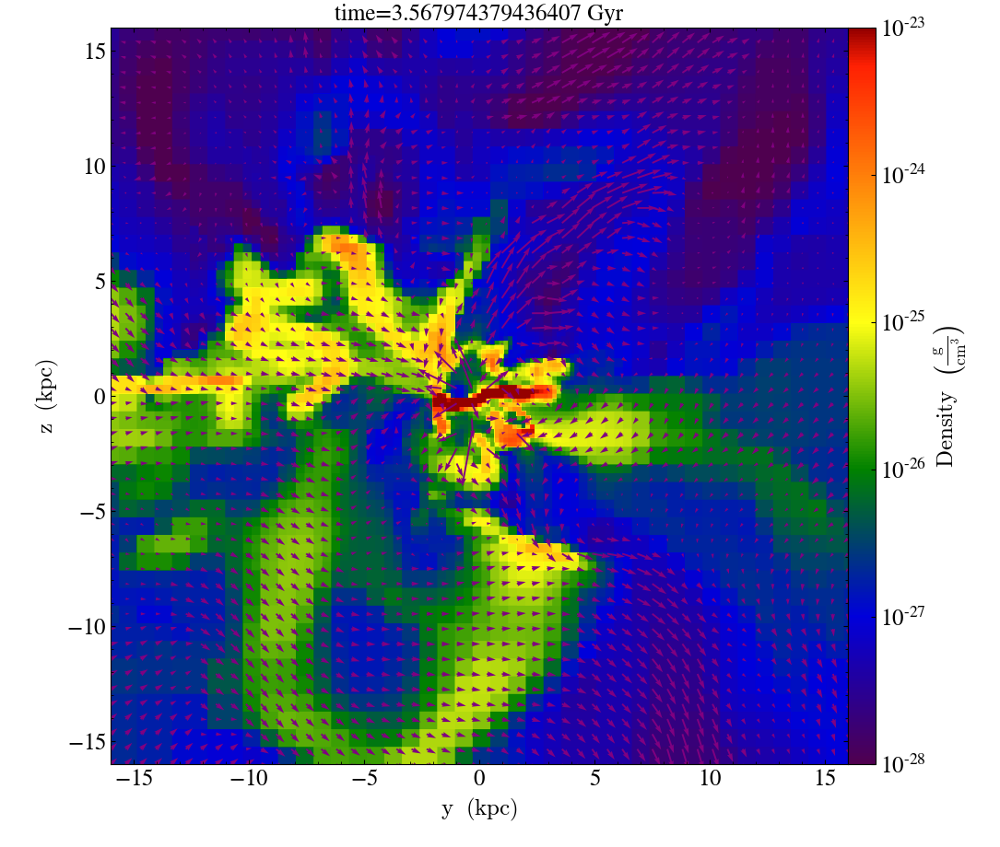

yt : [INFO     ] 2021-10-07 13:38:52,928 Parameters: current_time              = 166.81660281079
yt : [INFO     ] 2021-10-07 13:38:52,930 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:38:52,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:38:52,934 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:38:52,936 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:38:52,938 Parameters: current_redshift          = 1.8495716828282
yt : [INFO     ] 2021-10-07 13:38:52,939 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:38:52,941 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:38:52,943 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:38:52,944 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3384/3384 [00:00<00:00, 4897.70it/s]
yt : [INFO     ] 2021-10-0


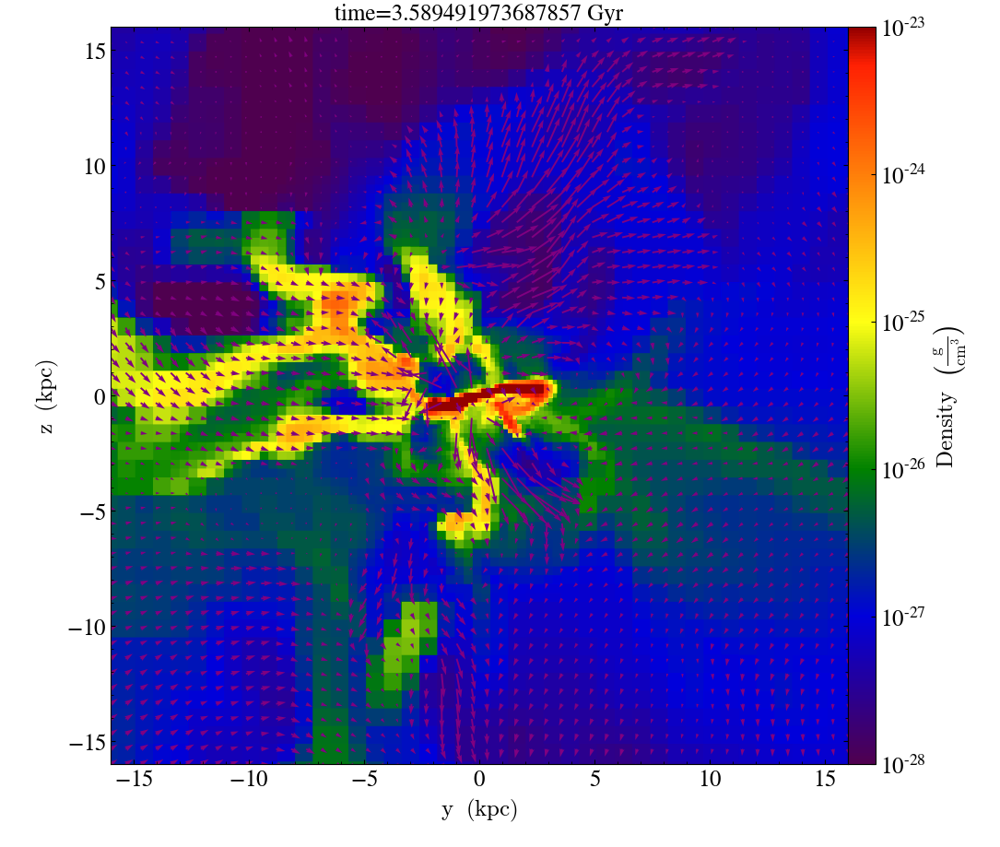

yt : [INFO     ] 2021-10-07 13:39:51,568 Parameters: current_time              = 167.81660281079
yt : [INFO     ] 2021-10-07 13:39:51,570 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:39:51,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:39:51,574 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:39:51,576 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:39:51,577 Parameters: current_redshift          = 1.837844756818
yt : [INFO     ] 2021-10-07 13:39:51,579 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:39:51,581 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:39:51,583 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:39:51,584 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3396/3396 [00:00<00:00, 4862.31it/s]
yt : [INFO     ] 2021-10-07


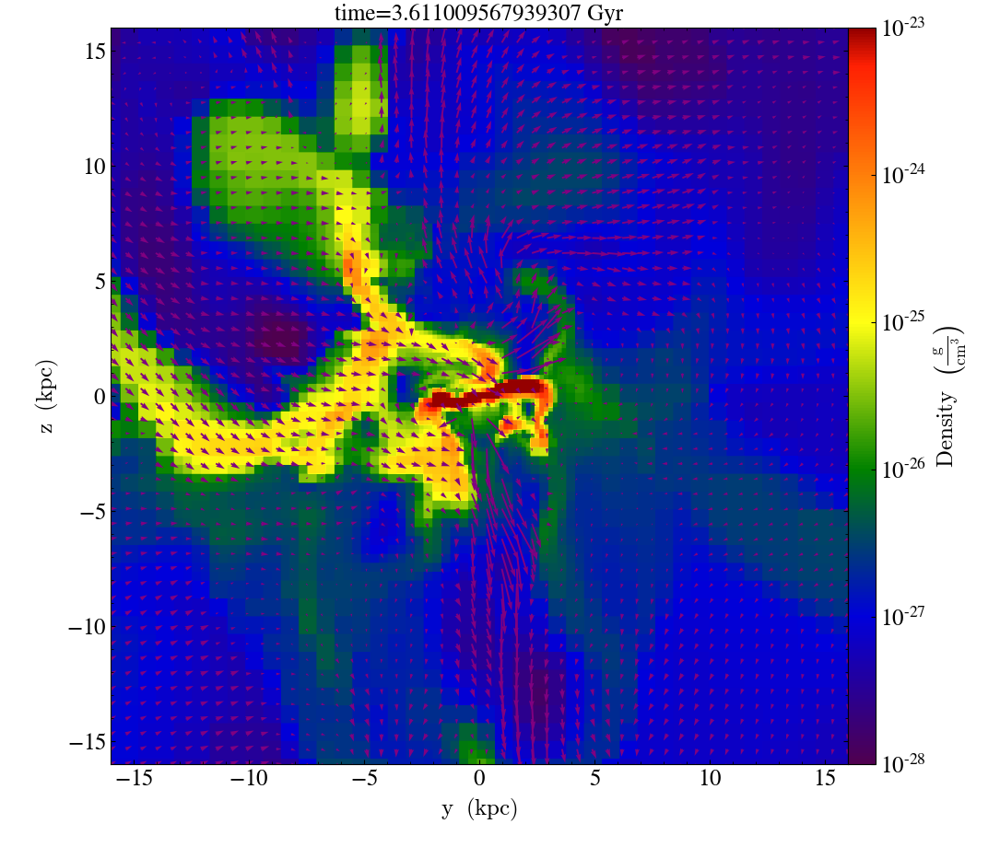

yt : [INFO     ] 2021-10-07 13:40:41,998 Parameters: current_time              = 168.81660281079
yt : [INFO     ] 2021-10-07 13:40:42,000 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:40:42,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:40:42,004 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:40:42,006 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:40:42,007 Parameters: current_redshift          = 1.826235334369
yt : [INFO     ] 2021-10-07 13:40:42,009 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:40:42,011 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:40:42,012 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:40:42,014 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3389/3389 [00:00<00:00, 4994.24it/s]
yt : [INFO     ] 2021-10-07


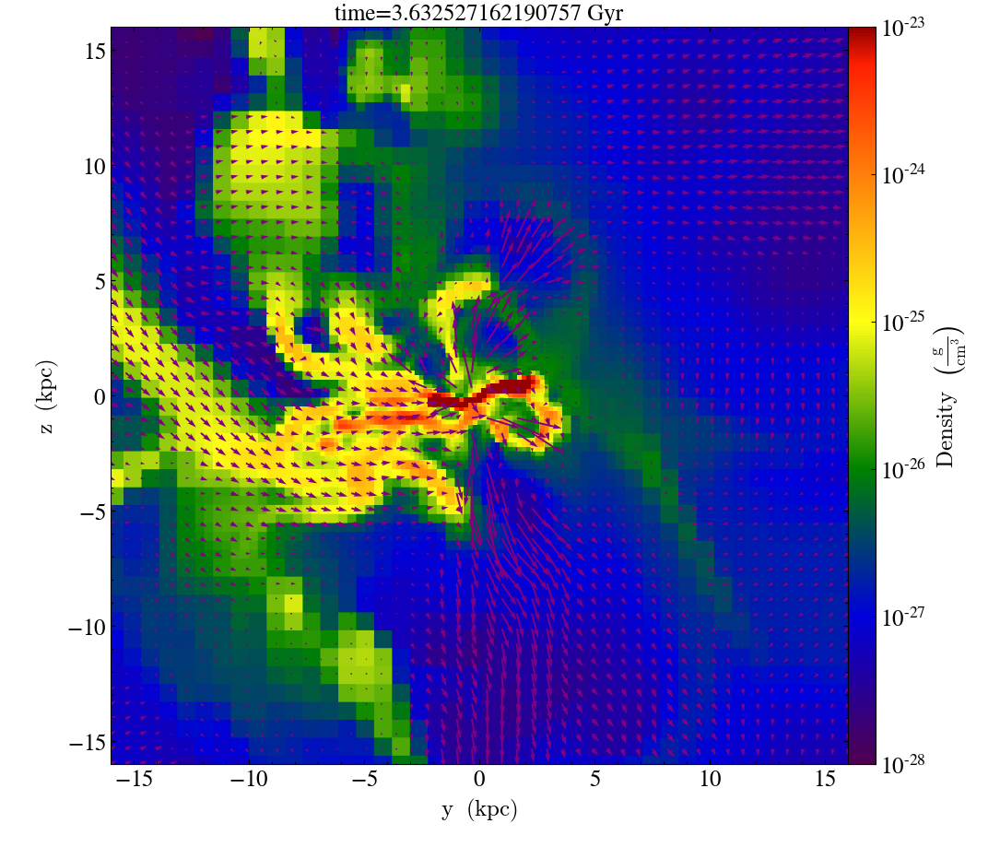

yt : [INFO     ] 2021-10-07 13:41:33,636 Parameters: current_time              = 169.81660281079
yt : [INFO     ] 2021-10-07 13:41:33,638 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:41:33,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:41:33,642 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:41:33,644 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:41:33,646 Parameters: current_redshift          = 1.8147325602179
yt : [INFO     ] 2021-10-07 13:41:33,647 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:41:33,649 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:41:33,651 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:41:33,652 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3416/3416 [00:00<00:00, 5009.97it/s]
yt : [INFO     ] 2021-10-0


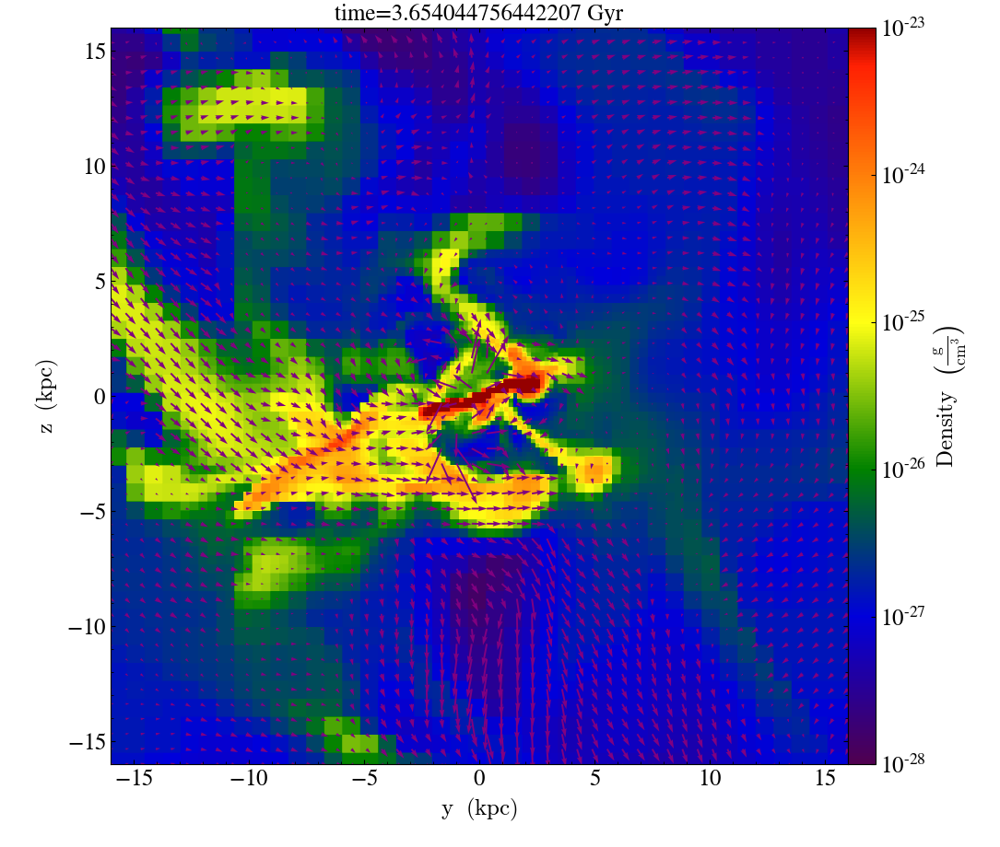

yt : [INFO     ] 2021-10-07 13:42:24,235 Parameters: current_time              = 170.81660281079
yt : [INFO     ] 2021-10-07 13:42:24,237 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:42:24,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:42:24,241 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:42:24,243 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:42:24,245 Parameters: current_redshift          = 1.8033370611939
yt : [INFO     ] 2021-10-07 13:42:24,246 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:42:24,248 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:42:24,250 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:42:24,252 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3544/3544 [00:00<00:00, 5054.62it/s]
yt : [INFO     ] 2021-10-0


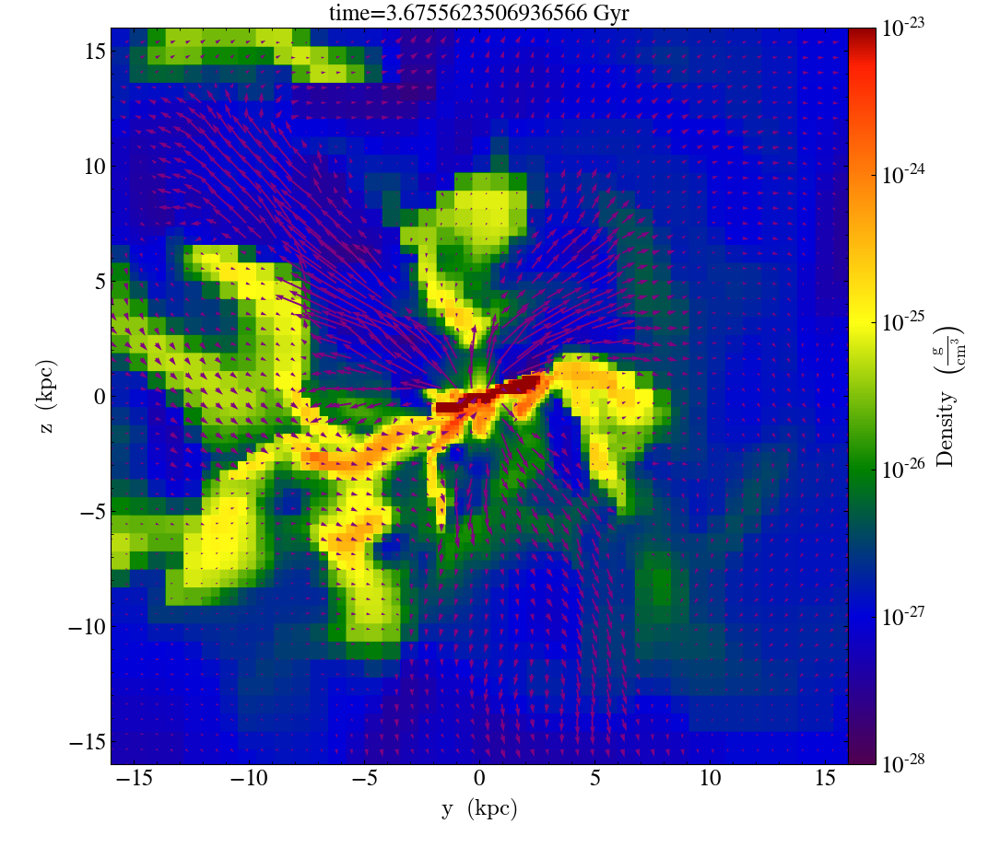

yt : [INFO     ] 2021-10-07 13:43:17,416 Parameters: current_time              = 171.81660281079
yt : [INFO     ] 2021-10-07 13:43:17,419 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:43:17,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:43:17,422 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:43:17,424 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:43:17,426 Parameters: current_redshift          = 1.7920538118363
yt : [INFO     ] 2021-10-07 13:43:17,428 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:43:17,430 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:43:17,432 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:43:17,433 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3528/3528 [00:00<00:00, 4955.32it/s]
yt : [INFO     ] 2021-10-0


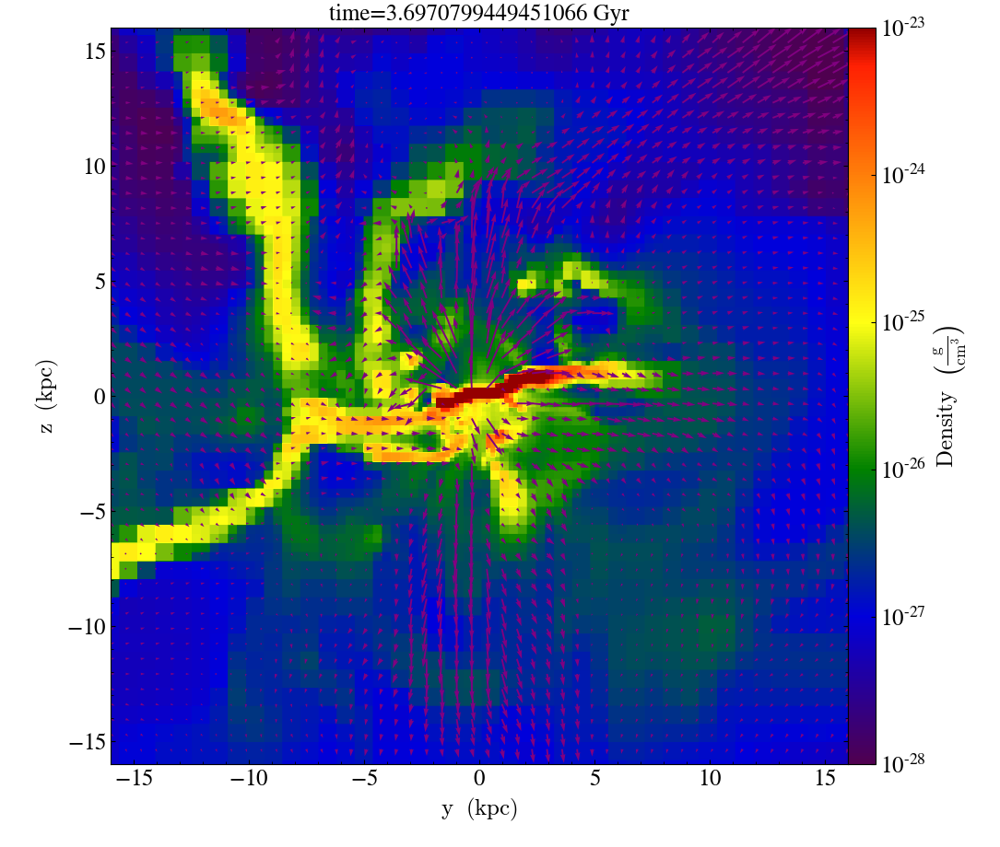

yt : [INFO     ] 2021-10-07 13:44:11,014 Parameters: current_time              = 172.81660281079
yt : [INFO     ] 2021-10-07 13:44:11,017 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:44:11,019 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:44:11,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:44:11,023 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:44:11,025 Parameters: current_redshift          = 1.7808786763141
yt : [INFO     ] 2021-10-07 13:44:11,027 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:44:11,029 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:44:11,030 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:44:11,032 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3472/3472 [00:01<00:00, 2765.16it/s]
yt : [INFO     ] 2021-10-0


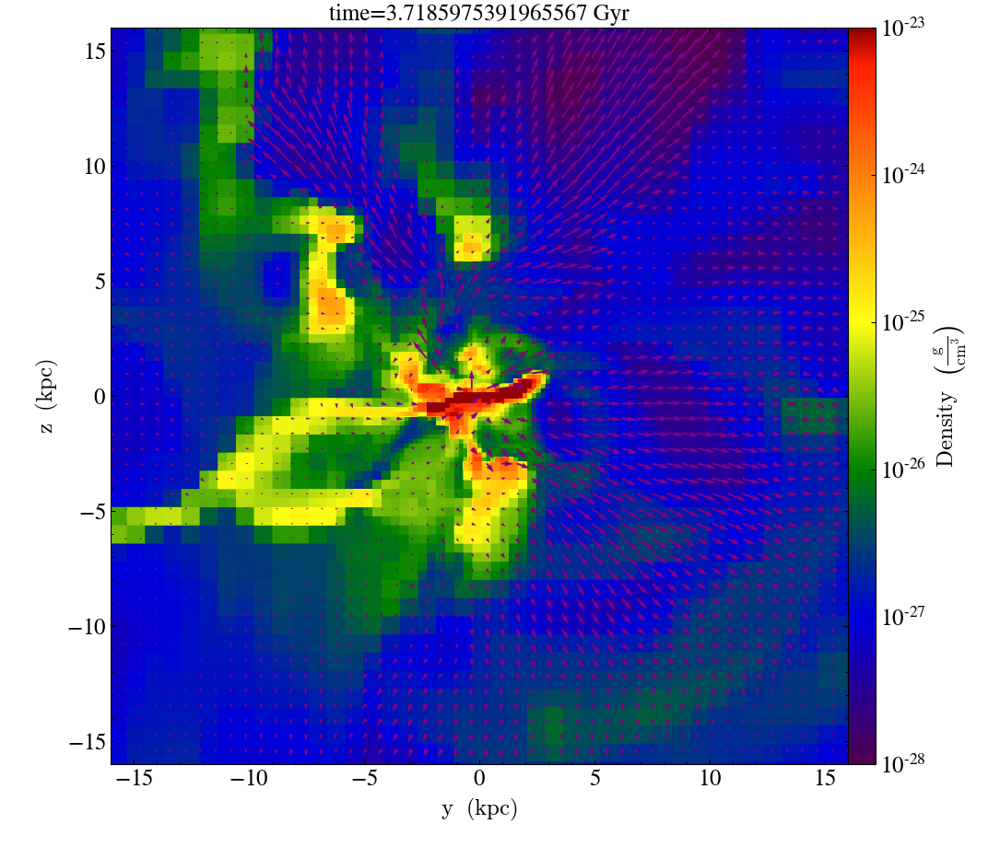

yt : [INFO     ] 2021-10-07 13:45:02,350 Parameters: current_time              = 173.81660281079
yt : [INFO     ] 2021-10-07 13:45:02,352 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:45:02,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:45:02,356 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:45:02,358 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:45:02,359 Parameters: current_redshift          = 1.7697990196036
yt : [INFO     ] 2021-10-07 13:45:02,361 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:45:02,363 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:45:02,364 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:45:02,366 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3407/3407 [00:00<00:00, 5030.49it/s]
yt : [INFO     ] 2021-10-0


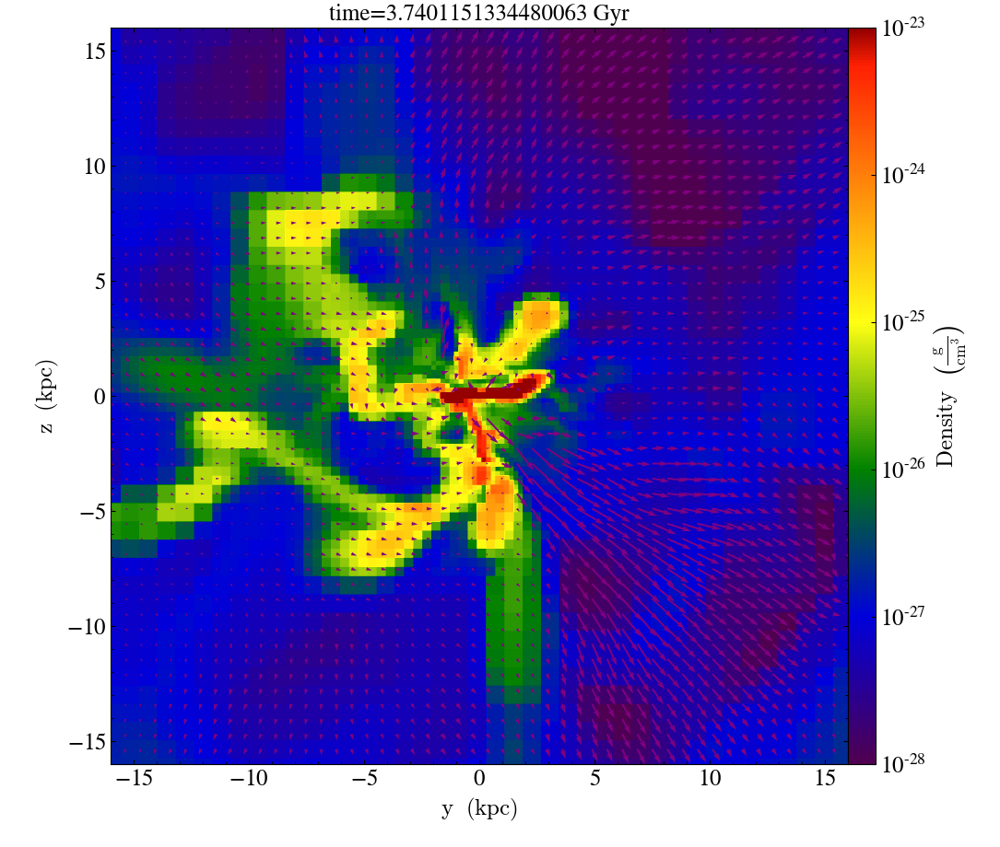

yt : [INFO     ] 2021-10-07 13:45:53,169 Parameters: current_time              = 174.81660281079
yt : [INFO     ] 2021-10-07 13:45:53,171 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:45:53,173 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:45:53,175 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:45:53,176 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:45:53,178 Parameters: current_redshift          = 1.7588266888637
yt : [INFO     ] 2021-10-07 13:45:53,180 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:45:53,181 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:45:53,183 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:45:53,185 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3438/3438 [00:00<00:00, 5201.54it/s]
yt : [INFO     ] 2021-10-0


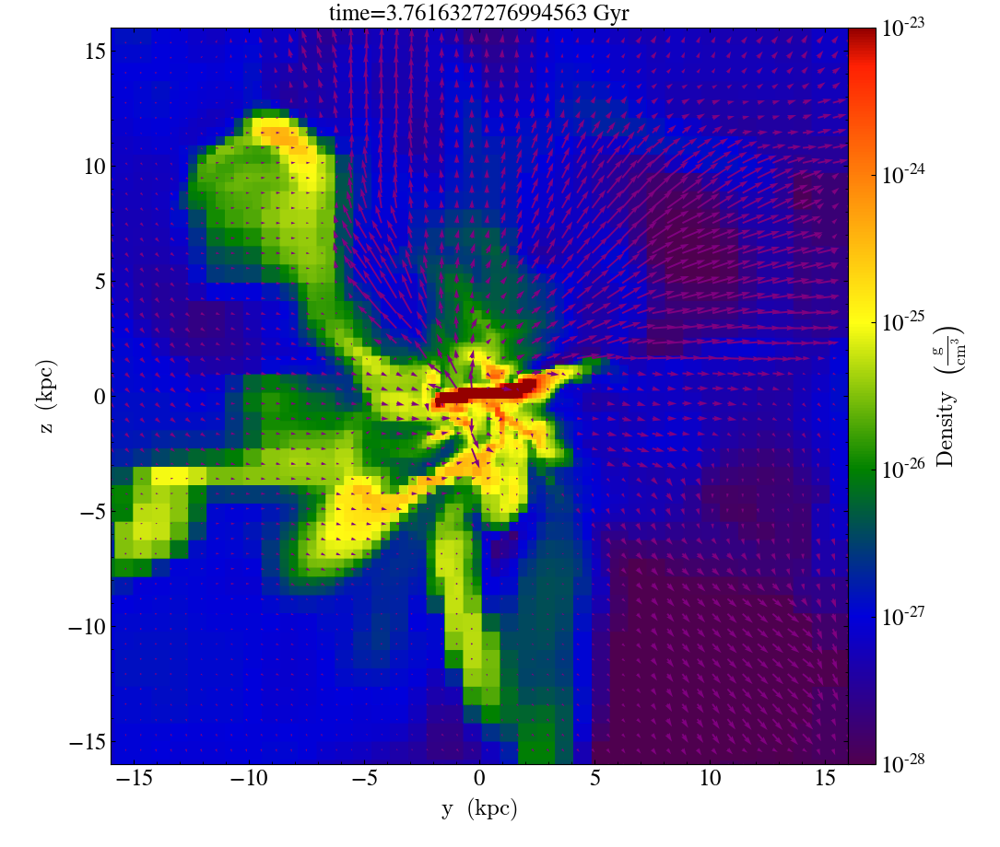

yt : [INFO     ] 2021-10-07 13:46:46,369 Parameters: current_time              = 175.81652164903
yt : [INFO     ] 2021-10-07 13:46:46,371 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:46:46,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:46:46,375 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:46:46,377 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:46:46,378 Parameters: current_redshift          = 1.7479609171031
yt : [INFO     ] 2021-10-07 13:46:46,380 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:46:46,382 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:46:46,383 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:46:46,385 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3454/3454 [00:00<00:00, 4242.36it/s]
yt : [INFO     ] 2021-10-0


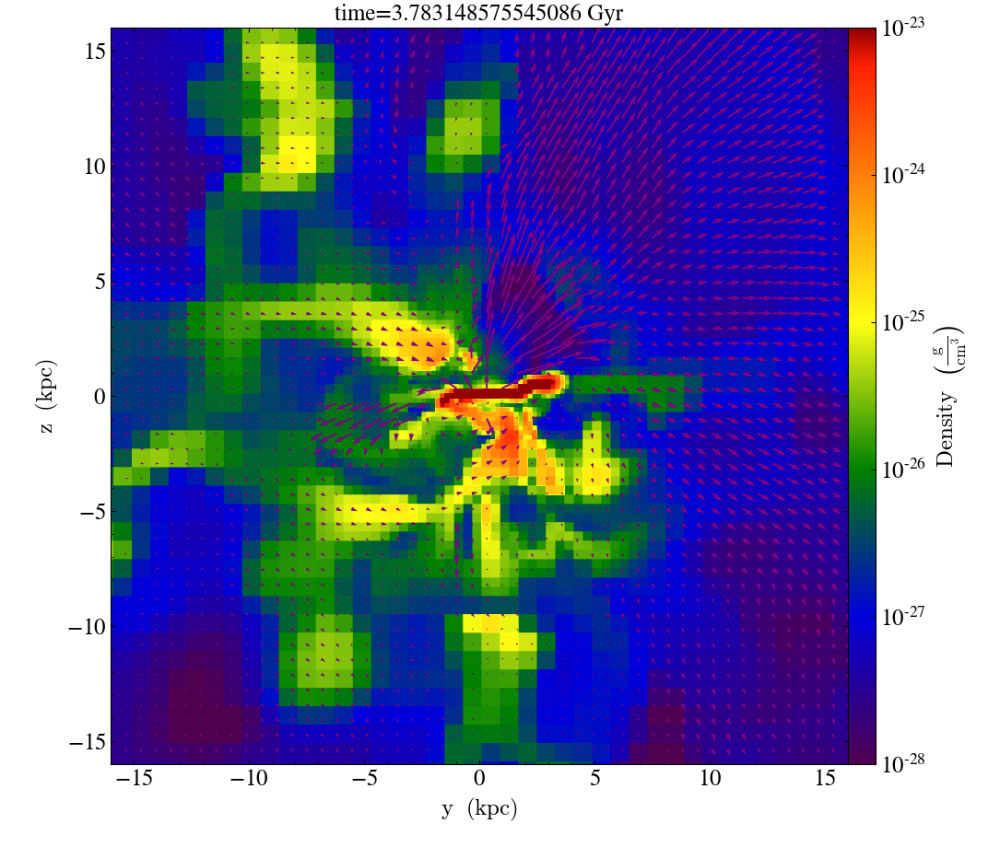

yt : [INFO     ] 2021-10-07 13:47:37,861 Parameters: current_time              = 176.81660281891
yt : [INFO     ] 2021-10-07 13:47:37,863 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:47:37,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:47:37,867 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:47:37,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:47:37,871 Parameters: current_redshift          = 1.7371869329446
yt : [INFO     ] 2021-10-07 13:47:37,873 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:47:37,875 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:47:37,877 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:47:37,879 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3502/3502 [00:00<00:00, 3882.87it/s]
yt : [INFO     ] 2021-10-0


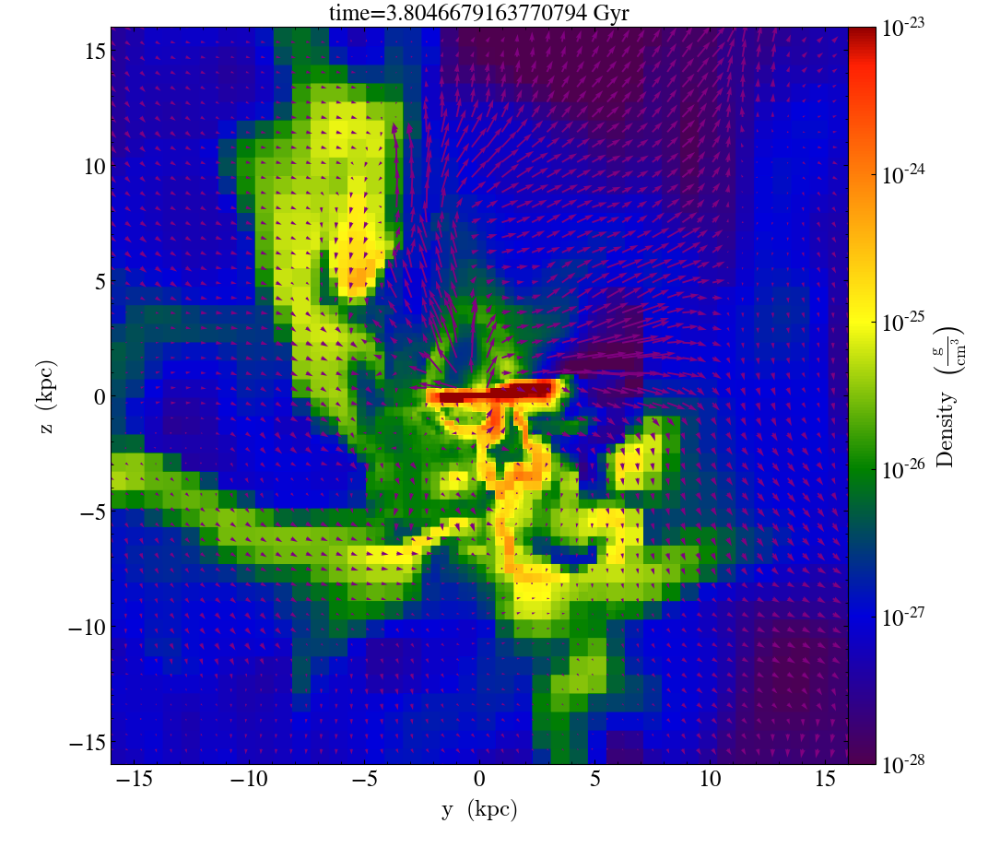

yt : [INFO     ] 2021-10-07 13:48:44,067 Parameters: current_time              = 177.81660281079
yt : [INFO     ] 2021-10-07 13:48:44,069 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:48:44,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:48:44,073 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:48:44,075 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:48:44,077 Parameters: current_redshift          = 1.7265111945253
yt : [INFO     ] 2021-10-07 13:48:44,079 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:48:44,081 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:48:44,083 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:48:44,084 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3548/3548 [00:00<00:00, 4916.69it/s]
yt : [INFO     ] 2021-10-0


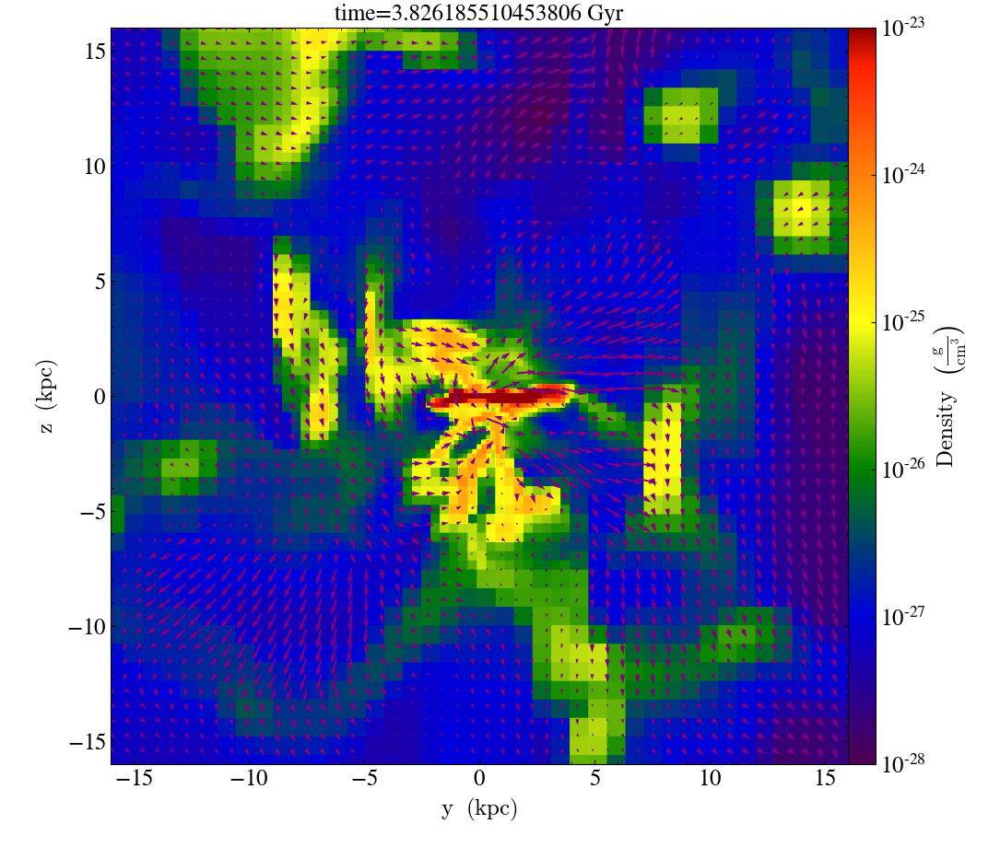

yt : [INFO     ] 2021-10-07 13:49:38,137 Parameters: current_time              = 178.81660281079
yt : [INFO     ] 2021-10-07 13:49:38,139 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:49:38,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:49:38,143 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:49:38,145 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:49:38,146 Parameters: current_redshift          = 1.7159366147459
yt : [INFO     ] 2021-10-07 13:49:38,148 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:49:38,150 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:49:38,152 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:49:38,153 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3546/3546 [00:00<00:00, 4910.70it/s]
yt : [INFO     ] 2021-10-0


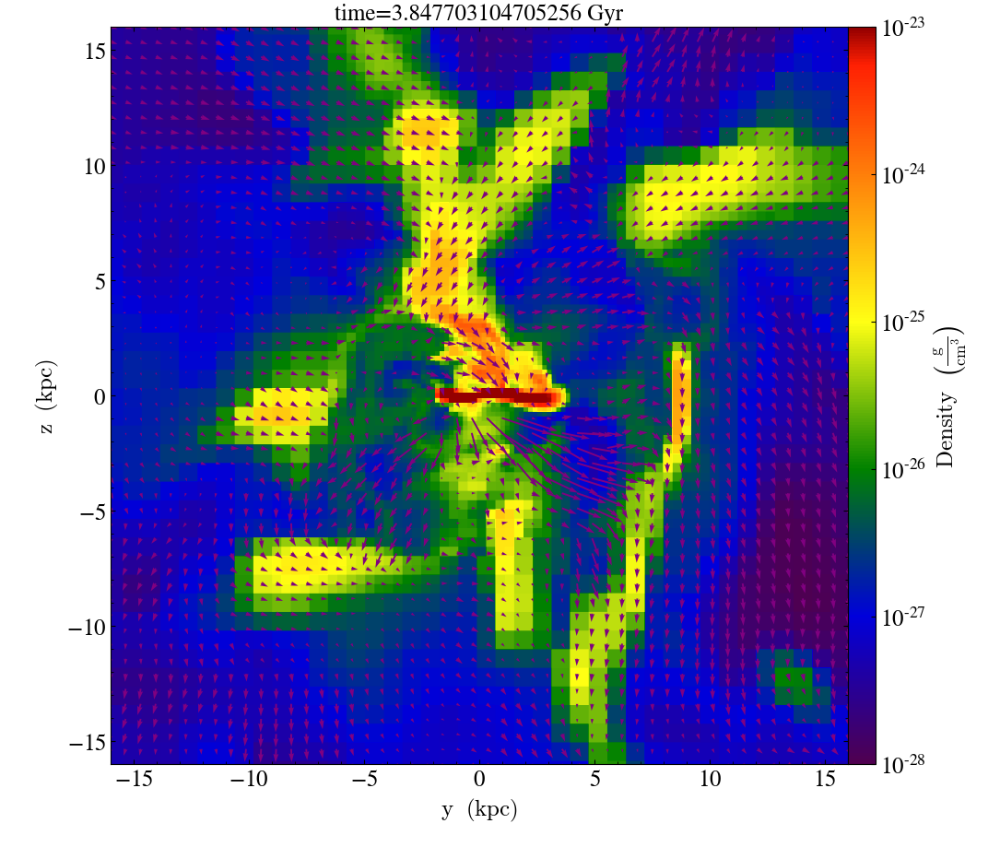

yt : [INFO     ] 2021-10-07 13:50:35,753 Parameters: current_time              = 179.81660281079
yt : [INFO     ] 2021-10-07 13:50:35,755 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:50:35,757 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:50:35,759 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:50:35,761 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:50:35,763 Parameters: current_redshift          = 1.7054598568252
yt : [INFO     ] 2021-10-07 13:50:35,765 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:50:35,766 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:50:35,768 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:50:35,770 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3470/3470 [00:00<00:00, 3987.65it/s]
yt : [INFO     ] 2021-10-0


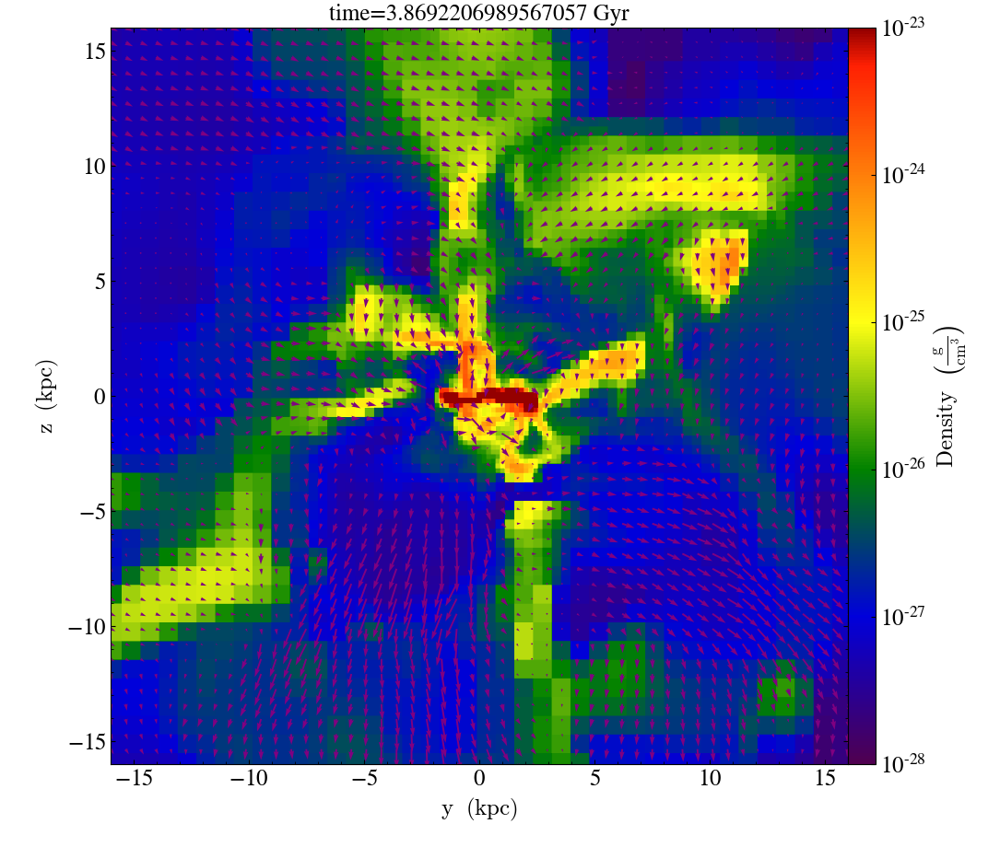

yt : [INFO     ] 2021-10-07 13:51:27,372 Parameters: current_time              = 180.81660281079
yt : [INFO     ] 2021-10-07 13:51:27,374 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:51:27,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:51:27,378 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:51:27,380 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:51:27,381 Parameters: current_redshift          = 1.6950672402494
yt : [INFO     ] 2021-10-07 13:51:27,383 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:51:27,385 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:51:27,387 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:51:27,388 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3380/3380 [00:00<00:00, 5427.10it/s]
yt : [INFO     ] 2021-10-0


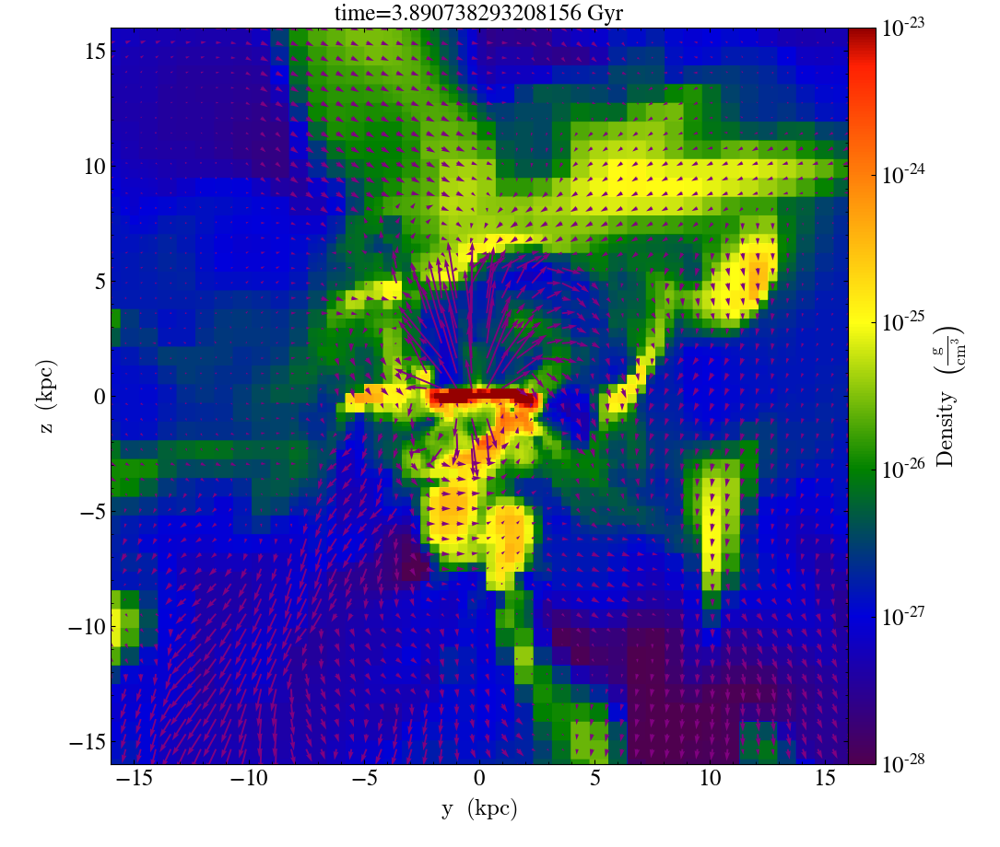

yt : [INFO     ] 2021-10-07 13:52:16,570 Parameters: current_time              = 181.81660281079
yt : [INFO     ] 2021-10-07 13:52:16,572 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:52:16,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:52:16,576 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:52:16,578 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:52:16,579 Parameters: current_redshift          = 1.6847715337689
yt : [INFO     ] 2021-10-07 13:52:16,581 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:52:16,583 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:52:16,585 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:52:16,586 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3517/3517 [00:00<00:00, 5210.75it/s]
yt : [INFO     ] 2021-10-0


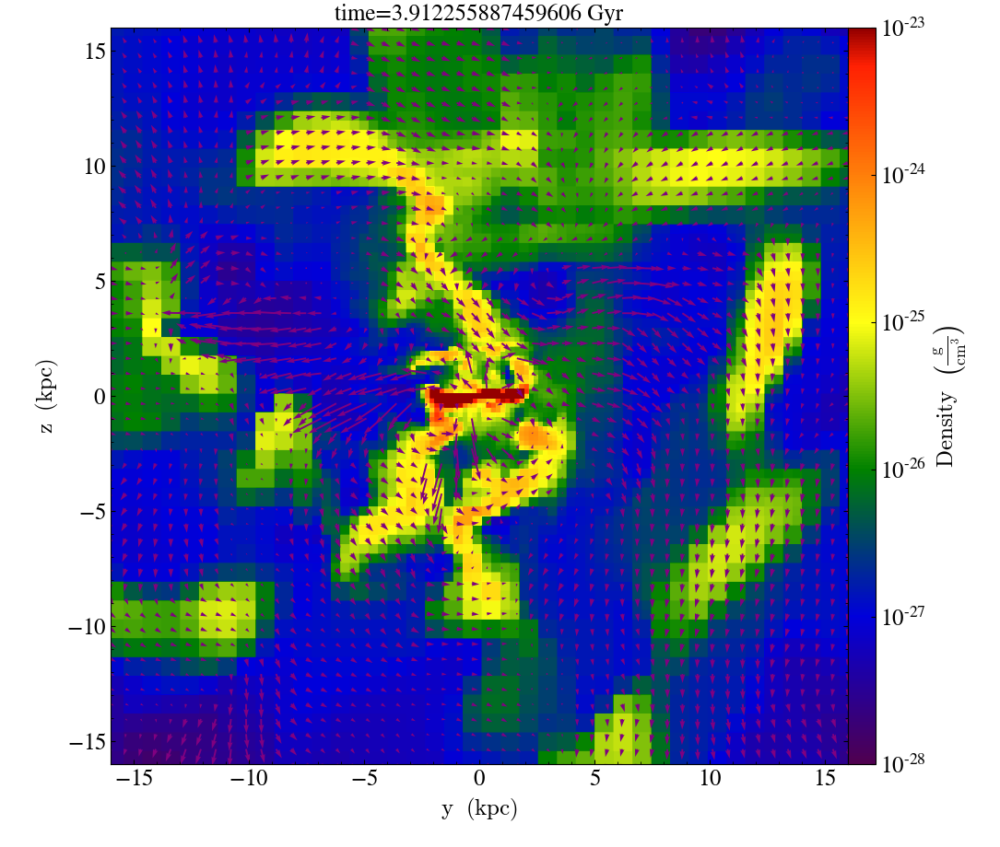

yt : [INFO     ] 2021-10-07 13:53:06,659 Parameters: current_time              = 182.81660281079
yt : [INFO     ] 2021-10-07 13:53:06,661 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:53:06,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:53:06,665 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:53:06,666 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:53:06,668 Parameters: current_redshift          = 1.6745713081134
yt : [INFO     ] 2021-10-07 13:53:06,670 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:53:06,672 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:53:06,673 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:53:06,675 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3457/3457 [00:00<00:00, 5339.33it/s]
yt : [INFO     ] 2021-10-0


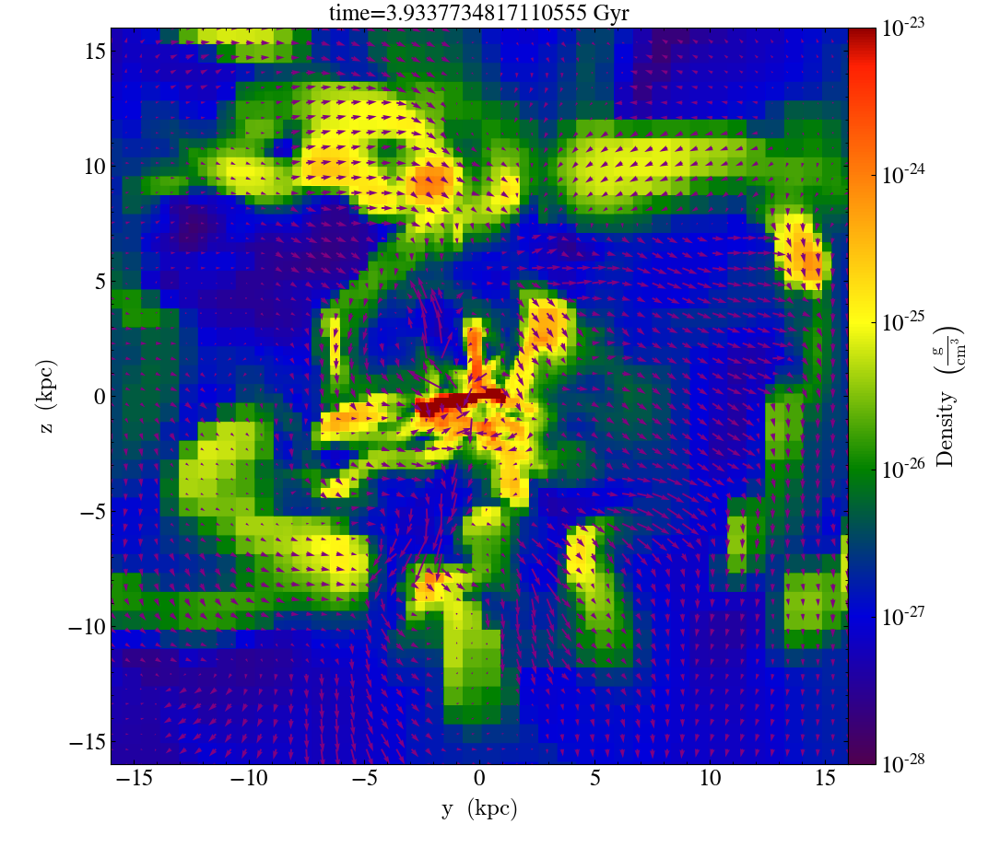

yt : [INFO     ] 2021-10-07 13:53:58,785 Parameters: current_time              = 183.81660281079
yt : [INFO     ] 2021-10-07 13:53:58,787 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:53:58,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:53:58,791 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:53:58,793 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:53:58,795 Parameters: current_redshift          = 1.6644572189472
yt : [INFO     ] 2021-10-07 13:53:58,796 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:53:58,798 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:53:58,800 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:53:58,802 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3405/3405 [00:00<00:00, 5175.51it/s]
yt : [INFO     ] 2021-10-0


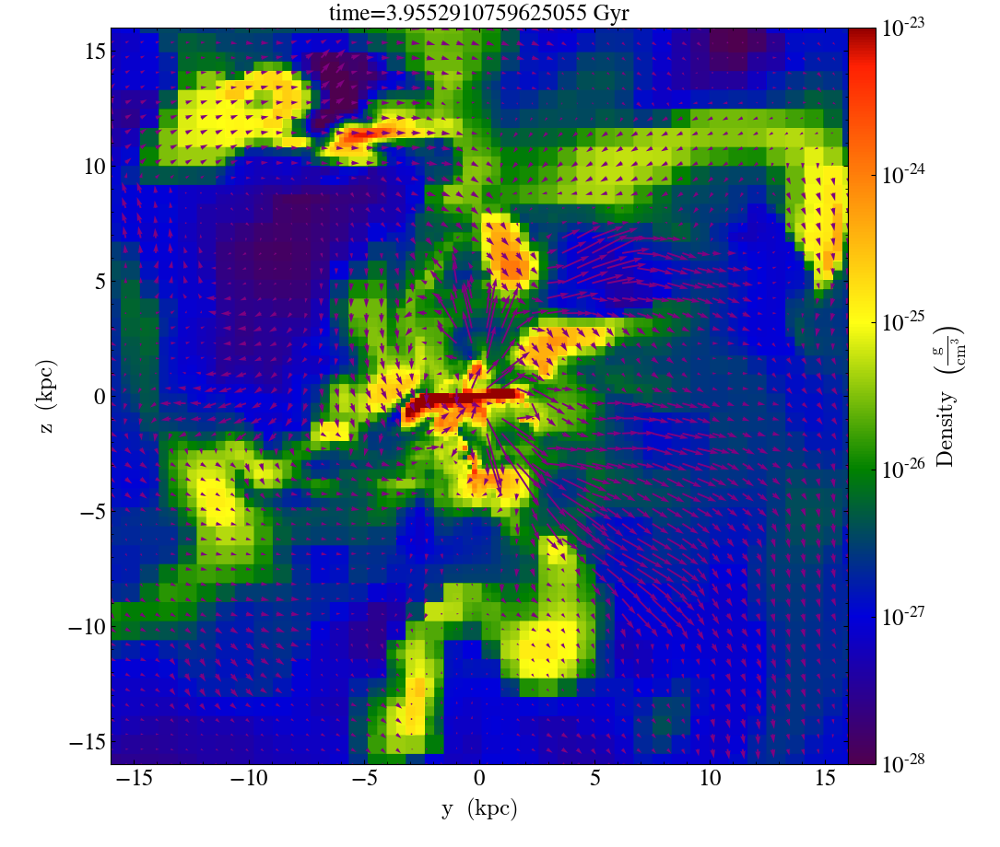

yt : [INFO     ] 2021-10-07 13:54:52,863 Parameters: current_time              = 184.81660281079
yt : [INFO     ] 2021-10-07 13:54:52,865 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:54:52,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:54:52,869 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:54:52,870 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:54:52,872 Parameters: current_redshift          = 1.654427959601
yt : [INFO     ] 2021-10-07 13:54:52,874 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:54:52,876 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:54:52,877 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:54:52,879 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3441/3441 [00:00<00:00, 4747.96it/s]
yt : [INFO     ] 2021-10-07


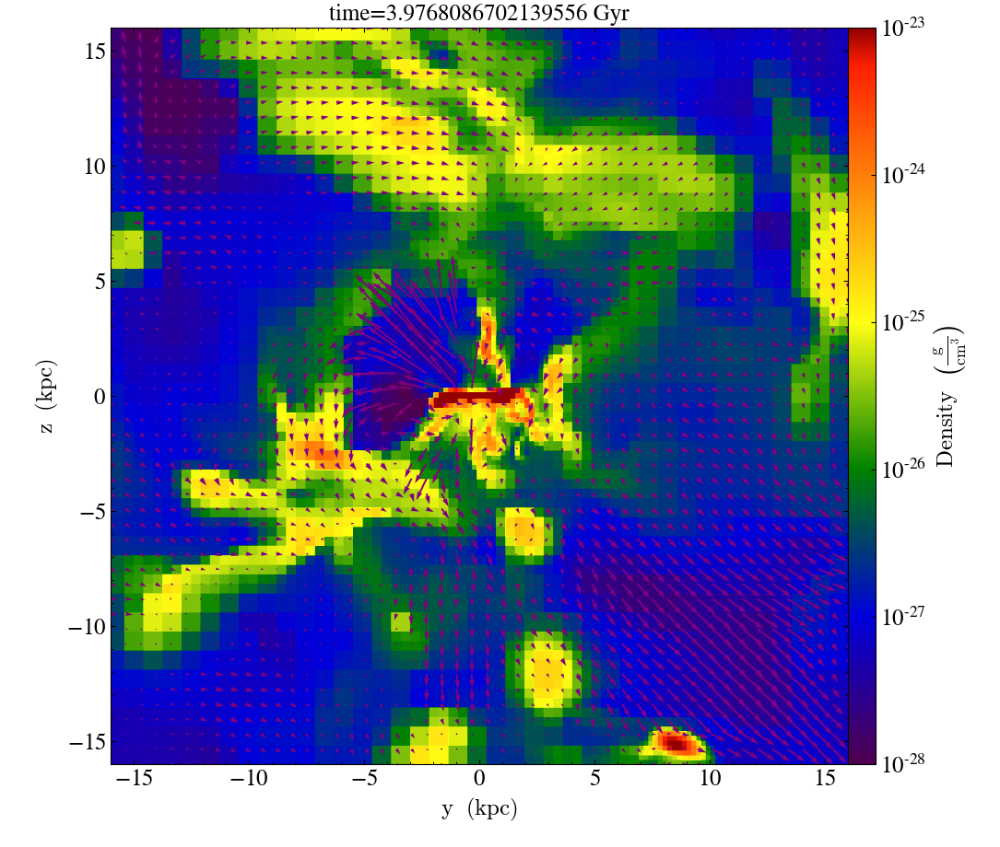

yt : [INFO     ] 2021-10-07 13:55:43,212 Parameters: current_time              = 185.81660281079
yt : [INFO     ] 2021-10-07 13:55:43,214 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:55:43,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:55:43,218 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:55:43,219 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:55:43,221 Parameters: current_redshift          = 1.6444902663921
yt : [INFO     ] 2021-10-07 13:55:43,223 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:55:43,225 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:55:43,226 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:55:43,228 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3412/3412 [00:00<00:00, 4651.66it/s]
yt : [INFO     ] 2021-10-0


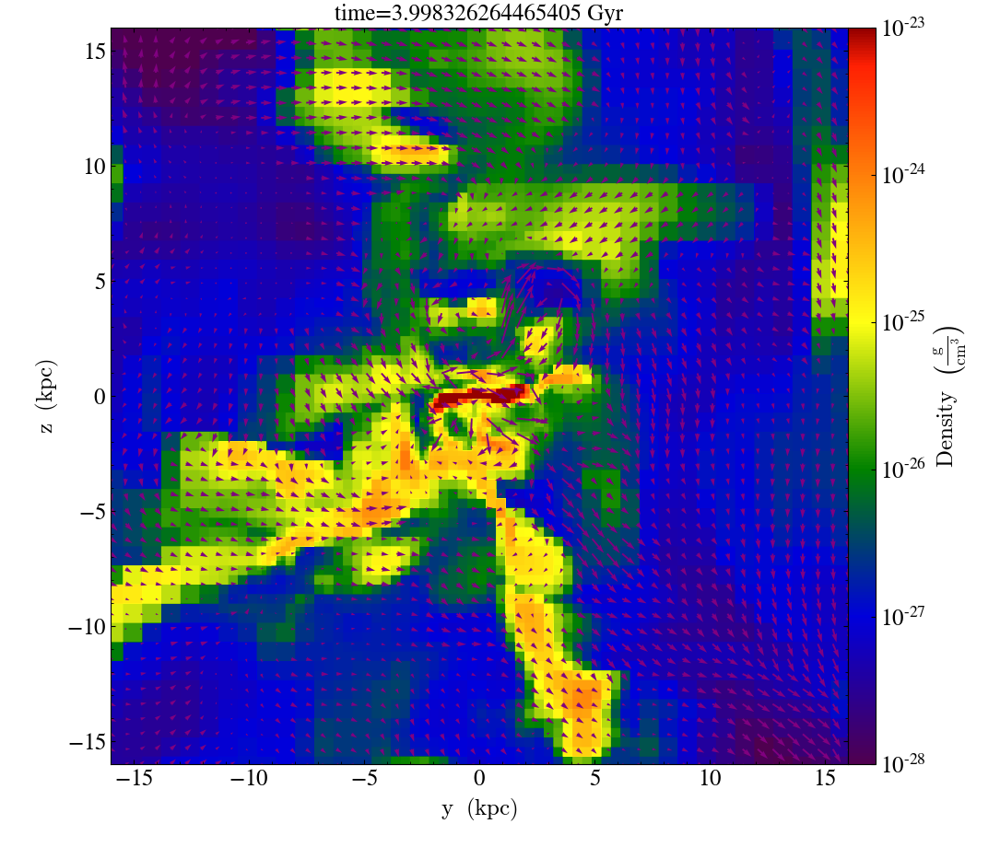

yt : [INFO     ] 2021-10-07 13:56:46,867 Parameters: current_time              = 186.81660281079
yt : [INFO     ] 2021-10-07 13:56:46,869 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:56:46,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:56:46,873 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:56:46,875 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:56:46,877 Parameters: current_redshift          = 1.6346428172681
yt : [INFO     ] 2021-10-07 13:56:46,879 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:56:46,880 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:56:46,882 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:56:46,884 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3404/3404 [00:00<00:00, 4763.68it/s]
yt : [INFO     ] 2021-10-0


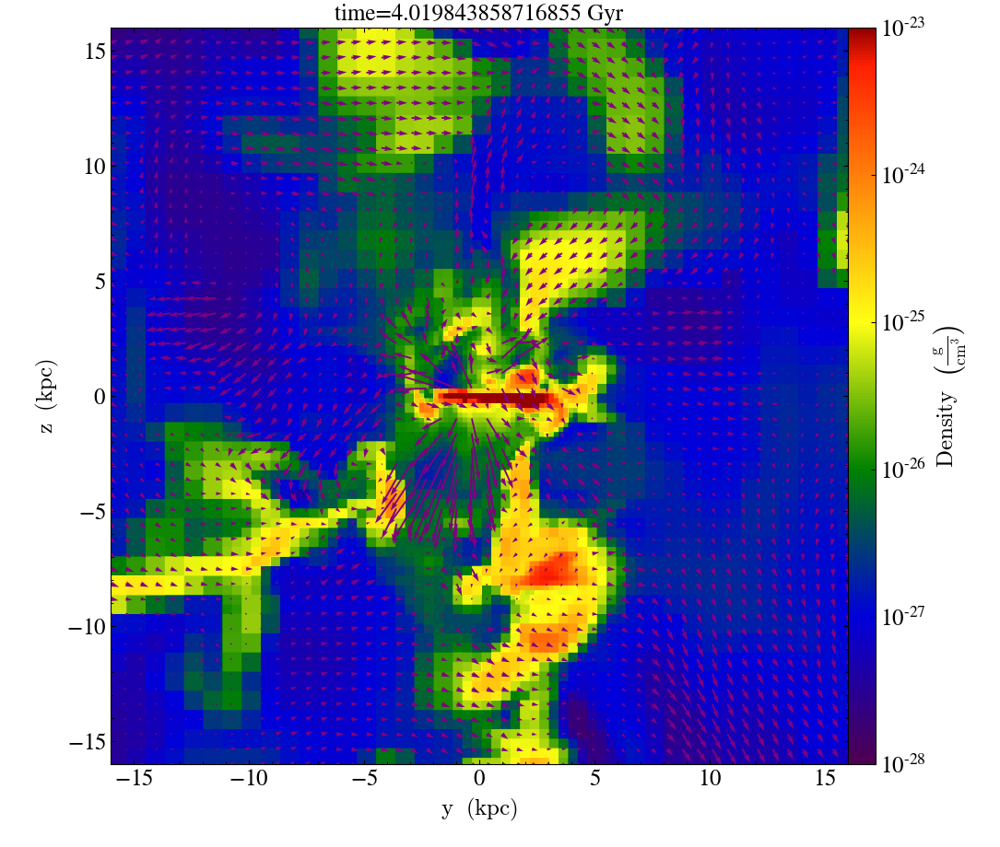

yt : [INFO     ] 2021-10-07 13:57:55,065 Parameters: current_time              = 187.81660281079
yt : [INFO     ] 2021-10-07 13:57:55,067 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:57:55,069 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:57:55,071 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:57:55,073 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:57:55,074 Parameters: current_redshift          = 1.6248712968
yt : [INFO     ] 2021-10-07 13:57:55,076 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:57:55,078 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:57:55,080 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:57:55,081 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3388/3388 [00:00<00:00, 4810.10it/s]
yt : [INFO     ] 2021-10-07 1


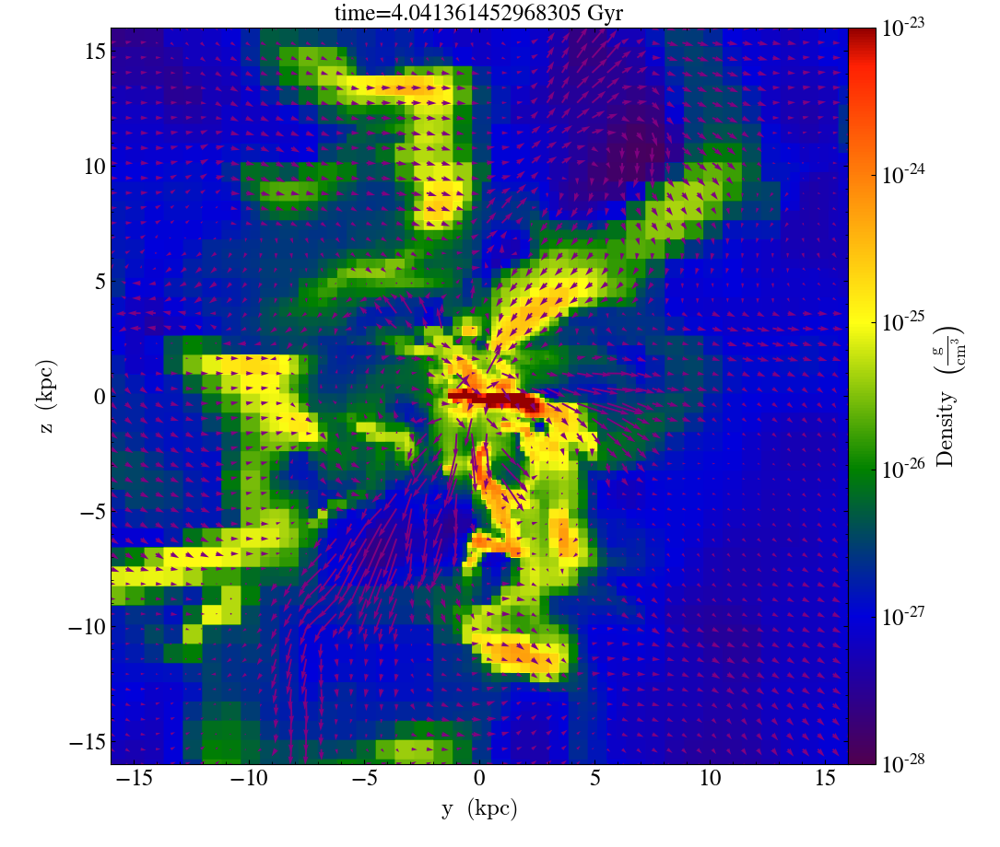

yt : [INFO     ] 2021-10-07 13:58:59,704 Parameters: current_time              = 188.81660281079
yt : [INFO     ] 2021-10-07 13:58:59,706 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:58:59,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:58:59,710 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:58:59,712 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:58:59,714 Parameters: current_redshift          = 1.6151846513964
yt : [INFO     ] 2021-10-07 13:58:59,715 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:58:59,717 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:58:59,719 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:58:59,721 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3455/3455 [00:00<00:00, 4908.97it/s]
yt : [INFO     ] 2021-10-0


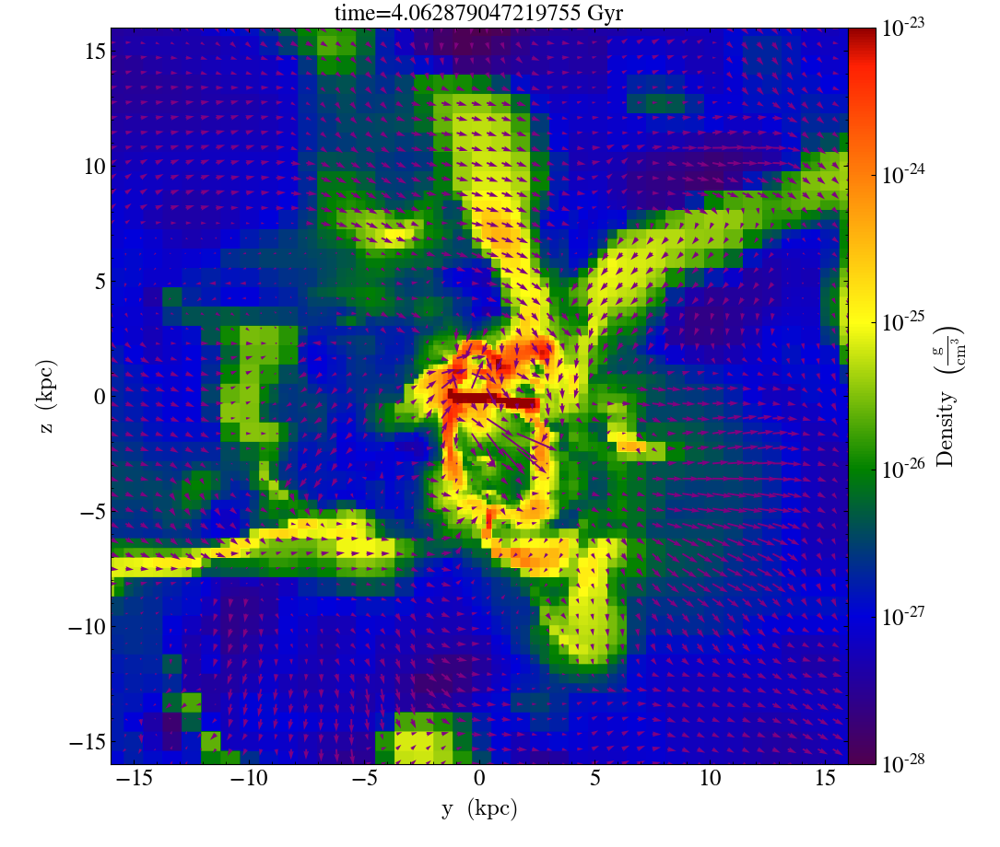

yt : [INFO     ] 2021-10-07 13:59:55,089 Parameters: current_time              = 189.81660281079
yt : [INFO     ] 2021-10-07 13:59:55,091 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 13:59:55,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 13:59:55,095 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 13:59:55,097 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 13:59:55,099 Parameters: current_redshift          = 1.6055846370423
yt : [INFO     ] 2021-10-07 13:59:55,100 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 13:59:55,102 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 13:59:55,104 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 13:59:55,105 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3492/3492 [00:00<00:00, 4926.81it/s]
yt : [INFO     ] 2021-10-0


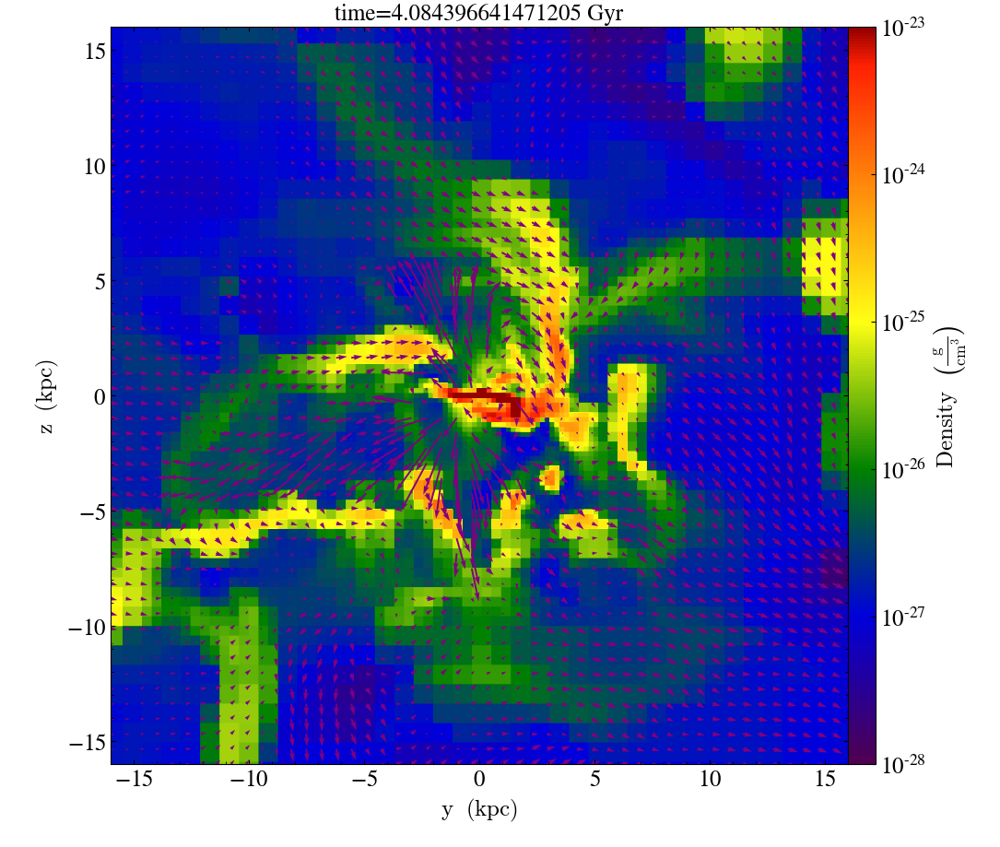

yt : [INFO     ] 2021-10-07 14:00:50,466 Parameters: current_time              = 190.81660281079
yt : [INFO     ] 2021-10-07 14:00:50,468 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-07 14:00:50,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-07 14:00:50,472 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-07 14:00:50,474 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-07 14:00:50,475 Parameters: current_redshift          = 1.5960690304391
yt : [INFO     ] 2021-10-07 14:00:50,477 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-07 14:00:50,479 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-07 14:00:50,480 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-07 14:00:50,482 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3494/3494 [00:00<00:00, 5271.06it/s]
yt : [INFO     ] 2021-10-0


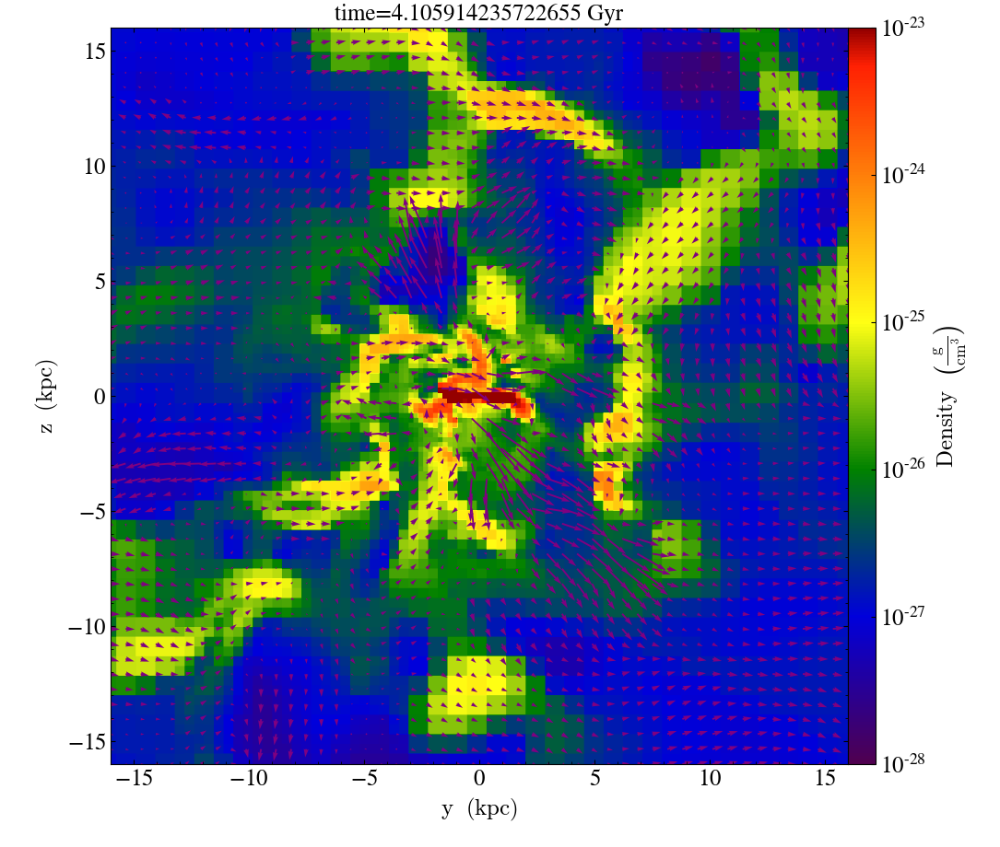

yt : [ERROR    ] 2021-10-07 14:01:44,112 None of the arguments provided to load() is a valid file
yt : [ERROR    ] 2021-10-07 14:01:44,114 Please check that you have used a correct path


YTOutputNotIdentified: Supplied ('/mnt/scratch/deovratd/Cosmological/eff_3-e3/DD0191/DD0191',) {}, but could not load!

In [1]:
import yt

for n in range(191,210):
    fn='%04d'%n
    fd='/DD'+str(fn)
    ff='/DD'+str(fn)
    fpath='/mnt/scratch/deovratd/Cosmological/eff_3-e3'+fd+ff
    data_ds = yt.load(fpath)
    time = data_ds.current_time.in_units('Gyr')
    ad = data_ds.all_data()
 
    slc = yt.SlicePlot(data_ds, "x", "density", center=("max","Dark_Matter_Density"), width=(32,'kpc'))

    colorbar = slc.set_cmap(field='density', cmap='bds_highcontrast')
    slc.set_zlim('density', 1.0e-28,1.0e-23)
    #slc.set_zlim('temperature', 1.0e4,1.0e8)
    slc.annotate_title("time="+str(time))
    slc.annotate_quiver('velocity_y', 'velocity_z', factor=16,
                      plot_args={"color": "purple"})
    slc.save("/mnt/scratch/deovratd/Cosmological/eff_3-e3/yz_"+str(fn))
    slc.show()

/mnt/home/deovratd/yt_cos_ap/lib/python3.7/site-packages/ipykernel_launcher.py:2: VisibleDeprecationWarning: Development of the HaloCatalog module has been moved to the yt_astro_analysis package. This version is deprecated and will be removed from yt in a future release. See https://github.com/yt-project/yt_astro_analysis for further information.
  
/mnt/home/deovratd/yt_cos_ap/lib/python3.7/site-packages/ipykernel_launcher.py:3: VisibleDeprecationWarning: Development of the halo_finding module has been moved to the yt_astro_analysis package. This version is deprecated and will be removed from yt in a future release. See https://github.com/yt-project/yt_astro_analysis for further information.
  This is separate from the ipykernel package so we can avoid doing imports until
yt : [INFO     ] 2021-10-18 10:24:33,362 Parameters: current_time              = 156.81660281079
yt : [INFO     ] 2021-10-18 10:24:33,365 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10


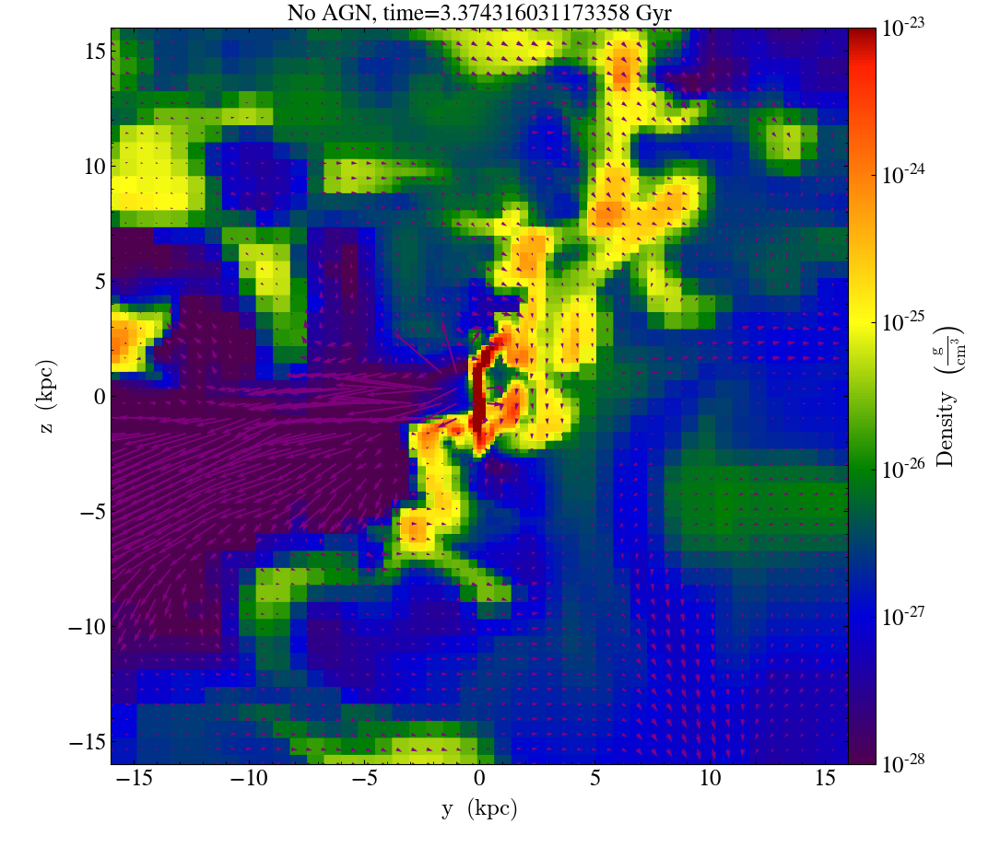

yt : [INFO     ] 2021-10-18 10:29:10,887 Parameters: current_time              = 157.81660281079
yt : [INFO     ] 2021-10-18 10:29:10,889 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:29:10,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:29:10,894 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:29:10,896 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:29:10,898 Parameters: current_redshift          = 1.9604945911687
yt : [INFO     ] 2021-10-18 10:29:10,900 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:29:10,902 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:29:10,903 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:29:10,905 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3373/3373 [00:00<00:00, 3722.93it/s]
yt : [INFO     ] 2021-10-1


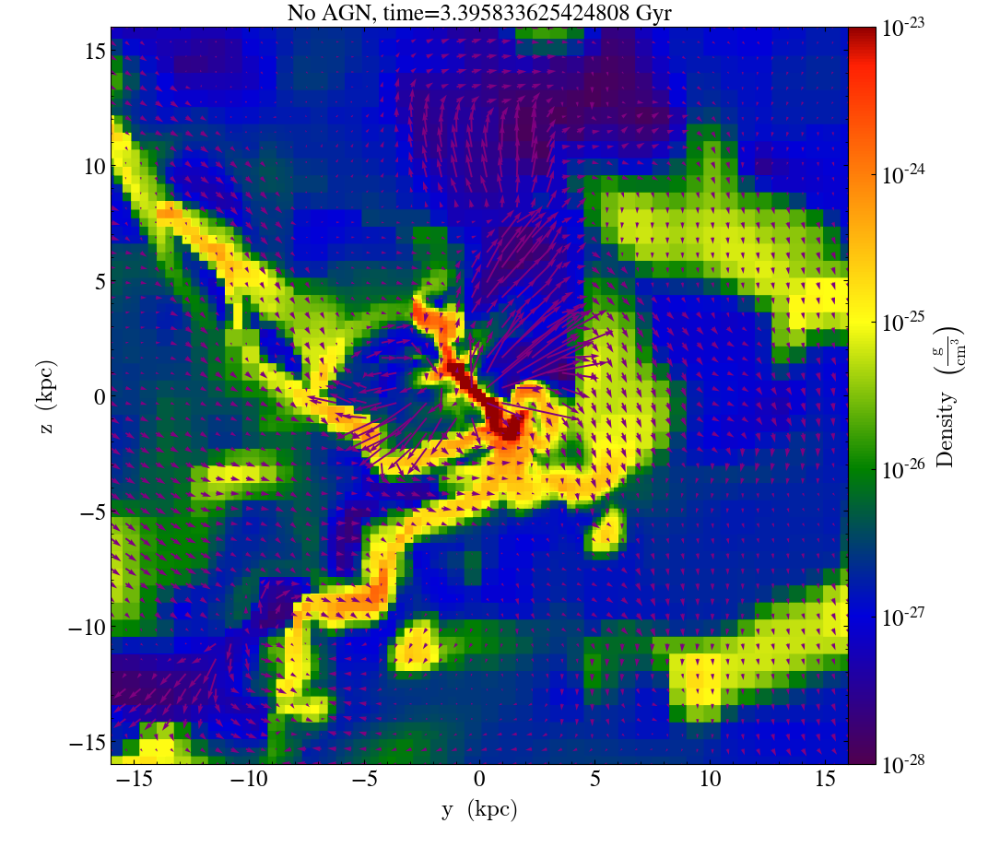

yt : [INFO     ] 2021-10-18 10:32:45,039 Parameters: current_time              = 158.81660281079
yt : [INFO     ] 2021-10-18 10:32:45,042 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:32:45,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:32:45,046 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:32:45,048 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:32:45,050 Parameters: current_redshift          = 1.9476690529888
yt : [INFO     ] 2021-10-18 10:32:45,052 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:32:45,054 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:32:45,056 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:32:45,058 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3369/3369 [00:00<00:00, 4885.06it/s]
yt : [INFO     ] 2021-10-1


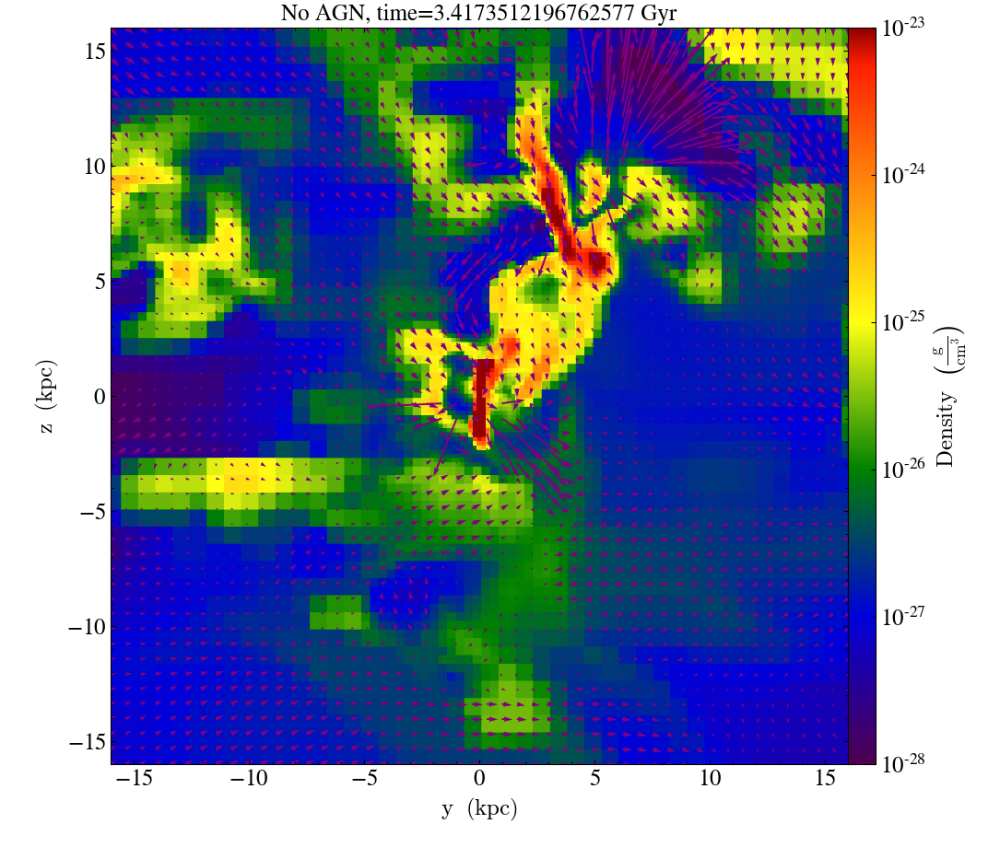

yt : [INFO     ] 2021-10-18 10:36:44,807 Parameters: current_time              = 159.81660281079
yt : [INFO     ] 2021-10-18 10:36:44,809 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:36:44,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:36:44,814 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:36:44,816 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:36:44,818 Parameters: current_redshift          = 1.9349719009497
yt : [INFO     ] 2021-10-18 10:36:44,820 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:36:44,821 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:36:44,823 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:36:44,825 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3459/3459 [00:00<00:00, 4650.17it/s]
yt : [INFO     ] 2021-10-1


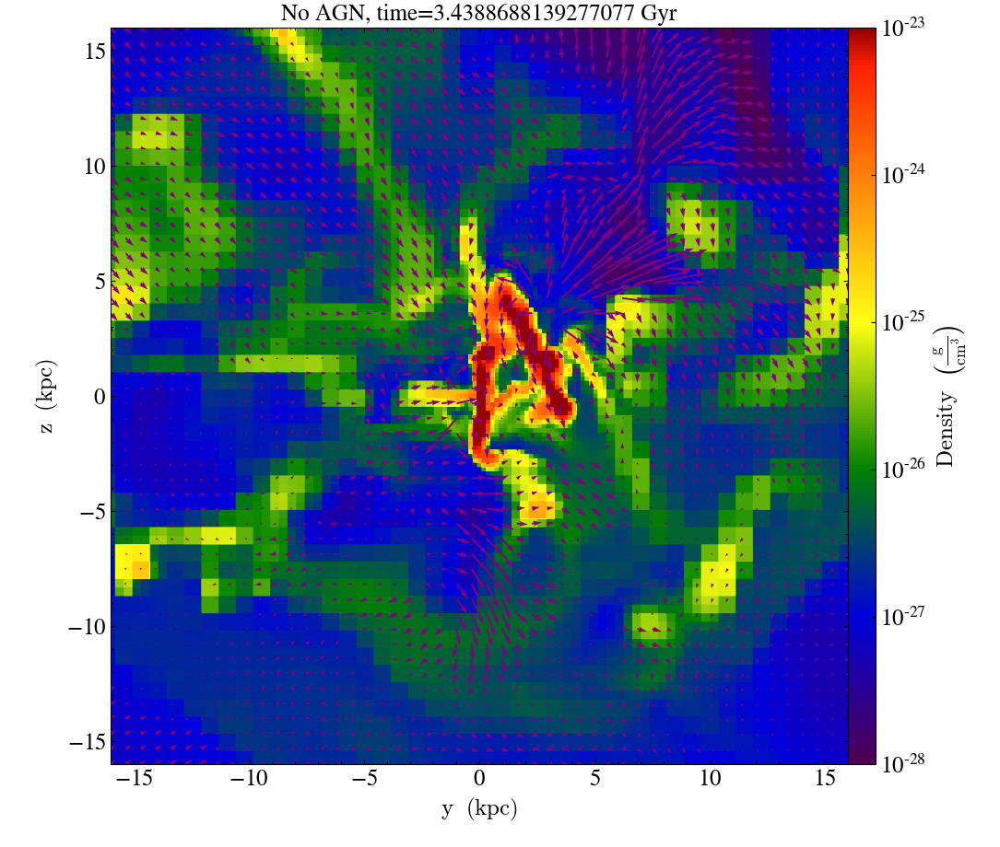

yt : [INFO     ] 2021-10-18 10:40:35,704 Parameters: current_time              = 160.81660281079
yt : [INFO     ] 2021-10-18 10:40:35,707 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:40:35,709 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:40:35,711 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:40:35,713 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:40:35,715 Parameters: current_redshift          = 1.9223998442962
yt : [INFO     ] 2021-10-18 10:40:35,717 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:40:35,719 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:40:35,721 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:40:35,723 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3354/3354 [00:00<00:00, 4166.86it/s]
yt : [INFO     ] 2021-10-1


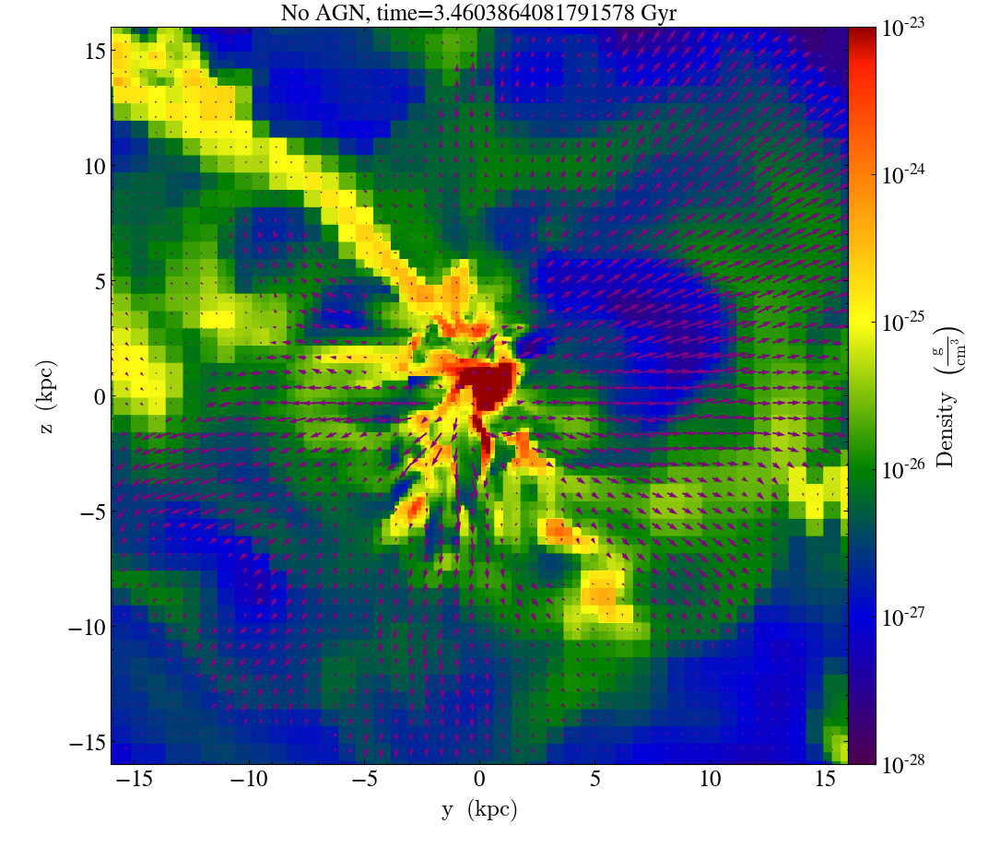

yt : [INFO     ] 2021-10-18 10:44:05,812 Parameters: current_time              = 161.81660281079
yt : [INFO     ] 2021-10-18 10:44:05,814 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:44:05,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:44:05,819 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:44:05,821 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:44:05,823 Parameters: current_redshift          = 1.9099590758029
yt : [INFO     ] 2021-10-18 10:44:05,825 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:44:05,827 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:44:05,829 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:44:05,831 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3381/3381 [00:00<00:00, 4190.86it/s]
yt : [INFO     ] 2021-10-1


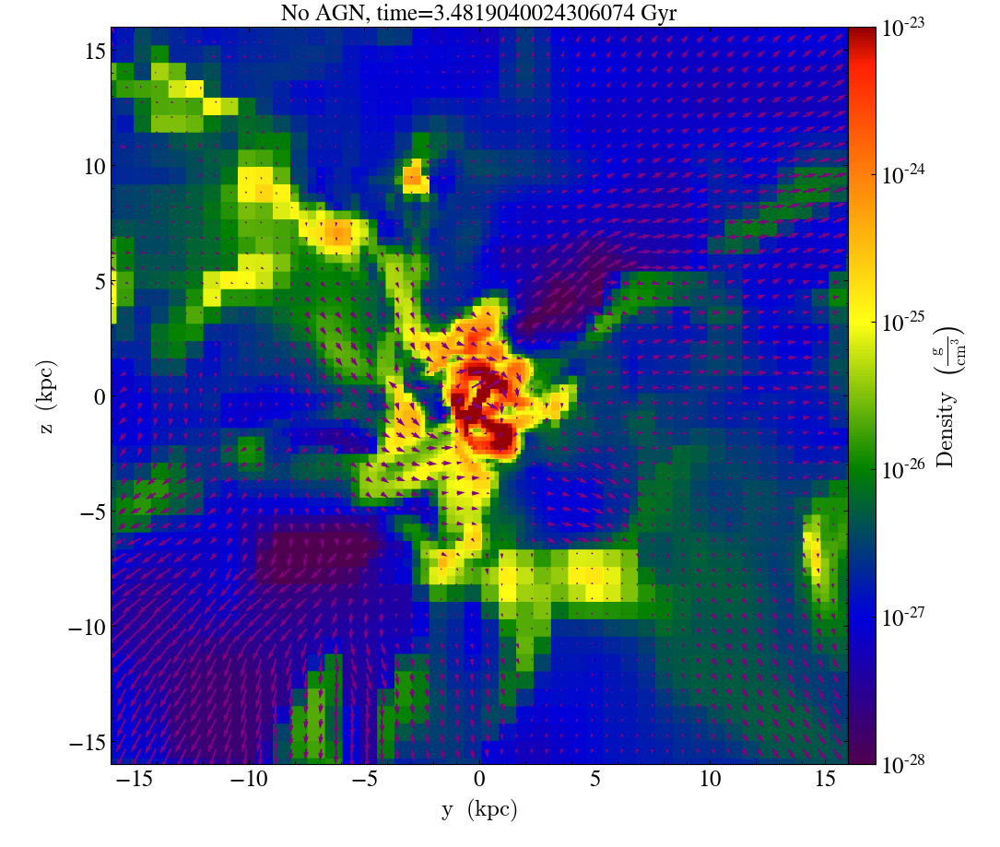

yt : [INFO     ] 2021-10-18 10:47:11,896 Parameters: current_time              = 162.81660281079
yt : [INFO     ] 2021-10-18 10:47:11,898 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:47:11,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:47:11,902 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:47:11,905 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:47:11,907 Parameters: current_redshift          = 1.8976438834237
yt : [INFO     ] 2021-10-18 10:47:11,909 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:47:11,910 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:47:11,912 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:47:11,914 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3337/3337 [00:00<00:00, 4171.90it/s]
yt : [INFO     ] 2021-10-1


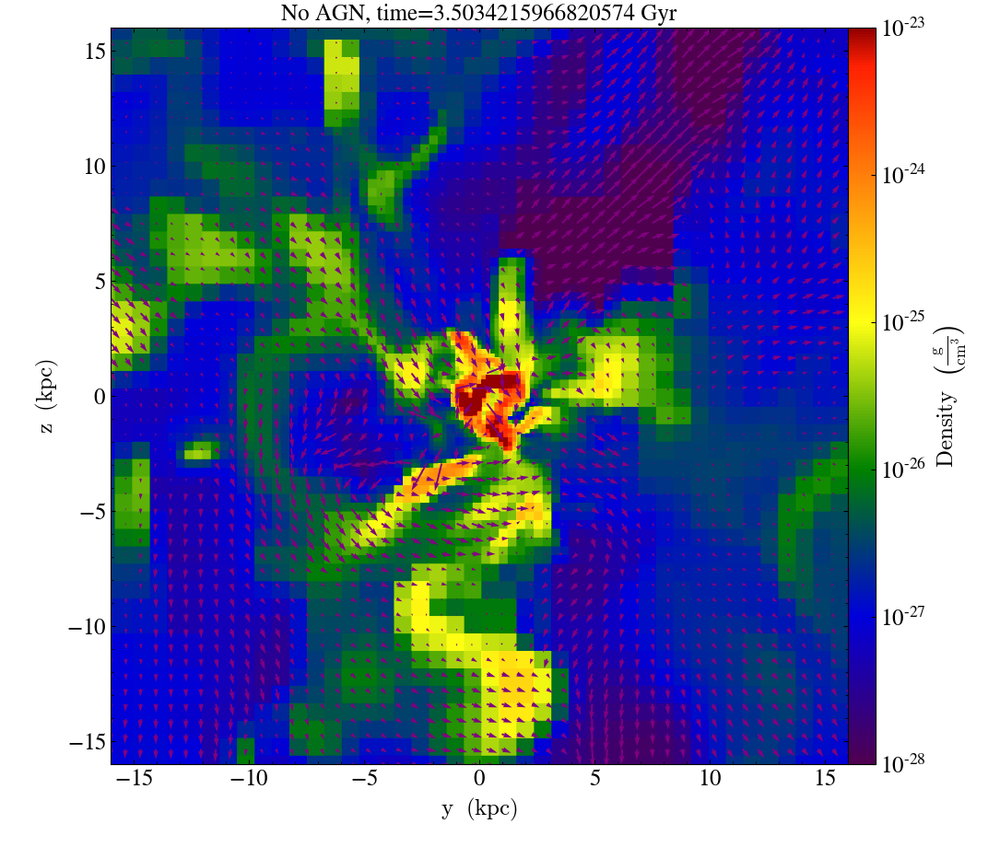

yt : [INFO     ] 2021-10-18 10:50:46,279 Parameters: current_time              = 163.81660281079
yt : [INFO     ] 2021-10-18 10:50:46,282 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-10-18 10:50:46,284 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-10-18 10:50:46,286 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-10-18 10:50:46,289 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-10-18 10:50:46,290 Parameters: current_redshift          = 1.8854437623787
yt : [INFO     ] 2021-10-18 10:50:46,292 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-10-18 10:50:46,294 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-10-18 10:50:46,296 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-10-18 10:50:46,298 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3413/3413 [00:00<00:00, 3650.52it/s]
yt : [INFO     ] 2021-10-1

KeyboardInterrupt: 

In [1]:
import yt
from yt.analysis_modules.halo_analysis.api import HaloCatalog
from yt.analysis_modules.halo_finding.api import HOPHaloFinder
from yt.data_objects.particle_filters import add_particle_filter
for n in range(156,172):
    fn='%04d'%n
    fd='/DD'+str(fn)
    ff='/DD'+str(fn)
    fpath = '/mnt/scratch/deovratd/stellar_st2_5'+fd+ff
    data_ds = yt.load(fpath)
    time = data_ds.current_time.in_units('Gyr')                
    ad = data_ds.all_data()
    d, c = data_ds.find_max("Dark_Matter_Density")
    slc = yt.SlicePlot(data_ds, "x", "density", center=("max","Dark_Matter_Density"), width=(32,'kpc'))
    colorbar = slc.set_cmap(field='density', cmap='bds_highcontrast')
    slc.set_zlim('density', 1.0e-28,1.0e-23)
    #slc.set_zlim('temperature', 1.0e4,1.0e8)
    slc.annotate_title("No AGN, time="+str(time))
    slc.annotate_quiver('velocity_y', 'velocity_z', factor=16,
                      plot_args={"color": "purple"})
    slc.save("/mnt/scratch/deovratd/stellar_st2_5/yz_"+str(fn))
    slc.show()

yt : [WARNING  ] 2021-11-02 09:23:42,011 The dark_matter particle filter already exists. Overriding.
yt : [INFO     ] 2021-11-02 09:23:42,063 Parameters: current_time              = 200.81660281079
yt : [INFO     ] 2021-11-02 09:23:42,064 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:23:42,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:23:42,067 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:23:42,068 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:23:42,069 Parameters: current_redshift          = 1.5050800795188
yt : [INFO     ] 2021-11-02 09:23:42,070 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:23:42,071 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:23:42,072 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:23:42,073 Parameters: hubble_constant           = 0.695


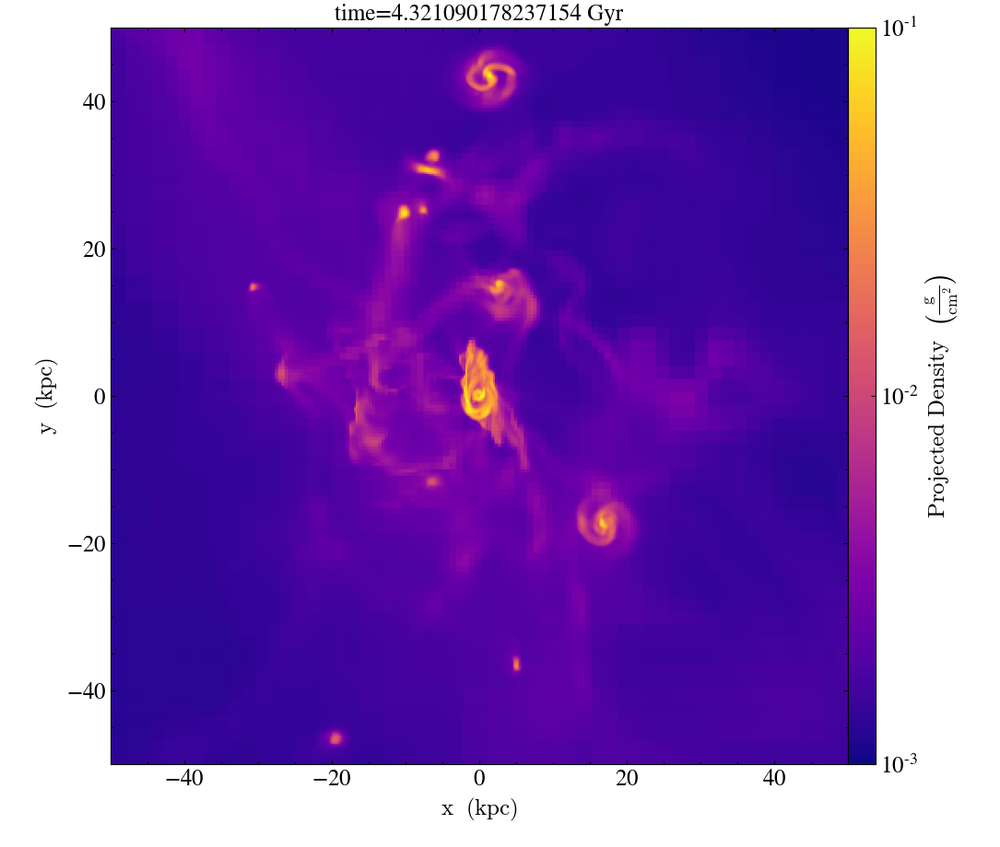

yt : [INFO     ] 2021-11-02 09:24:30,430 Parameters: current_time              = 201.81654447861
yt : [INFO     ] 2021-11-02 09:24:30,432 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:24:30,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:24:30,434 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:24:30,435 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:24:30,436 Parameters: current_redshift          = 1.4963861255454
yt : [INFO     ] 2021-11-02 09:24:30,437 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:24:30,438 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:24:30,440 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:24:30,441 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3453/3453 [00:00<00:00, 6600.23it/s]
yt : [INFO     ] 2021-11-0


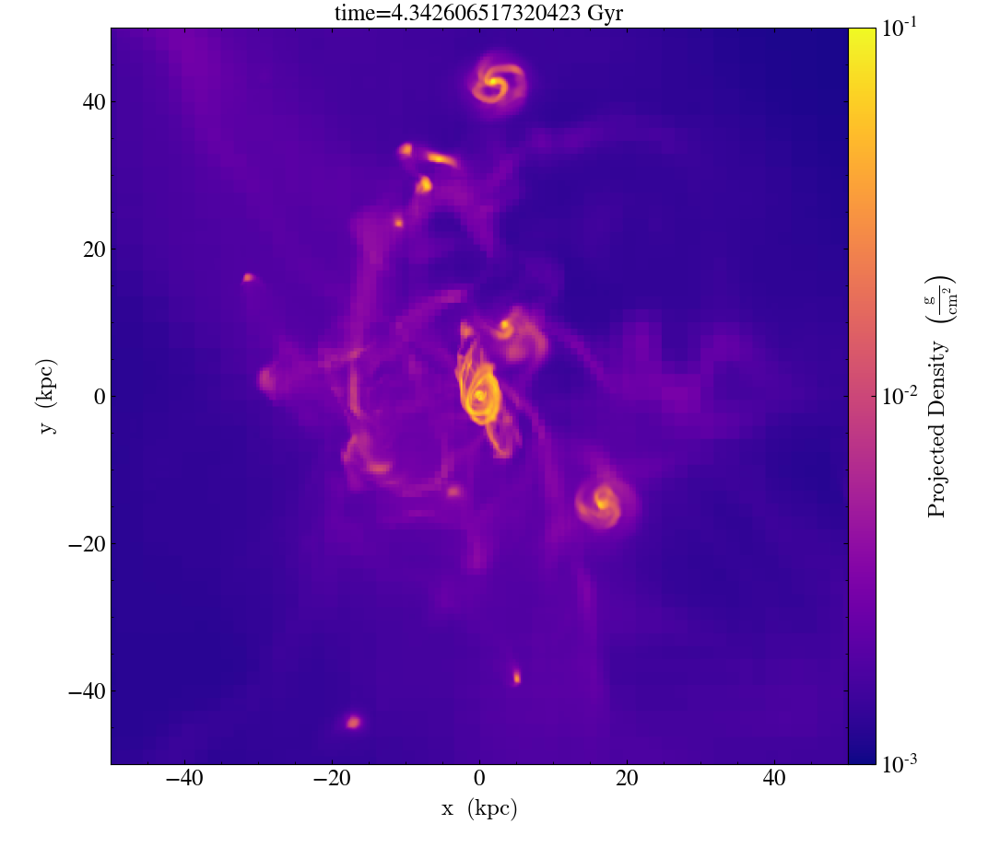

yt : [INFO     ] 2021-11-02 09:25:19,258 Parameters: current_time              = 202.81660281662
yt : [INFO     ] 2021-11-02 09:25:19,260 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:25:19,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:25:19,262 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:25:19,263 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:25:19,264 Parameters: current_redshift          = 1.4877577183151
yt : [INFO     ] 2021-11-02 09:25:19,265 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:25:19,266 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:25:19,267 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:25:19,269 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3438/3438 [00:00<00:00, 6469.26it/s] 
yt : [INFO     ] 2021-11-


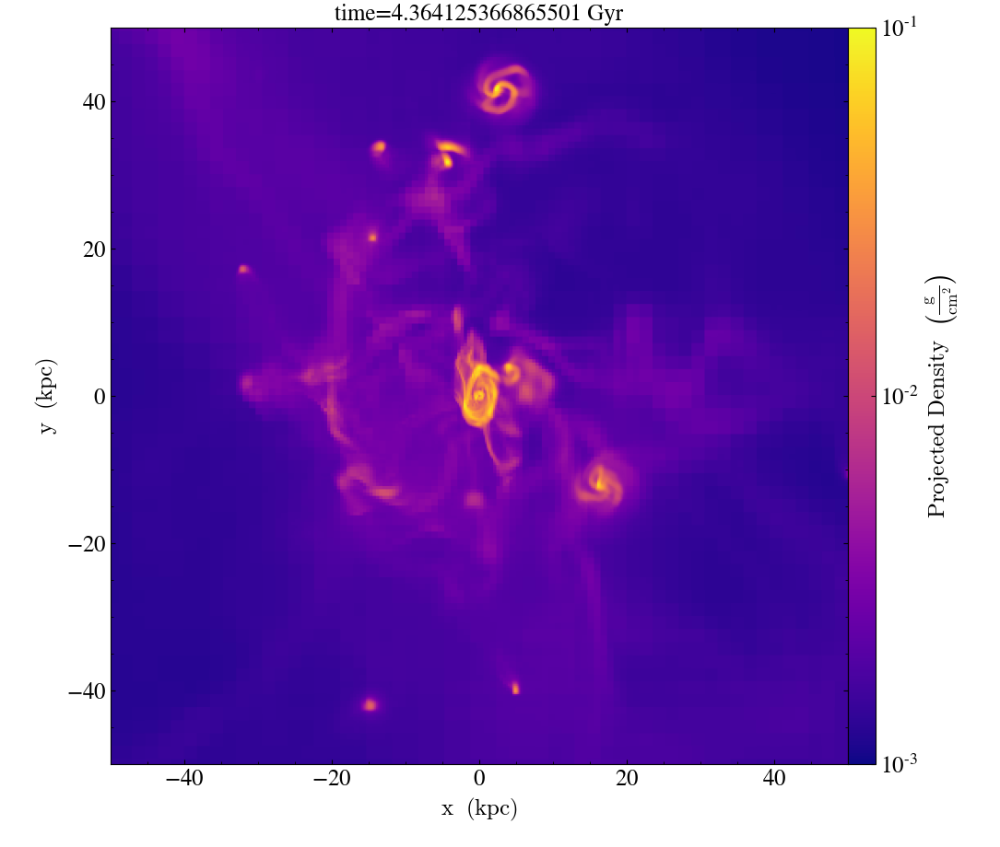

yt : [INFO     ] 2021-11-02 09:26:08,368 Parameters: current_time              = 203.81660281079
yt : [INFO     ] 2021-11-02 09:26:08,369 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:26:08,370 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:26:08,372 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:26:08,373 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:26:08,374 Parameters: current_redshift          = 1.4791920047803
yt : [INFO     ] 2021-11-02 09:26:08,375 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:26:08,376 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:26:08,377 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:26:08,378 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3503/3503 [00:00<00:00, 6473.58it/s] 
yt : [INFO     ] 2021-11-


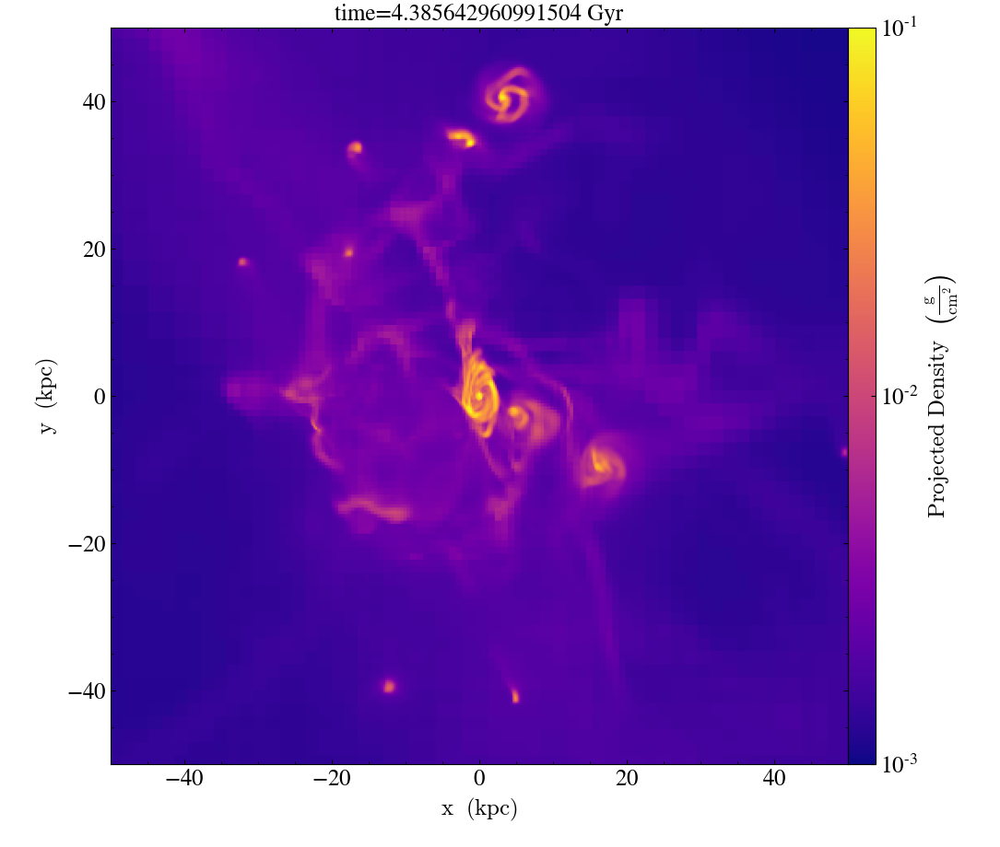

yt : [INFO     ] 2021-11-02 09:27:00,108 Parameters: current_time              = 204.81660281079
yt : [INFO     ] 2021-11-02 09:27:00,109 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:27:00,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:27:00,111 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:27:00,113 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:27:00,114 Parameters: current_redshift          = 1.4706974920876
yt : [INFO     ] 2021-11-02 09:27:00,115 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:27:00,116 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:27:00,117 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:27:00,118 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3550/3550 [00:00<00:00, 3746.27it/s]
yt : [INFO     ] 2021-11-0


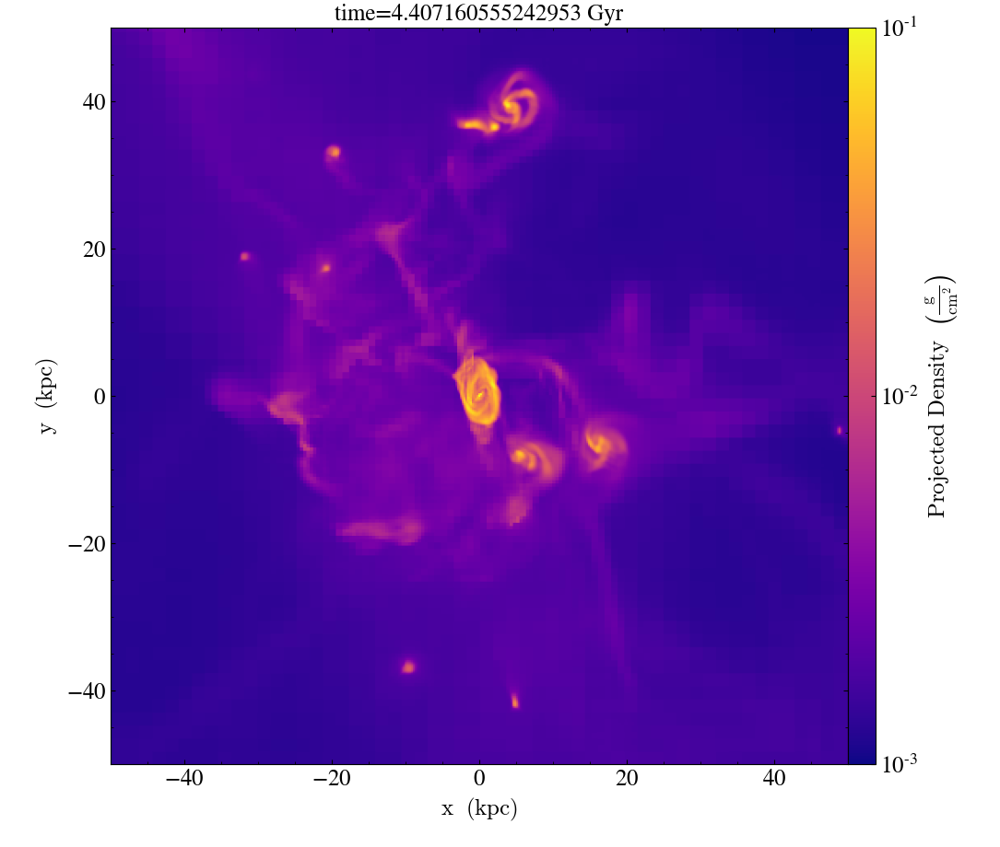

yt : [INFO     ] 2021-11-02 09:27:47,212 Parameters: current_time              = 205.81660281079
yt : [INFO     ] 2021-11-02 09:27:47,214 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:27:47,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:27:47,216 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:27:47,218 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:27:47,219 Parameters: current_redshift          = 1.4622732451252
yt : [INFO     ] 2021-11-02 09:27:47,220 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:27:47,221 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:27:47,222 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:27:47,223 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3496/3496 [00:00<00:00, 6617.12it/s]
yt : [INFO     ] 2021-11-0


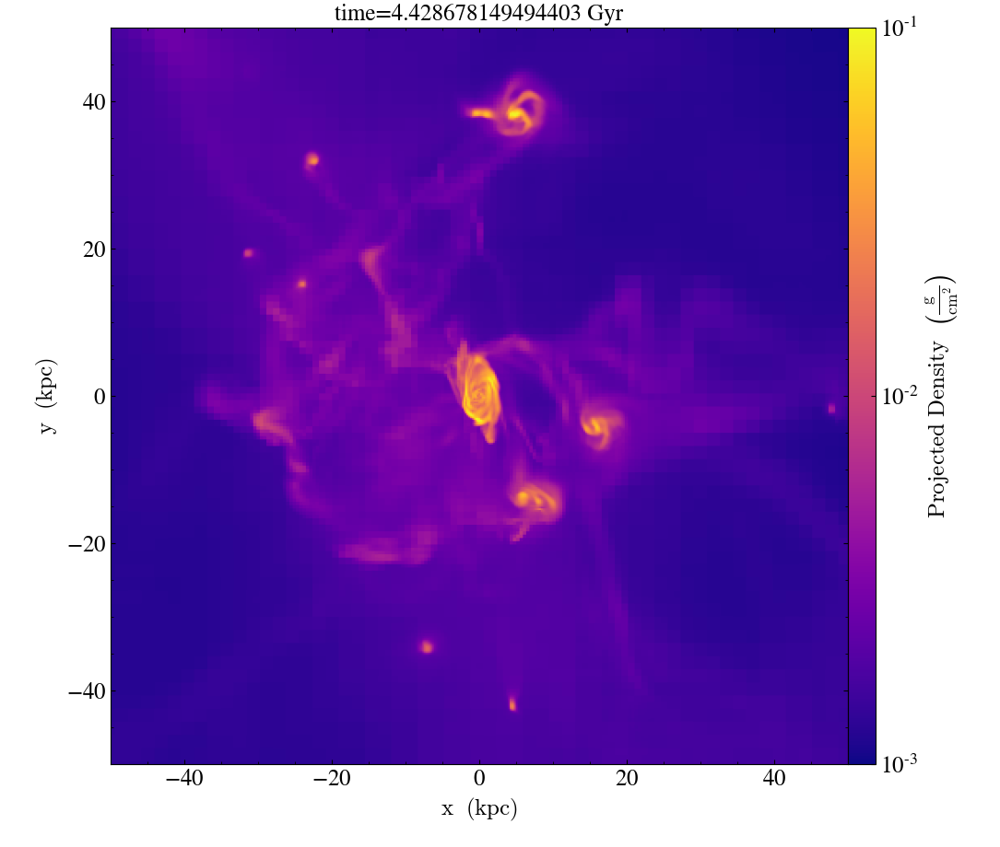

yt : [INFO     ] 2021-11-02 09:28:45,904 Parameters: current_time              = 206.81660281079
yt : [INFO     ] 2021-11-02 09:28:45,906 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:28:45,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:28:45,908 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:28:45,909 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:28:45,910 Parameters: current_redshift          = 1.4539124694549
yt : [INFO     ] 2021-11-02 09:28:45,911 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:28:45,912 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:28:45,914 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:28:45,915 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3546/3546 [00:00<00:00, 6483.76it/s]
yt : [INFO     ] 2021-11-0


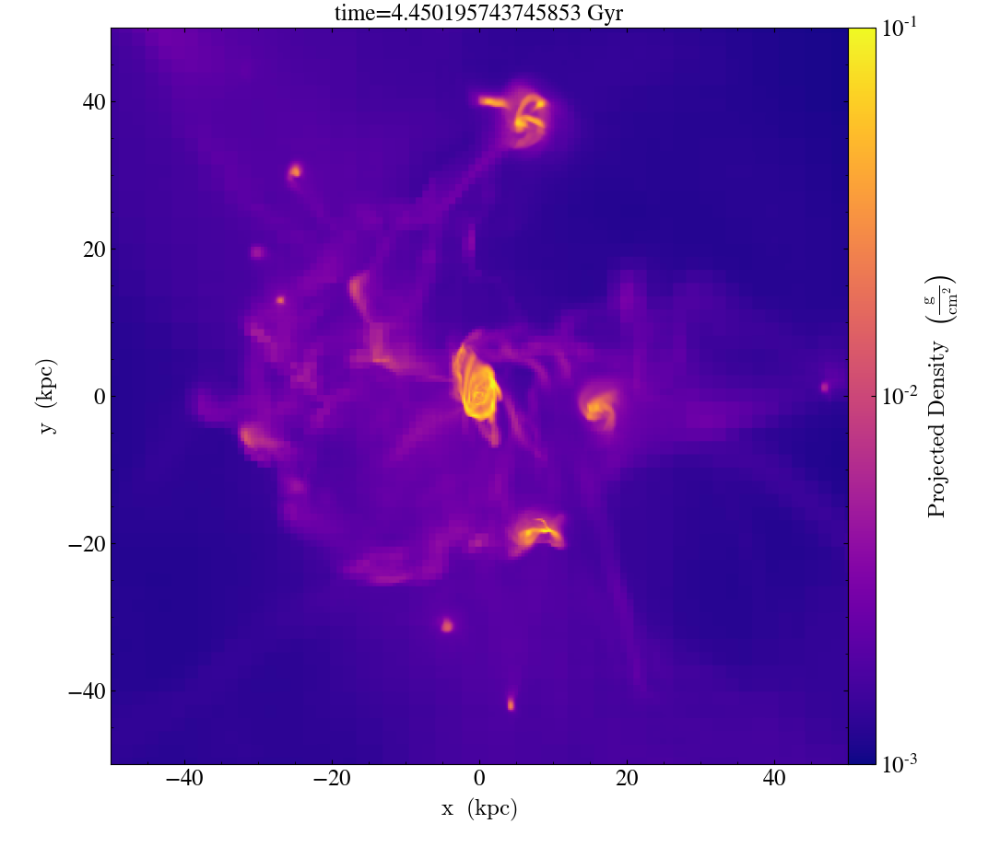

yt : [INFO     ] 2021-11-02 09:29:33,468 Parameters: current_time              = 207.81660281079
yt : [INFO     ] 2021-11-02 09:29:33,469 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:29:33,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:29:33,471 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:29:33,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:29:33,474 Parameters: current_redshift          = 1.4456098118854
yt : [INFO     ] 2021-11-02 09:29:33,475 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:29:33,476 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:29:33,477 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:29:33,478 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3534/3534 [00:00<00:00, 6506.30it/s] 
yt : [INFO     ] 2021-11-


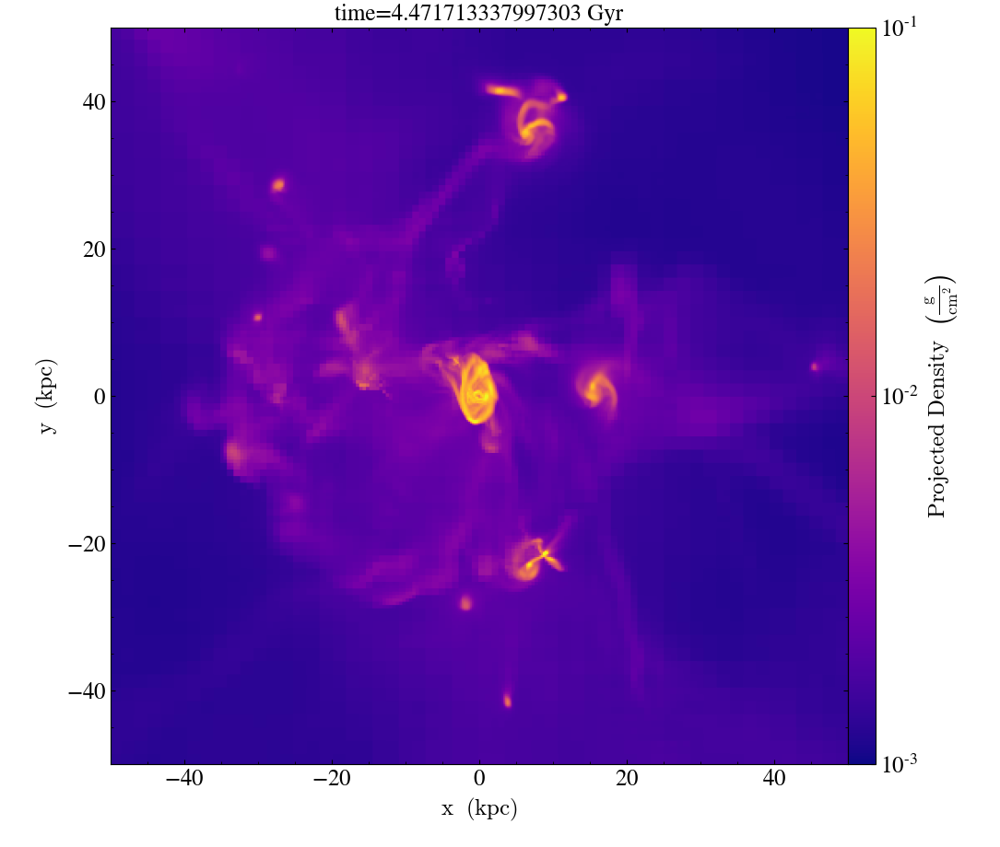

yt : [INFO     ] 2021-11-02 09:30:22,552 Parameters: current_time              = 208.81660281079
yt : [INFO     ] 2021-11-02 09:30:22,553 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:30:22,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:30:22,556 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:30:22,557 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:30:22,558 Parameters: current_redshift          = 1.4373749001417
yt : [INFO     ] 2021-11-02 09:30:22,559 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:30:22,560 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:30:22,562 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:30:22,563 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3534/3534 [00:00<00:00, 6293.77it/s] 
yt : [INFO     ] 2021-11-


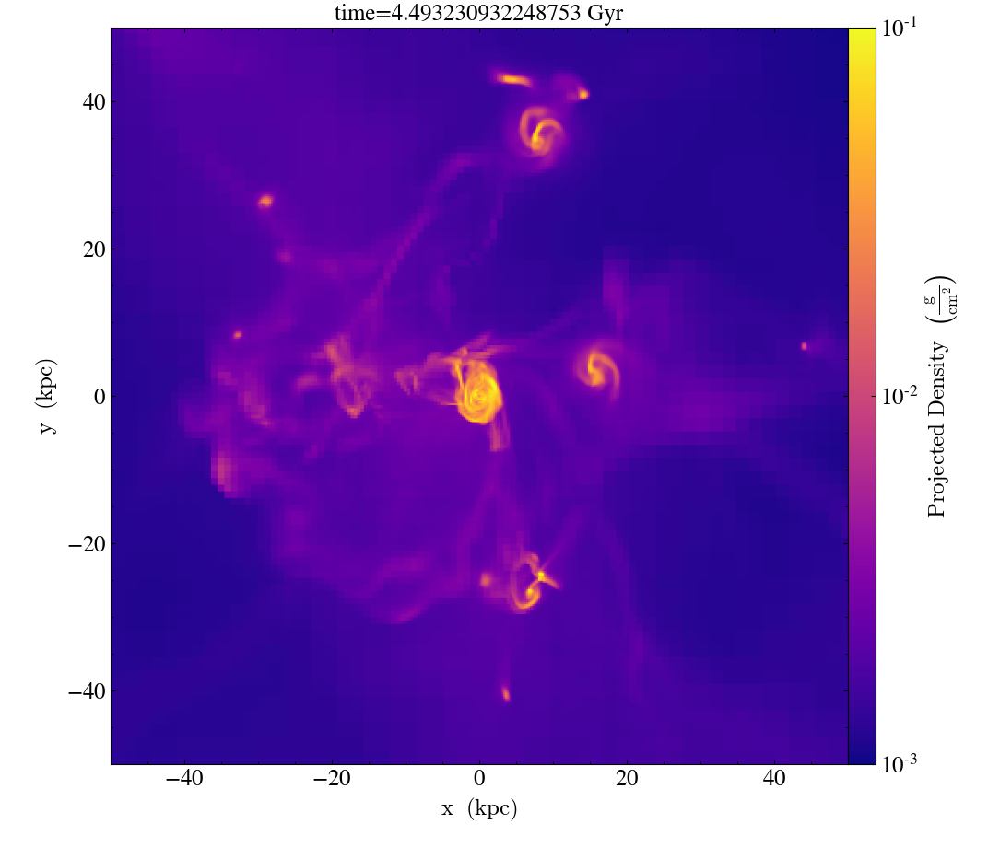

yt : [INFO     ] 2021-11-02 09:31:03,065 Parameters: current_time              = 209.81660281079
yt : [INFO     ] 2021-11-02 09:31:03,067 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:31:03,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:31:03,069 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:31:03,070 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:31:03,072 Parameters: current_redshift          = 1.4292068609748
yt : [INFO     ] 2021-11-02 09:31:03,073 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:31:03,074 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:31:03,075 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:31:03,076 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3562/3562 [00:00<00:00, 5246.71it/s]
yt : [INFO     ] 2021-11-0


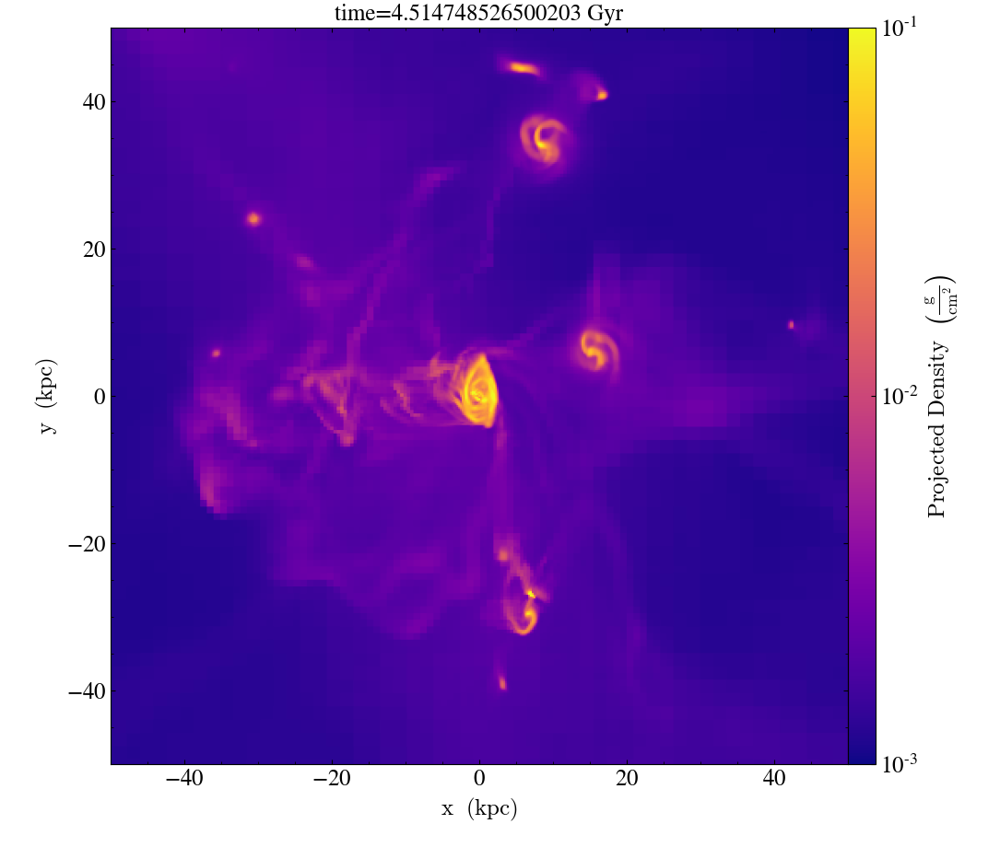

yt : [INFO     ] 2021-11-02 09:31:54,362 Parameters: current_time              = 210.81660281079
yt : [INFO     ] 2021-11-02 09:31:54,363 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:31:54,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:31:54,365 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:31:54,367 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:31:54,368 Parameters: current_redshift          = 1.4211006401392
yt : [INFO     ] 2021-11-02 09:31:54,369 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:31:54,370 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:31:54,371 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:31:54,372 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3542/3542 [00:00<00:00, 6654.71it/s]
yt : [INFO     ] 2021-11-0


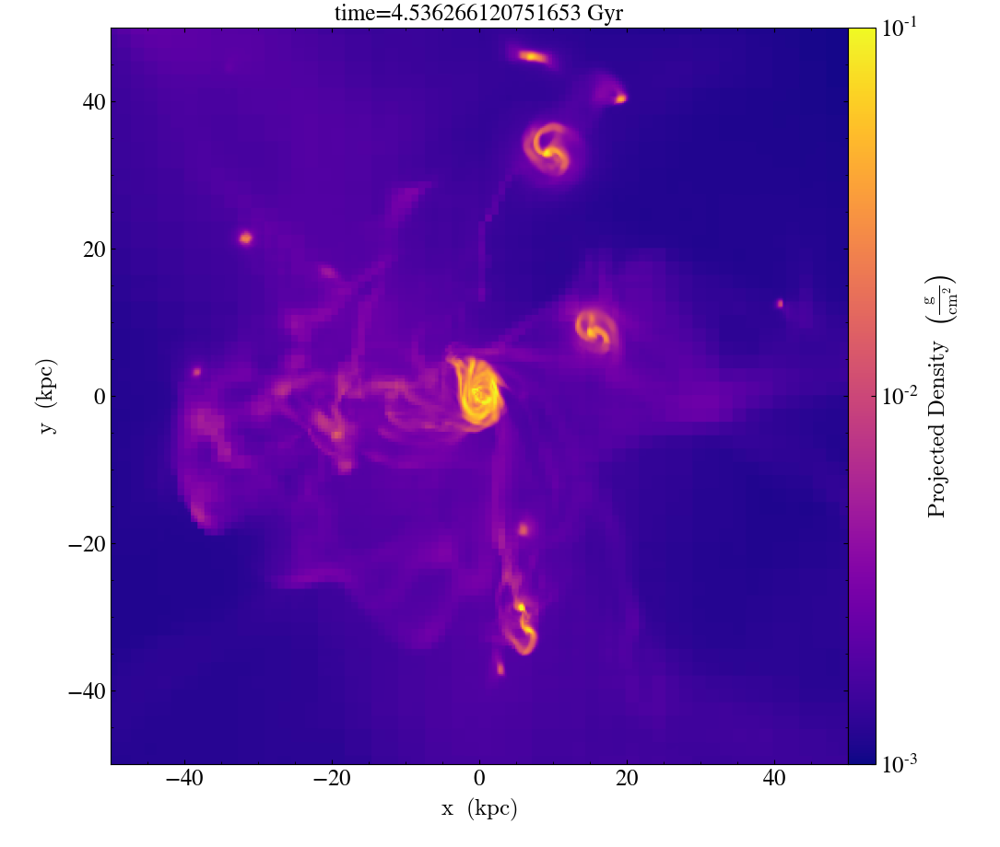

yt : [INFO     ] 2021-11-02 09:32:37,616 Parameters: current_time              = 211.81660281079
yt : [INFO     ] 2021-11-02 09:32:37,617 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:32:37,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:32:37,619 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:32:37,621 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:32:37,622 Parameters: current_redshift          = 1.4130475130198
yt : [INFO     ] 2021-11-02 09:32:37,623 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:32:37,624 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:32:37,625 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:32:37,626 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3533/3533 [00:00<00:00, 6295.66it/s] 
yt : [INFO     ] 2021-11-


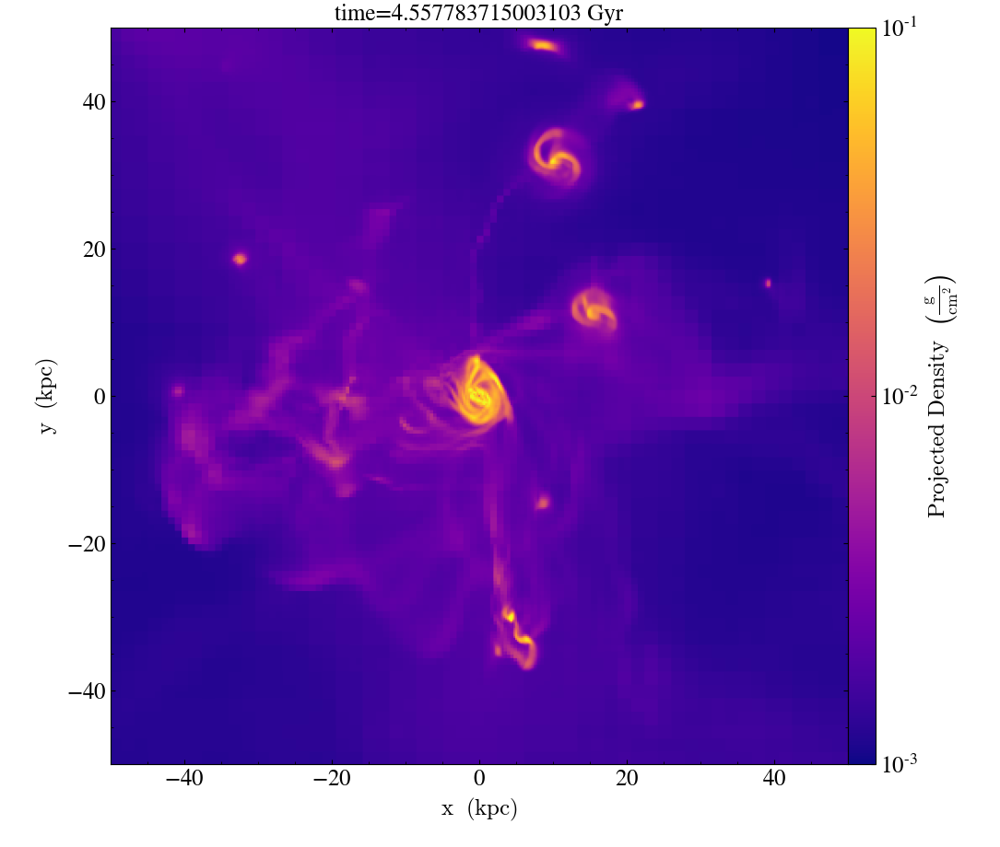

yt : [INFO     ] 2021-11-02 09:33:38,578 Parameters: current_time              = 212.81660281079
yt : [INFO     ] 2021-11-02 09:33:38,579 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:33:38,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:33:38,581 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:33:38,583 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:33:38,584 Parameters: current_redshift          = 1.405058913554
yt : [INFO     ] 2021-11-02 09:33:38,585 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:33:38,586 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:33:38,587 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:33:38,588 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3501/3501 [00:00<00:00, 6335.10it/s] 
yt : [INFO     ] 2021-11-0


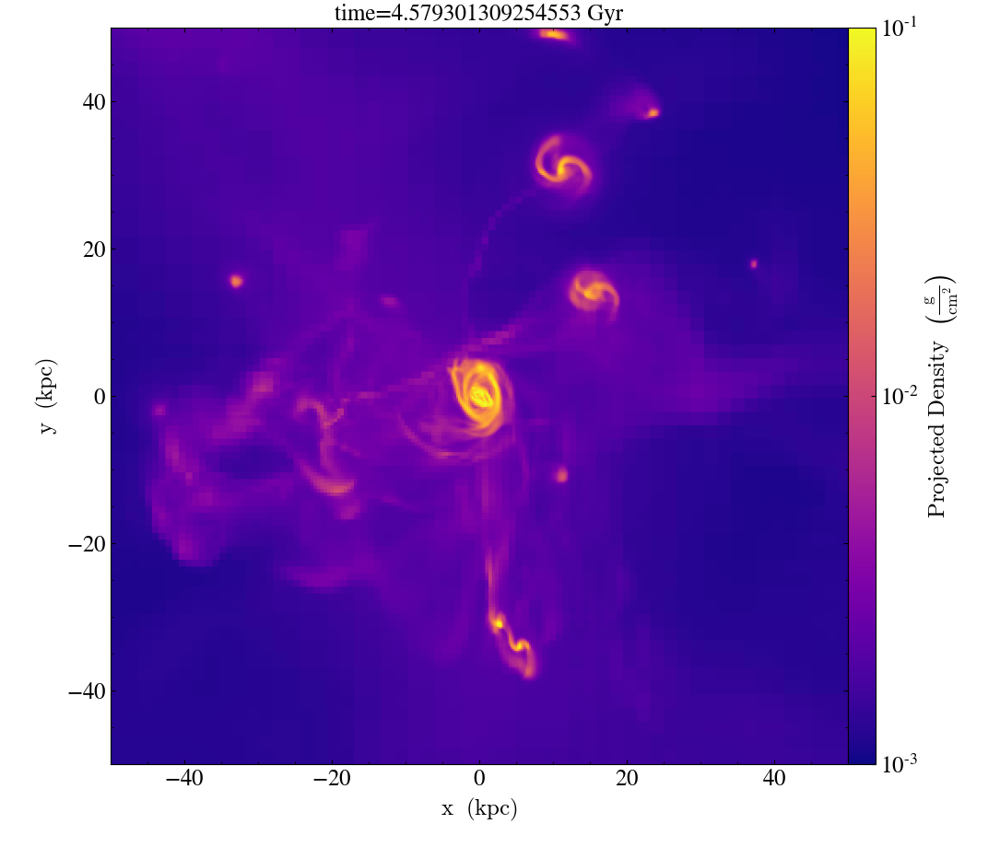

yt : [INFO     ] 2021-11-02 09:34:26,006 Parameters: current_time              = 213.8165390609
yt : [INFO     ] 2021-11-02 09:34:26,008 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:34:26,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:34:26,010 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:34:26,011 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:34:26,012 Parameters: current_redshift          = 1.3971345283155
yt : [INFO     ] 2021-11-02 09:34:26,014 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:34:26,015 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:34:26,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:34:26,017 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3560/3560 [00:00<00:00, 5077.96it/s]
yt : [INFO     ] 2021-11-02


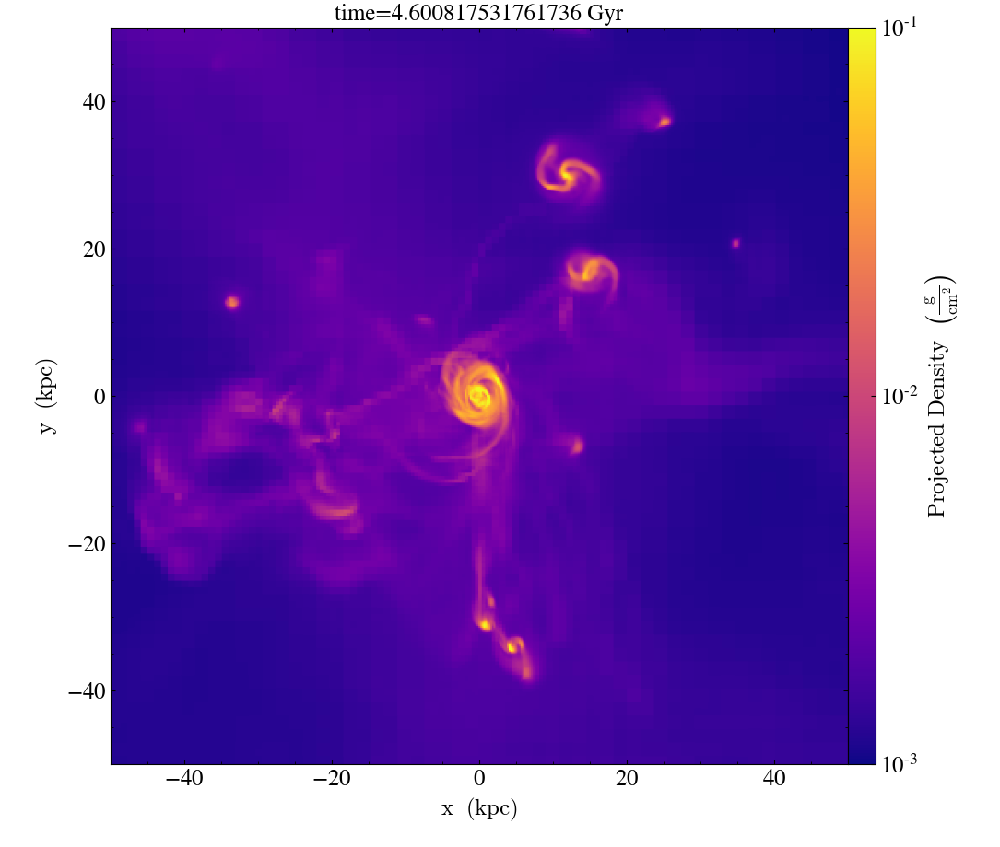

yt : [INFO     ] 2021-11-02 09:35:16,494 Parameters: current_time              = 214.81660281717
yt : [INFO     ] 2021-11-02 09:35:16,496 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:35:16,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:35:16,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:35:16,499 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:35:16,500 Parameters: current_redshift          = 1.3892707415984
yt : [INFO     ] 2021-11-02 09:35:16,502 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:35:16,503 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:35:16,504 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:35:16,505 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3550/3550 [00:00<00:00, 6266.28it/s]
yt : [INFO     ] 2021-11-0


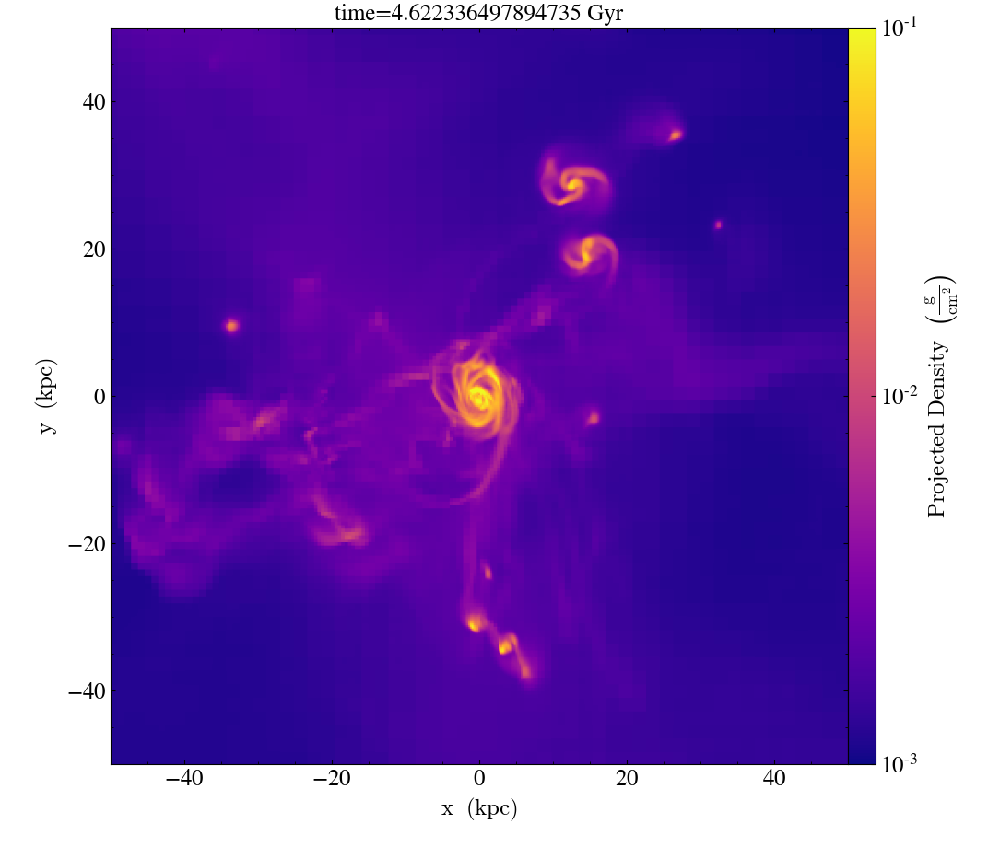

yt : [INFO     ] 2021-11-02 09:36:02,150 Parameters: current_time              = 215.81660281079
yt : [INFO     ] 2021-11-02 09:36:02,152 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:36:02,153 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:36:02,154 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:36:02,155 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:36:02,156 Parameters: current_redshift          = 1.3814545252199
yt : [INFO     ] 2021-11-02 09:36:02,158 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:36:02,159 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:36:02,160 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:36:02,161 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3607/3607 [00:00<00:00, 6339.32it/s] 
yt : [INFO     ] 2021-11-


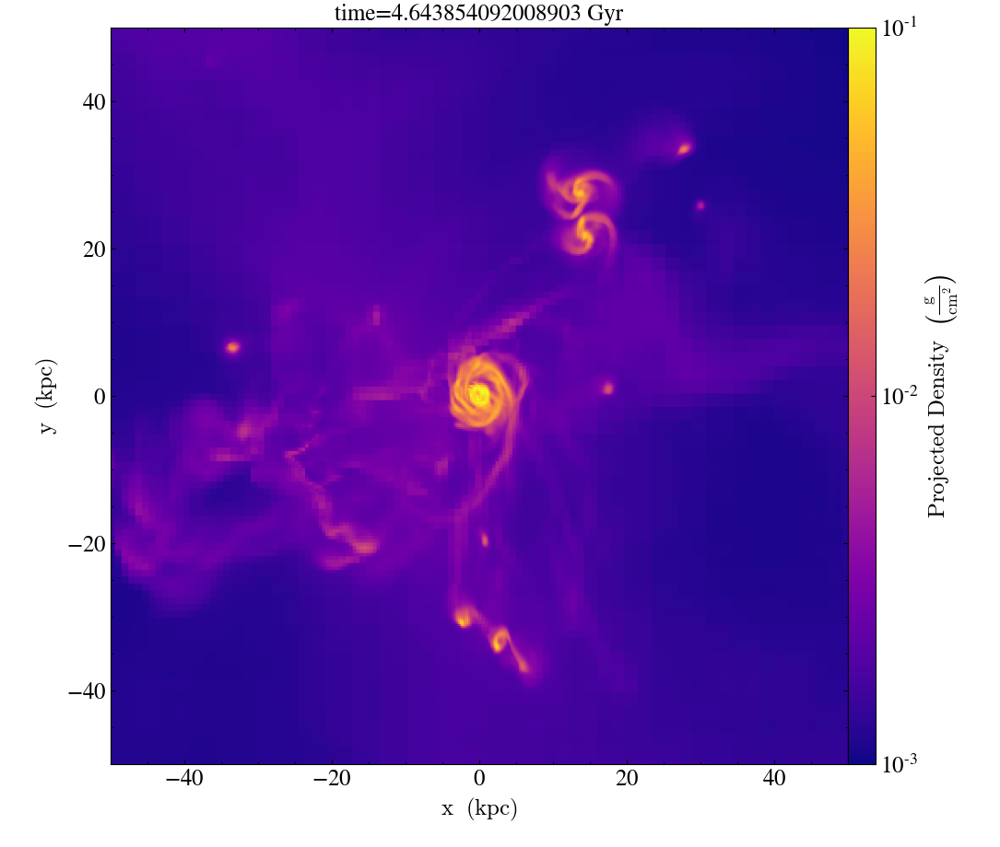

yt : [INFO     ] 2021-11-02 09:37:00,558 Parameters: current_time              = 216.81660281079
yt : [INFO     ] 2021-11-02 09:37:00,560 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:37:00,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:37:00,562 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:37:00,563 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:37:00,565 Parameters: current_redshift          = 1.3736998350644
yt : [INFO     ] 2021-11-02 09:37:00,566 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:37:00,567 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:37:00,568 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:37:00,569 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3580/3580 [00:00<00:00, 5936.82it/s] 
yt : [INFO     ] 2021-11-


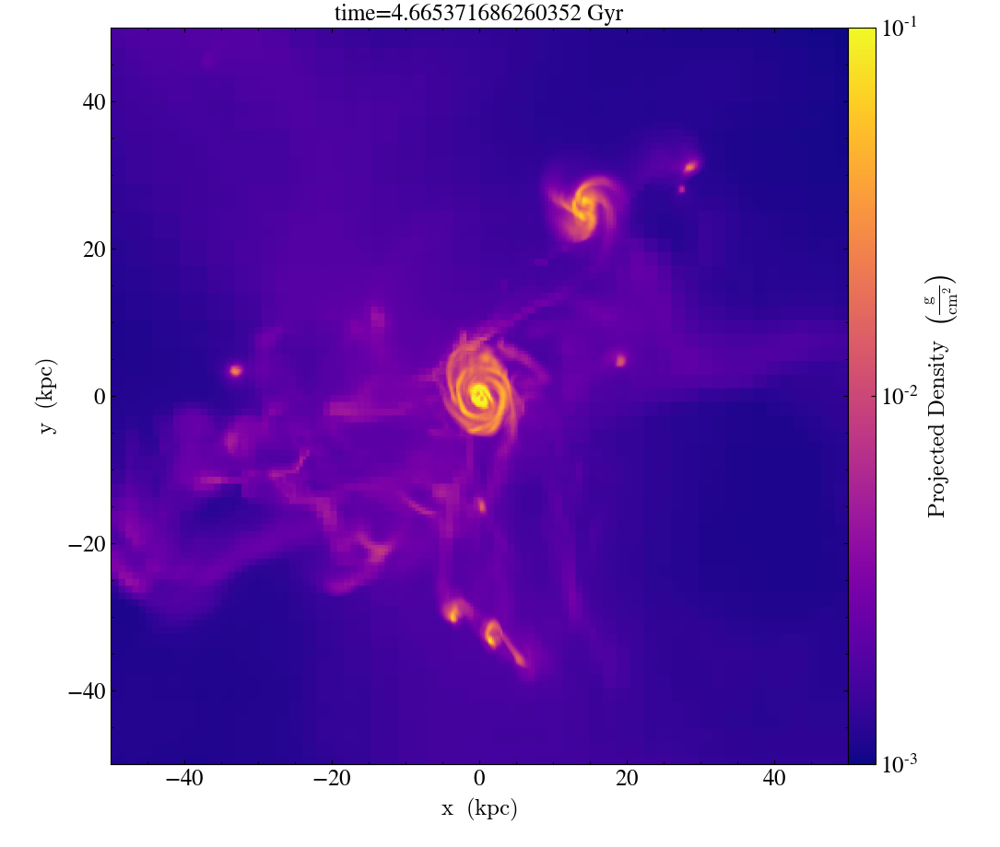

yt : [INFO     ] 2021-11-02 09:37:49,164 Parameters: current_time              = 217.81660281079
yt : [INFO     ] 2021-11-02 09:37:49,165 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:37:49,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:37:49,167 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:37:49,168 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:37:49,170 Parameters: current_redshift          = 1.3660059064355
yt : [INFO     ] 2021-11-02 09:37:49,171 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:37:49,172 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:37:49,173 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:37:49,174 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3601/3601 [00:00<00:00, 4314.30it/s]
yt : [INFO     ] 2021-11-0


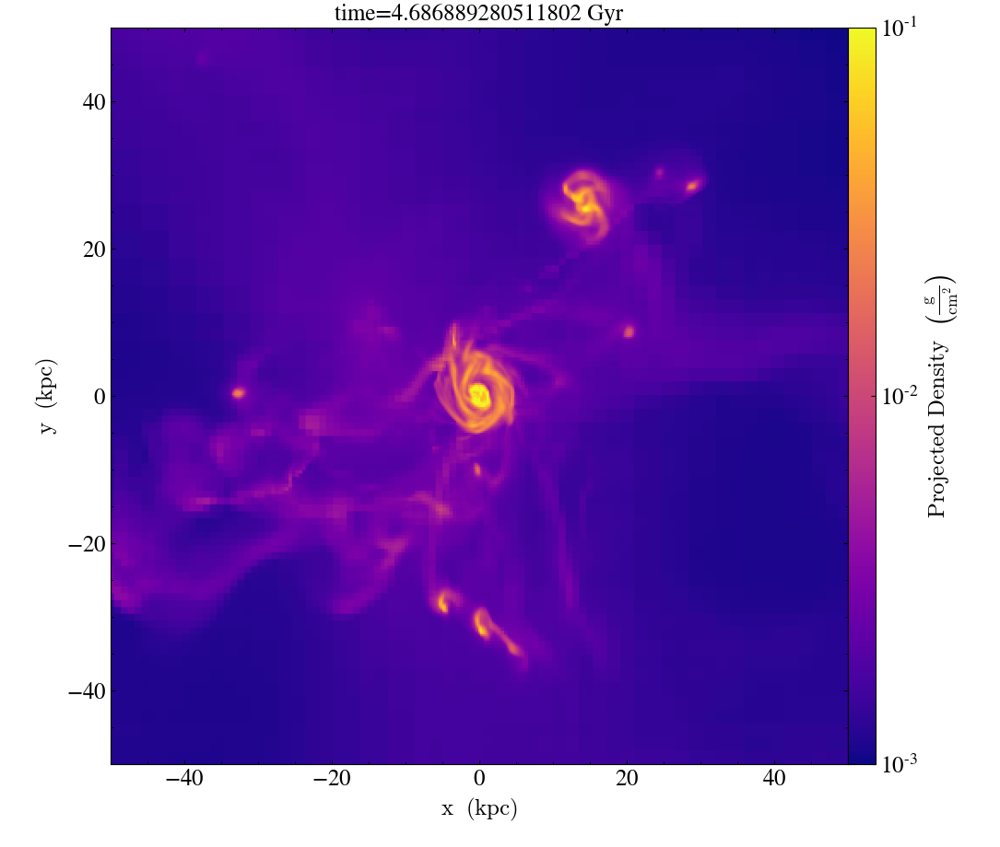

yt : [INFO     ] 2021-11-02 09:38:47,309 Parameters: current_time              = 218.81660281079
yt : [INFO     ] 2021-11-02 09:38:47,310 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:38:47,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:38:47,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:38:47,314 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:38:47,315 Parameters: current_redshift          = 1.358371987546
yt : [INFO     ] 2021-11-02 09:38:47,316 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:38:47,317 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:38:47,318 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:38:47,319 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3579/3579 [00:00<00:00, 4343.59it/s]
yt : [INFO     ] 2021-11-02


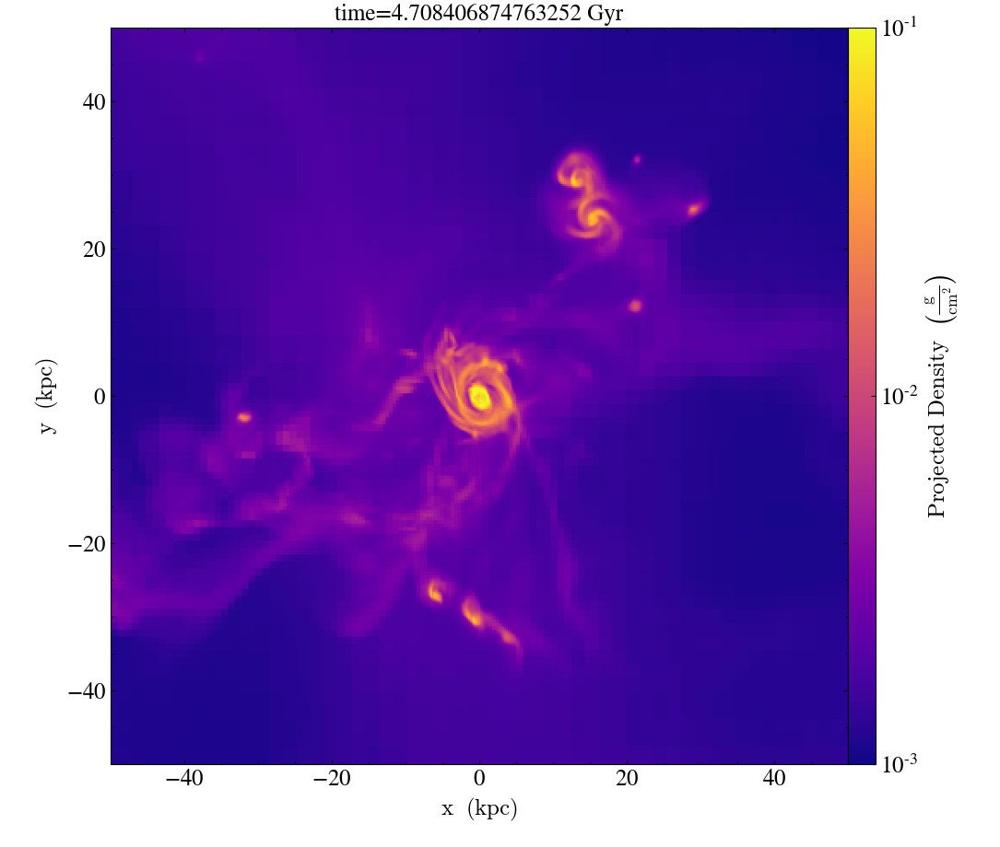

yt : [INFO     ] 2021-11-02 09:39:40,134 Parameters: current_time              = 219.81660281079
yt : [INFO     ] 2021-11-02 09:39:40,135 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:39:40,136 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:39:40,137 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:39:40,138 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:39:40,140 Parameters: current_redshift          = 1.3507837233514
yt : [INFO     ] 2021-11-02 09:39:40,141 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:39:40,142 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:39:40,143 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:39:40,144 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3635/3635 [00:00<00:00, 6499.81it/s]
yt : [INFO     ] 2021-11-0


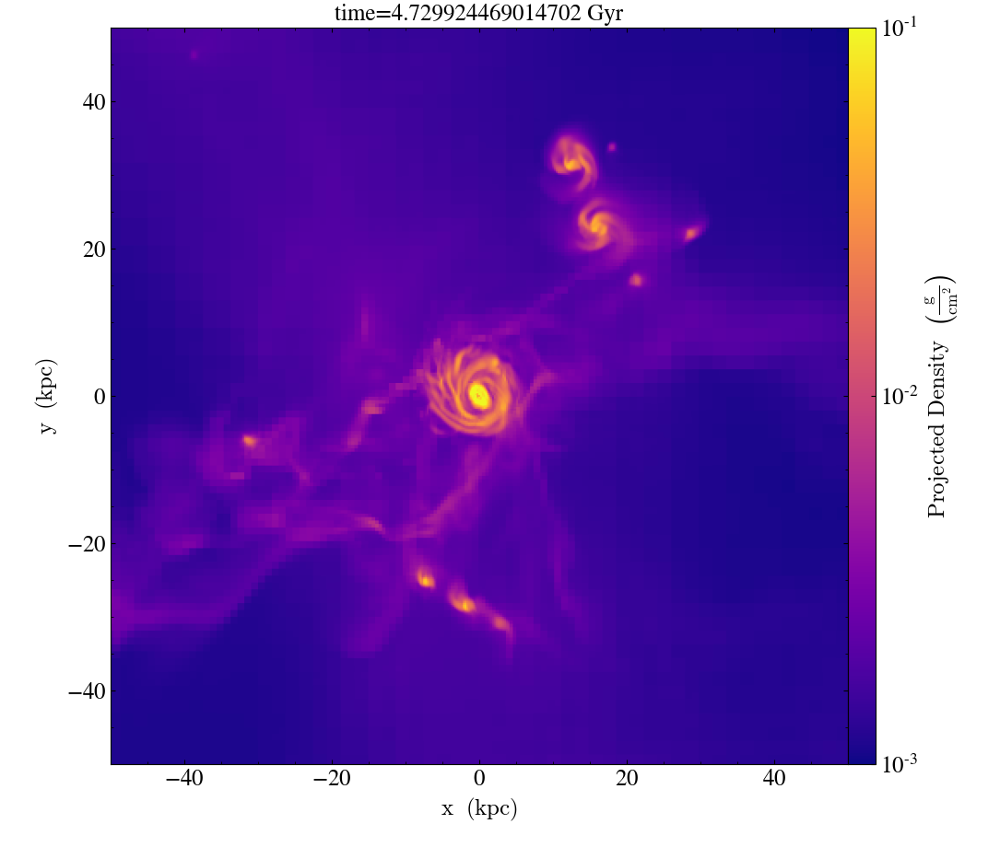

yt : [INFO     ] 2021-11-02 09:40:25,576 Parameters: current_time              = 220.81660281079
yt : [INFO     ] 2021-11-02 09:40:25,577 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:40:25,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:40:25,580 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:40:25,581 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:40:25,582 Parameters: current_redshift          = 1.3432513504815
yt : [INFO     ] 2021-11-02 09:40:25,583 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:40:25,584 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:40:25,585 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:40:25,586 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3618/3618 [00:00<00:00, 6582.55it/s] 
yt : [INFO     ] 2021-11-


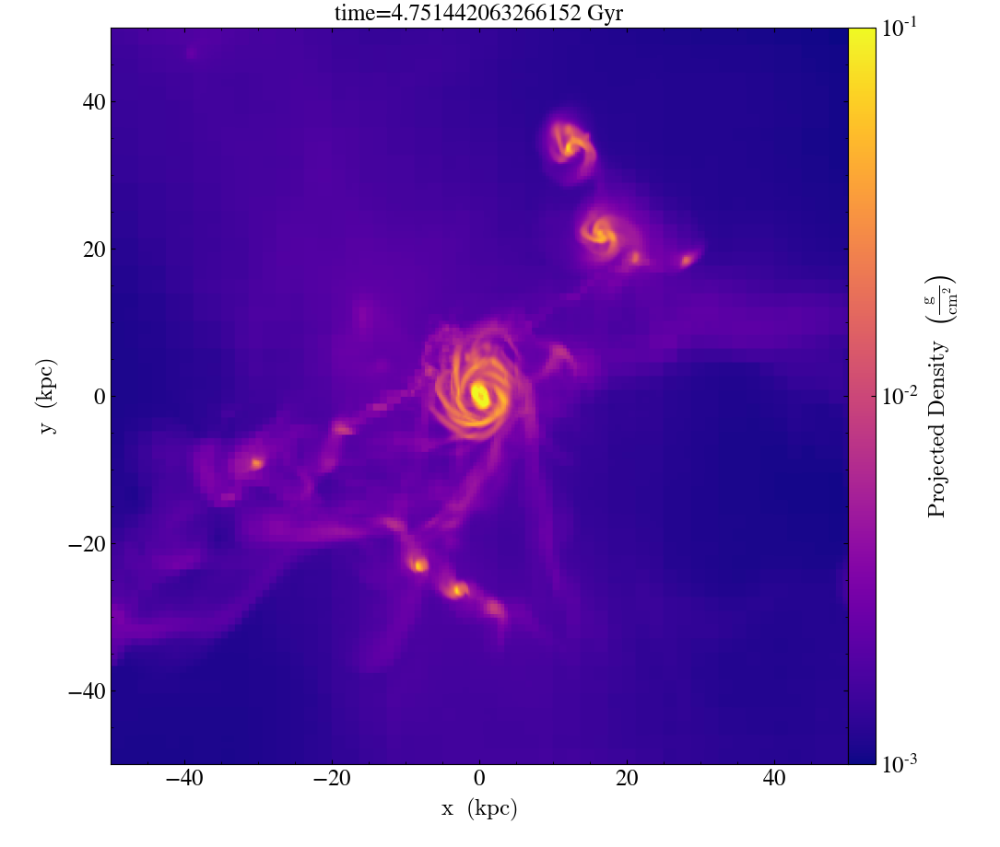

yt : [INFO     ] 2021-11-02 09:41:09,622 Parameters: current_time              = 221.81660281079
yt : [INFO     ] 2021-11-02 09:41:09,623 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:41:09,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:41:09,626 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:41:09,627 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:41:09,628 Parameters: current_redshift          = 1.3357769840903
yt : [INFO     ] 2021-11-02 09:41:09,629 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:41:09,630 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:41:09,631 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:41:09,632 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3593/3593 [00:00<00:00, 6360.43it/s] 
yt : [INFO     ] 2021-11-


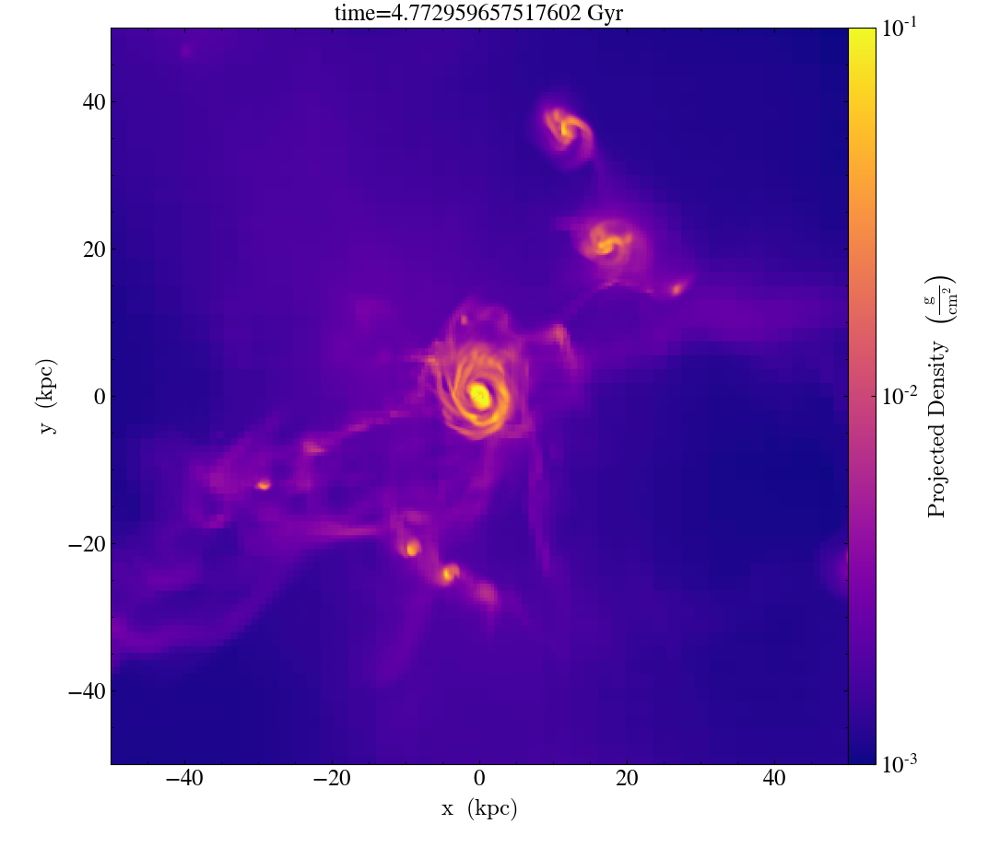

yt : [INFO     ] 2021-11-02 09:42:04,765 Parameters: current_time              = 222.81660281079
yt : [INFO     ] 2021-11-02 09:42:04,766 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:42:04,767 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:42:04,769 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:42:04,770 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:42:04,771 Parameters: current_redshift          = 1.3283599189737
yt : [INFO     ] 2021-11-02 09:42:04,772 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:42:04,773 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:42:04,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:42:04,775 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3587/3587 [00:01<00:00, 3539.54it/s]
yt : [INFO     ] 2021-11-0


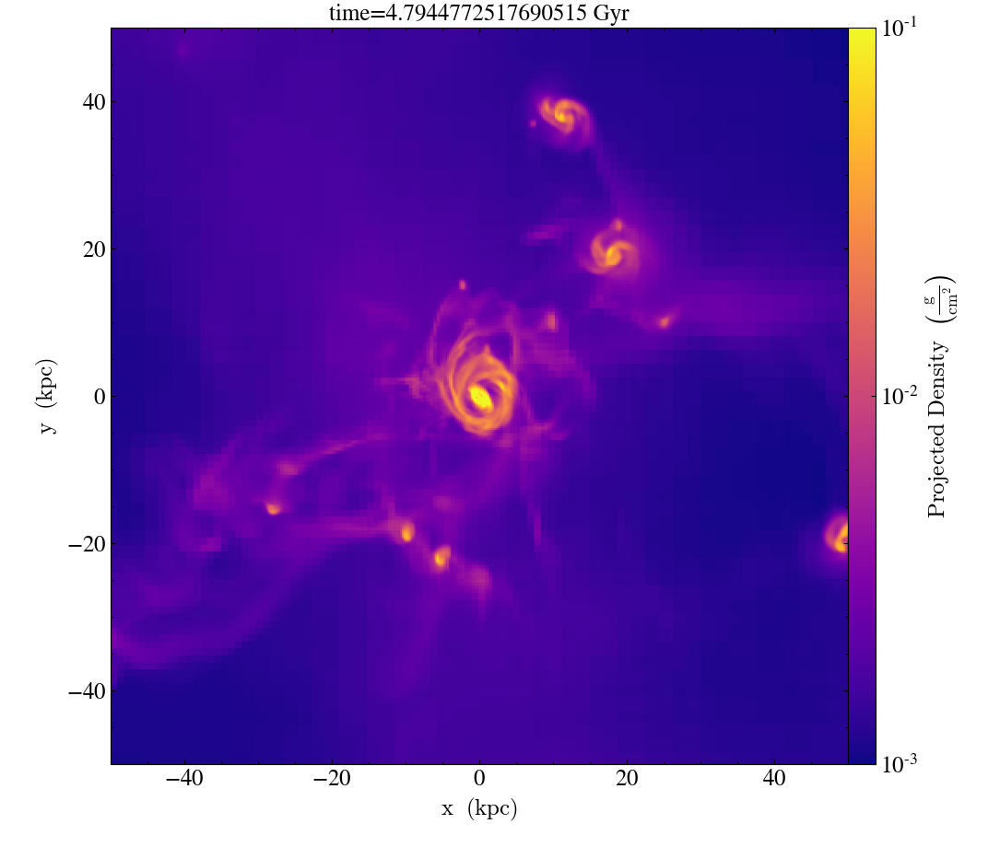

yt : [INFO     ] 2021-11-02 09:42:46,529 Parameters: current_time              = 223.81660281079
yt : [INFO     ] 2021-11-02 09:42:46,530 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:42:46,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:42:46,533 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:42:46,534 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:42:46,535 Parameters: current_redshift          = 1.3209911541294
yt : [INFO     ] 2021-11-02 09:42:46,536 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:42:46,537 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:42:46,538 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:42:46,539 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3633/3633 [00:00<00:00, 4279.51it/s]
yt : [INFO     ] 2021-11-0


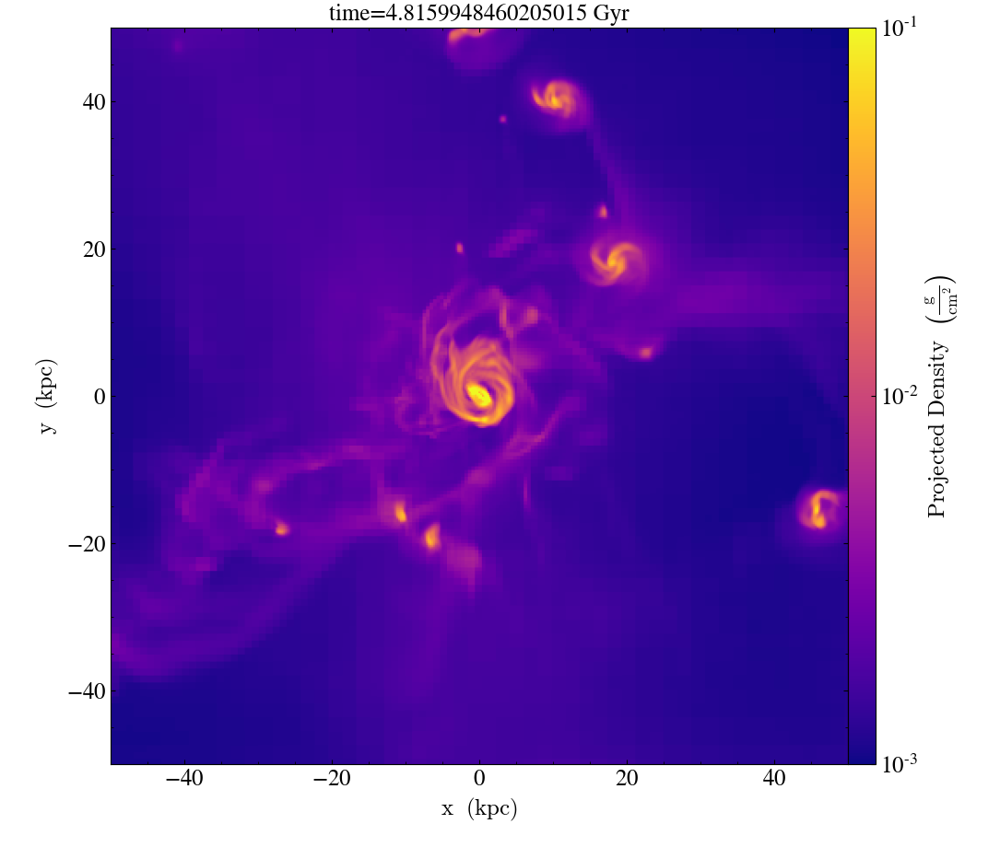

yt : [INFO     ] 2021-11-02 09:43:40,631 Parameters: current_time              = 224.81660281079
yt : [INFO     ] 2021-11-02 09:43:40,633 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:43:40,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:43:40,635 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:43:40,636 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:43:40,638 Parameters: current_redshift          = 1.3136702502195
yt : [INFO     ] 2021-11-02 09:43:40,639 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:43:40,640 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:43:40,641 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:43:40,642 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3629/3629 [00:00<00:00, 6577.22it/s]
yt : [INFO     ] 2021-11-0


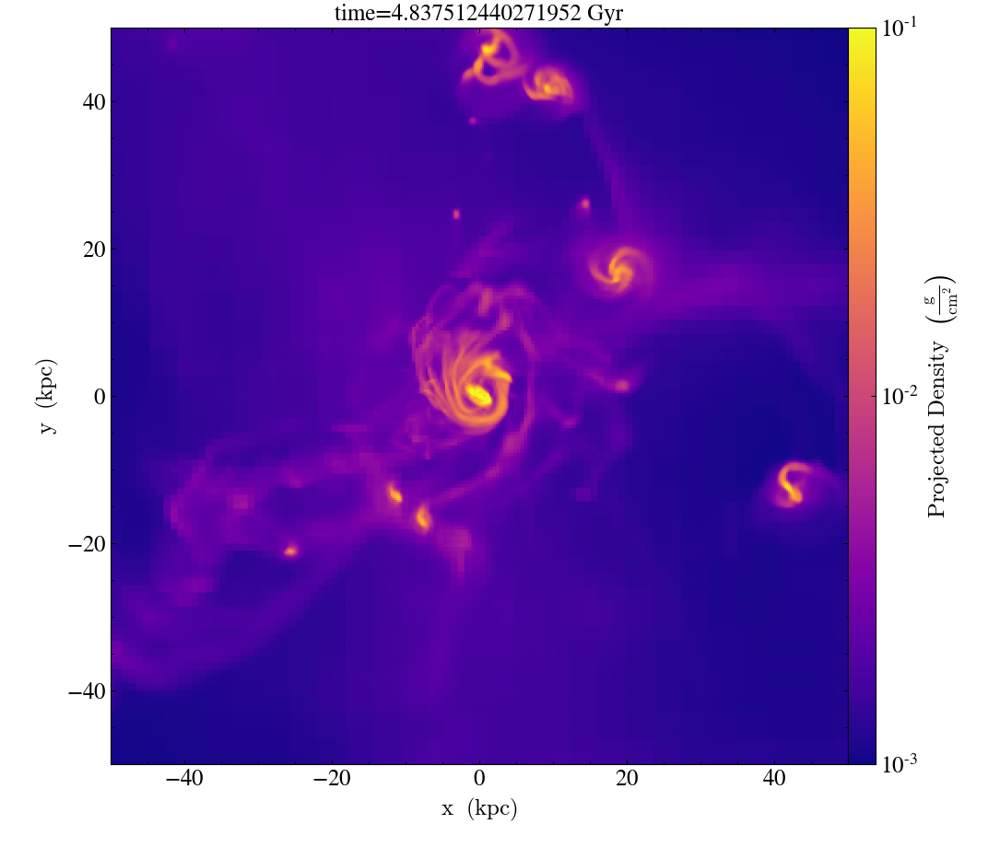

yt : [INFO     ] 2021-11-02 09:44:32,189 Parameters: current_time              = 225.81660281079
yt : [INFO     ] 2021-11-02 09:44:32,198 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:44:32,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:44:32,201 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:44:32,202 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:44:32,203 Parameters: current_redshift          = 1.3064047763543
yt : [INFO     ] 2021-11-02 09:44:32,204 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:44:32,205 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:44:32,206 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:44:32,208 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3579/3579 [00:00<00:00, 4748.71it/s] 
yt : [INFO     ] 2021-11-


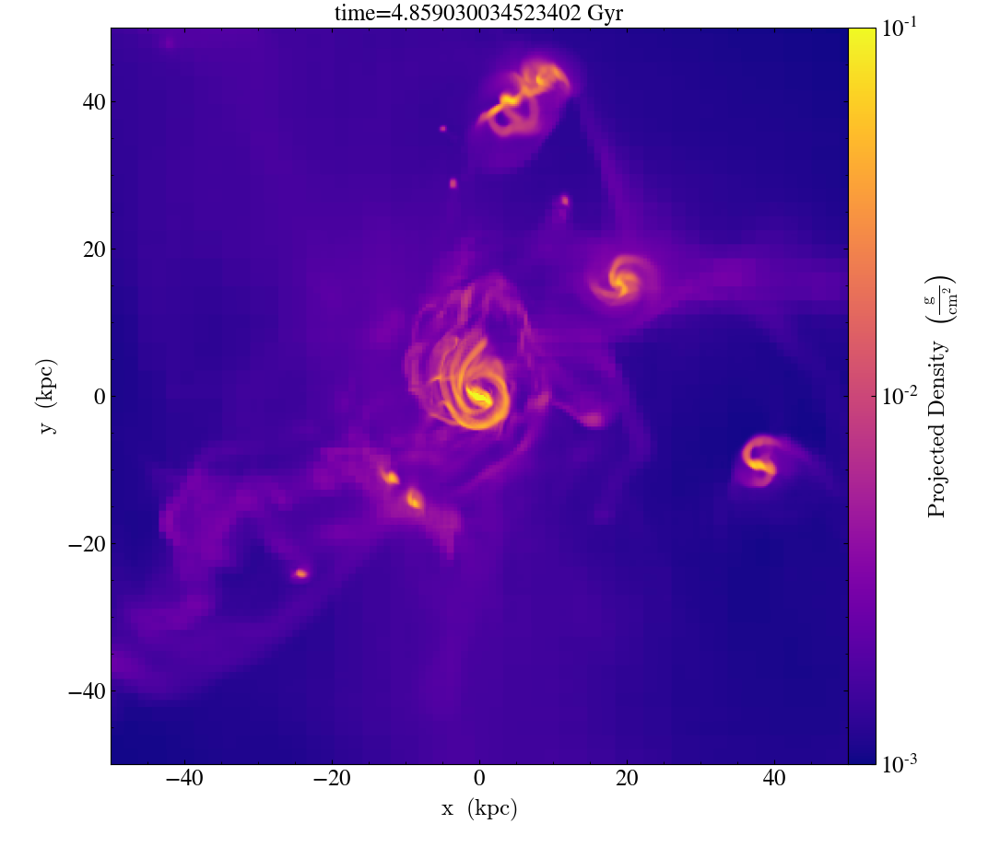

yt : [INFO     ] 2021-11-02 09:45:23,830 Parameters: current_time              = 226.81651401629
yt : [INFO     ] 2021-11-02 09:45:23,832 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:45:23,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:45:23,835 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:45:23,836 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:45:23,837 Parameters: current_redshift          = 1.2991947080169
yt : [INFO     ] 2021-11-02 09:45:23,838 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:45:23,839 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:45:23,840 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:45:23,841 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3670/3670 [00:00<00:00, 5482.97it/s] 
yt : [INFO     ] 2021-11-


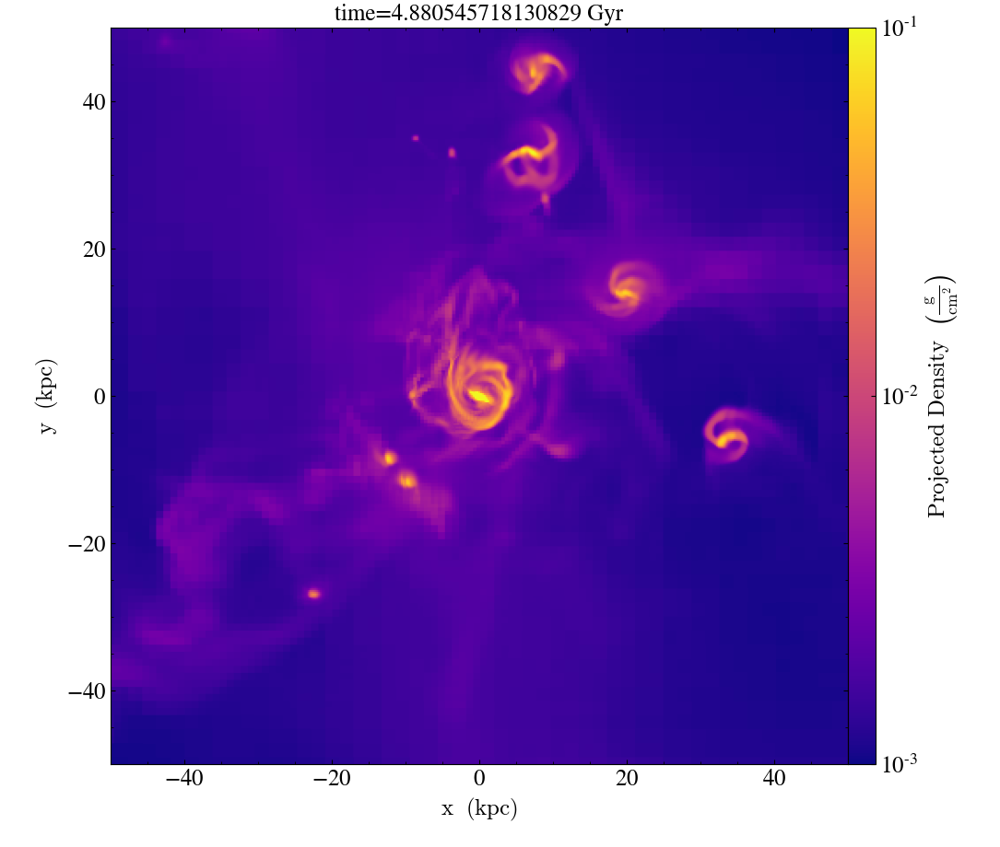

yt : [INFO     ] 2021-11-02 09:46:04,611 Parameters: current_time              = 227.81660281967
yt : [INFO     ] 2021-11-02 09:46:04,613 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:46:04,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:46:04,615 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:46:04,616 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:46:04,617 Parameters: current_redshift          = 1.2920357786025
yt : [INFO     ] 2021-11-02 09:46:04,619 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:46:04,620 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:46:04,621 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:46:04,622 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3606/3606 [00:00<00:00, 3636.21it/s]
yt : [INFO     ] 2021-11-0


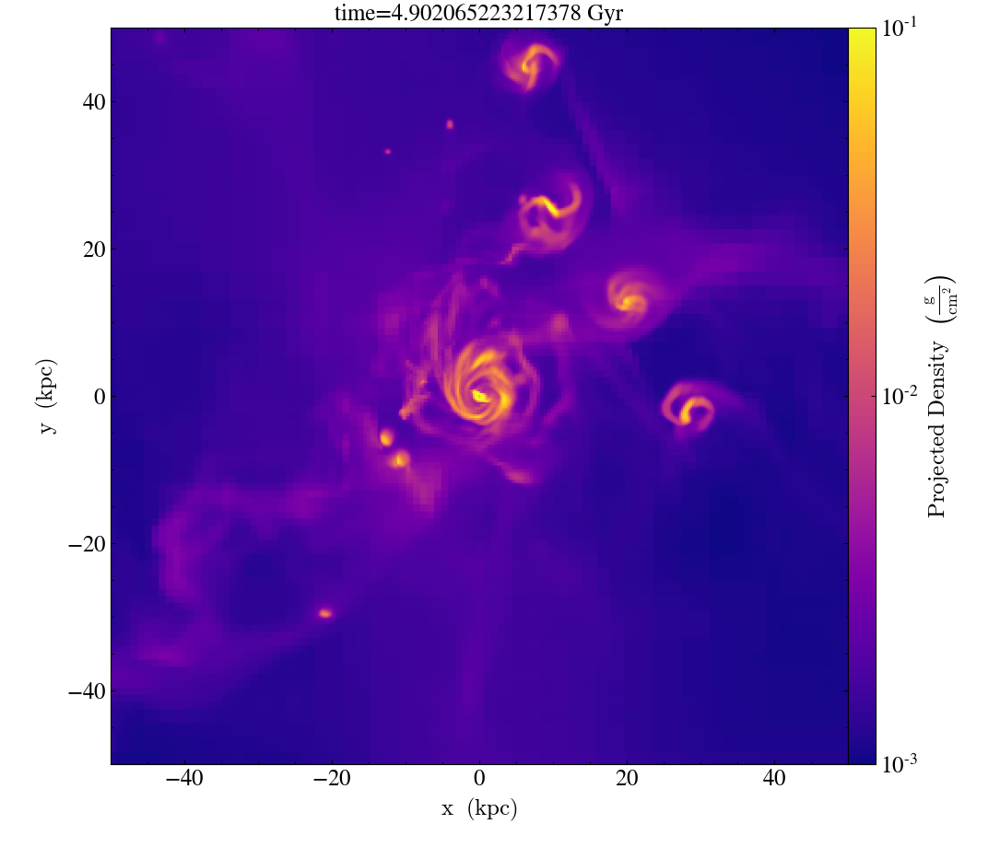

yt : [INFO     ] 2021-11-02 09:47:00,194 Parameters: current_time              = 228.81660281079
yt : [INFO     ] 2021-11-02 09:47:00,196 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:47:00,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:47:00,198 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:47:00,199 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:47:00,201 Parameters: current_redshift          = 1.2849161784907
yt : [INFO     ] 2021-11-02 09:47:00,202 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:47:00,203 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:47:00,204 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:47:00,205 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3650/3650 [00:01<00:00, 3594.08it/s]
yt : [INFO     ] 2021-11-0


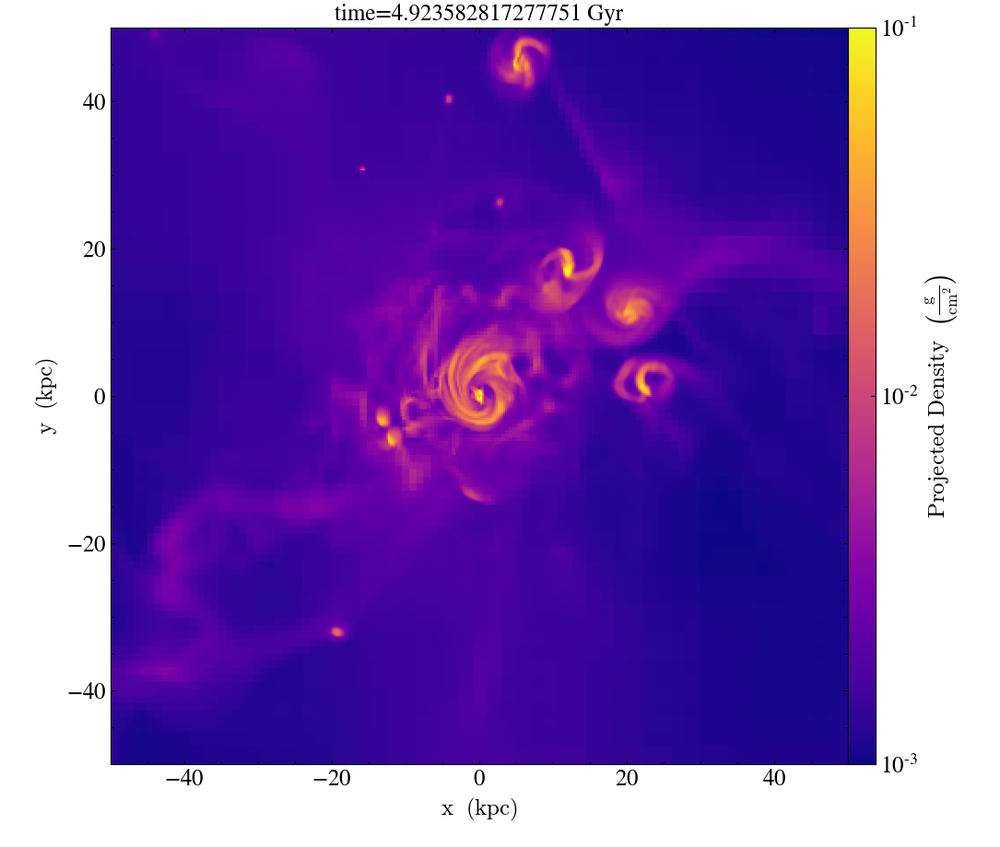

yt : [INFO     ] 2021-11-02 09:47:58,925 Parameters: current_time              = 229.81660281079
yt : [INFO     ] 2021-11-02 09:47:58,926 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:47:58,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:47:58,929 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:47:58,930 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:47:58,931 Parameters: current_redshift          = 1.2778495962437
yt : [INFO     ] 2021-11-02 09:47:58,932 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:47:58,933 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:47:58,934 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:47:58,935 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3654/3654 [00:00<00:00, 5701.54it/s]
yt : [INFO     ] 2021-11-0


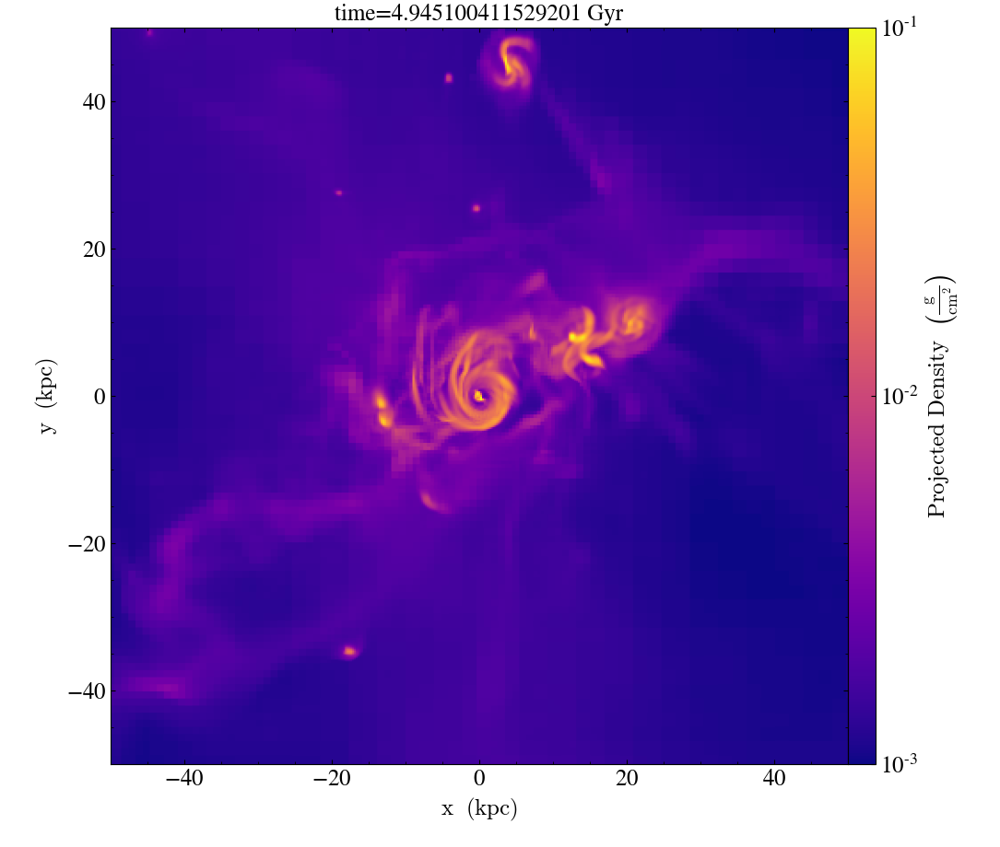

yt : [INFO     ] 2021-11-02 09:48:44,446 Parameters: current_time              = 230.81660281079
yt : [INFO     ] 2021-11-02 09:48:44,447 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:48:44,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:48:44,450 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:48:44,451 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:48:44,452 Parameters: current_redshift          = 1.2708354089828
yt : [INFO     ] 2021-11-02 09:48:44,453 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:48:44,454 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:48:44,455 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:48:44,456 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3677/3677 [00:00<00:00, 5750.05it/s]
yt : [INFO     ] 2021-11-0


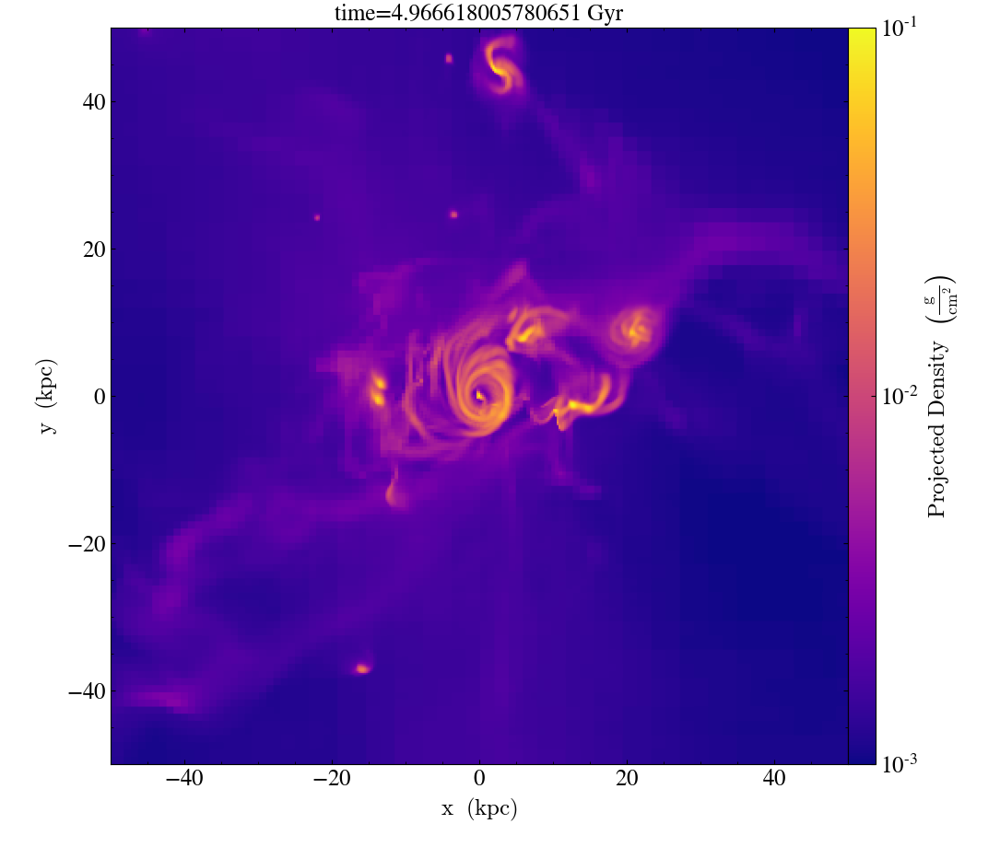

yt : [INFO     ] 2021-11-02 09:49:37,201 Parameters: current_time              = 231.81660281079
yt : [INFO     ] 2021-11-02 09:49:37,203 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:49:37,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:49:37,205 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:49:37,207 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:49:37,208 Parameters: current_redshift          = 1.2638730037427
yt : [INFO     ] 2021-11-02 09:49:37,209 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:49:37,210 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:49:37,211 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:49:37,212 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3671/3671 [00:00<00:00, 5507.29it/s] 
yt : [INFO     ] 2021-11-


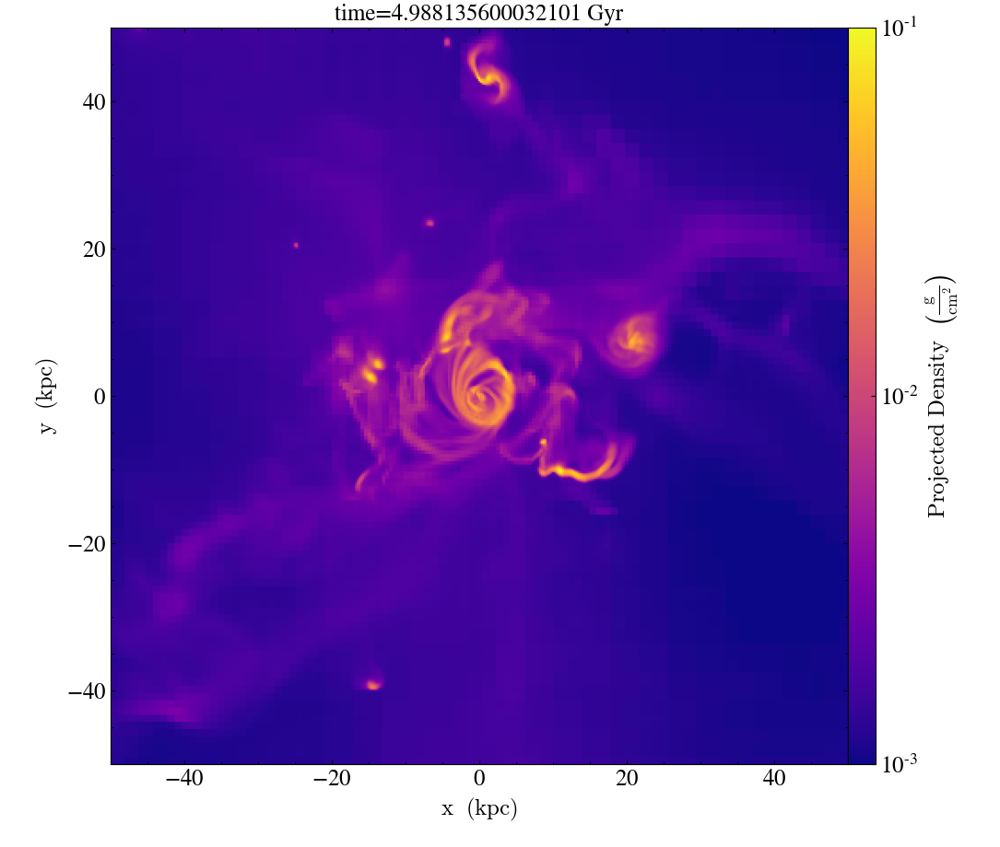

yt : [INFO     ] 2021-11-02 09:50:30,436 Parameters: current_time              = 232.81660281079
yt : [INFO     ] 2021-11-02 09:50:30,437 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:50:30,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:50:30,440 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:50:30,441 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:50:30,442 Parameters: current_redshift          = 1.2569514069575
yt : [INFO     ] 2021-11-02 09:50:30,443 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:50:30,445 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:50:30,446 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:50:30,447 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3740/3740 [00:00<00:00, 5468.36it/s] 
yt : [INFO     ] 2021-11-


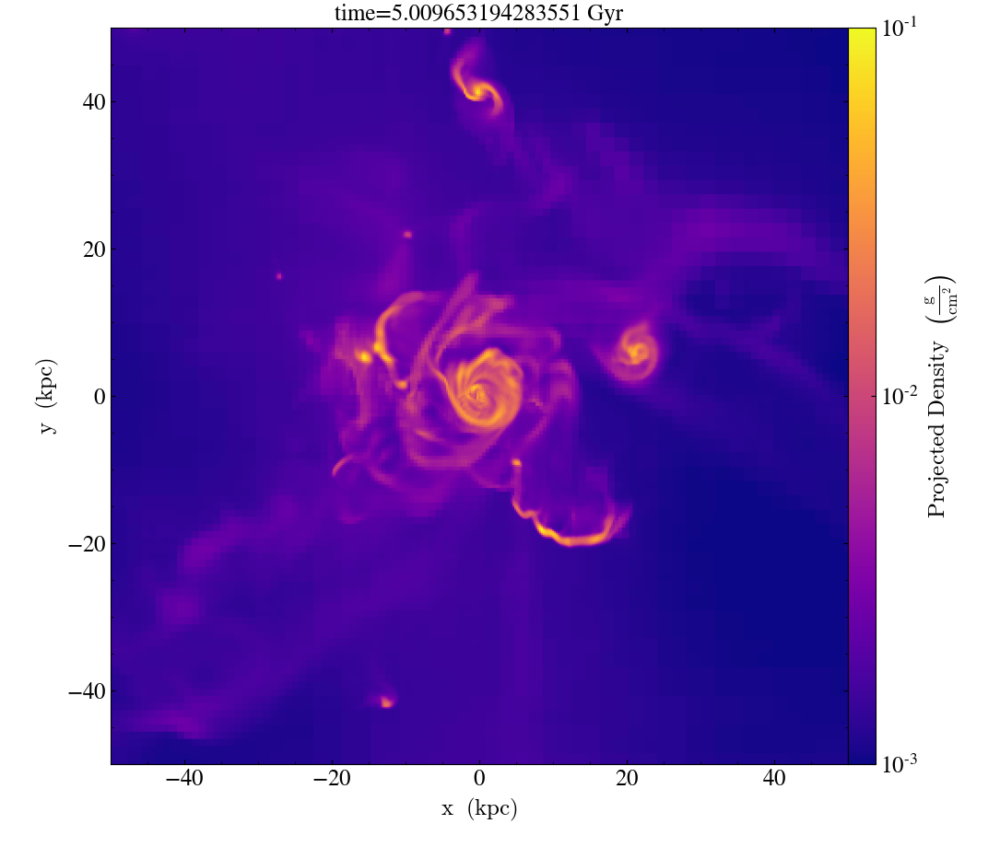

yt : [INFO     ] 2021-11-02 09:51:24,359 Parameters: current_time              = 233.81660281079
yt : [INFO     ] 2021-11-02 09:51:24,361 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:51:24,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:51:24,363 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:51:24,365 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:51:24,366 Parameters: current_redshift          = 1.2500743308838
yt : [INFO     ] 2021-11-02 09:51:24,367 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:51:24,368 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:51:24,369 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:51:24,370 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3720/3720 [00:01<00:00, 3634.72it/s]
yt : [INFO     ] 2021-11-0


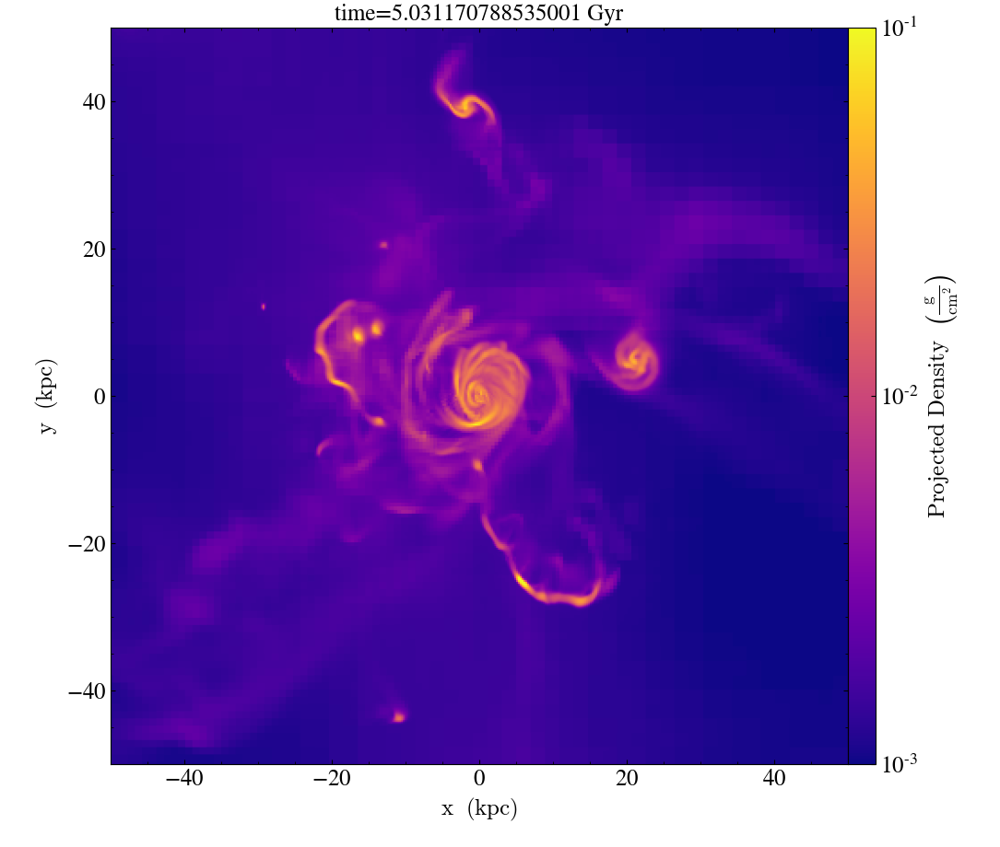

yt : [INFO     ] 2021-11-02 09:52:41,958 Parameters: current_time              = 234.81660281079
yt : [INFO     ] 2021-11-02 09:52:41,959 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:52:41,961 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:52:41,962 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:52:41,963 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:52:41,965 Parameters: current_redshift          = 1.2432474254325
yt : [INFO     ] 2021-11-02 09:52:41,966 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:52:41,967 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:52:41,968 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:52:41,969 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3711/3711 [00:01<00:00, 3404.21it/s]
yt : [INFO     ] 2021-11-0


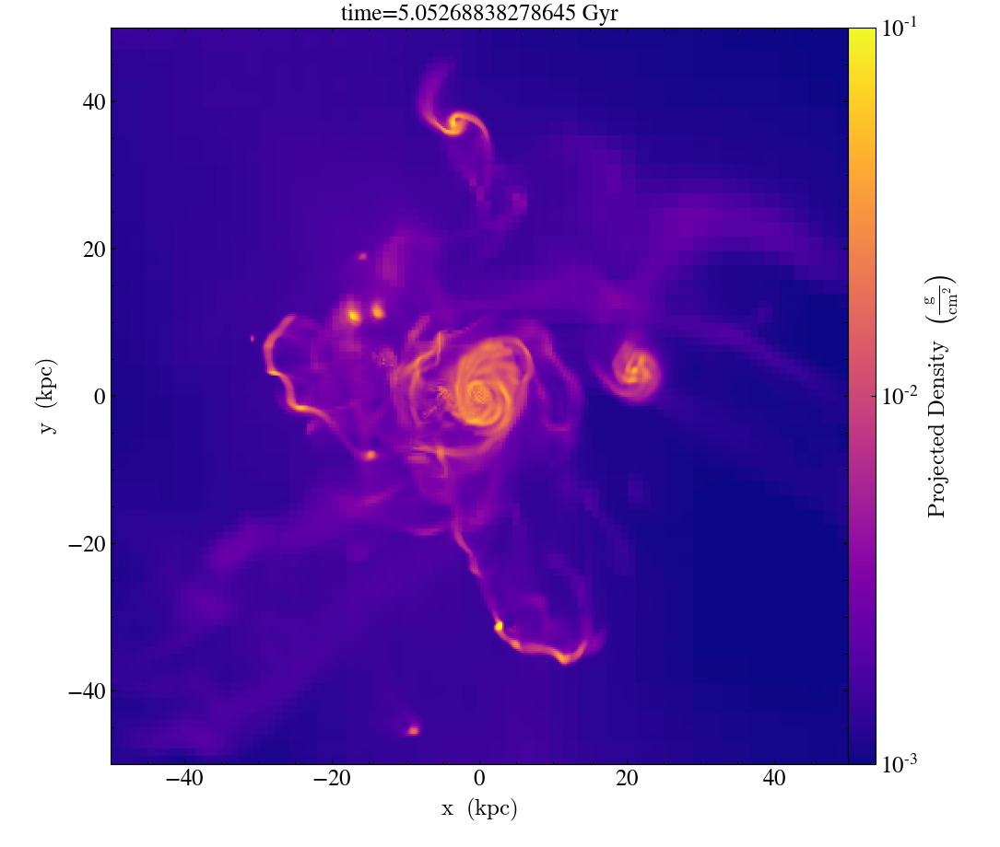

yt : [INFO     ] 2021-11-02 09:53:33,669 Parameters: current_time              = 235.81660281079
yt : [INFO     ] 2021-11-02 09:53:33,671 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:53:33,672 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:53:33,673 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:53:33,675 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:53:33,676 Parameters: current_redshift          = 1.2364701132614
yt : [INFO     ] 2021-11-02 09:53:33,677 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:53:33,678 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:53:33,679 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:53:33,680 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3743/3743 [00:00<00:00, 5572.96it/s]
yt : [INFO     ] 2021-11-0


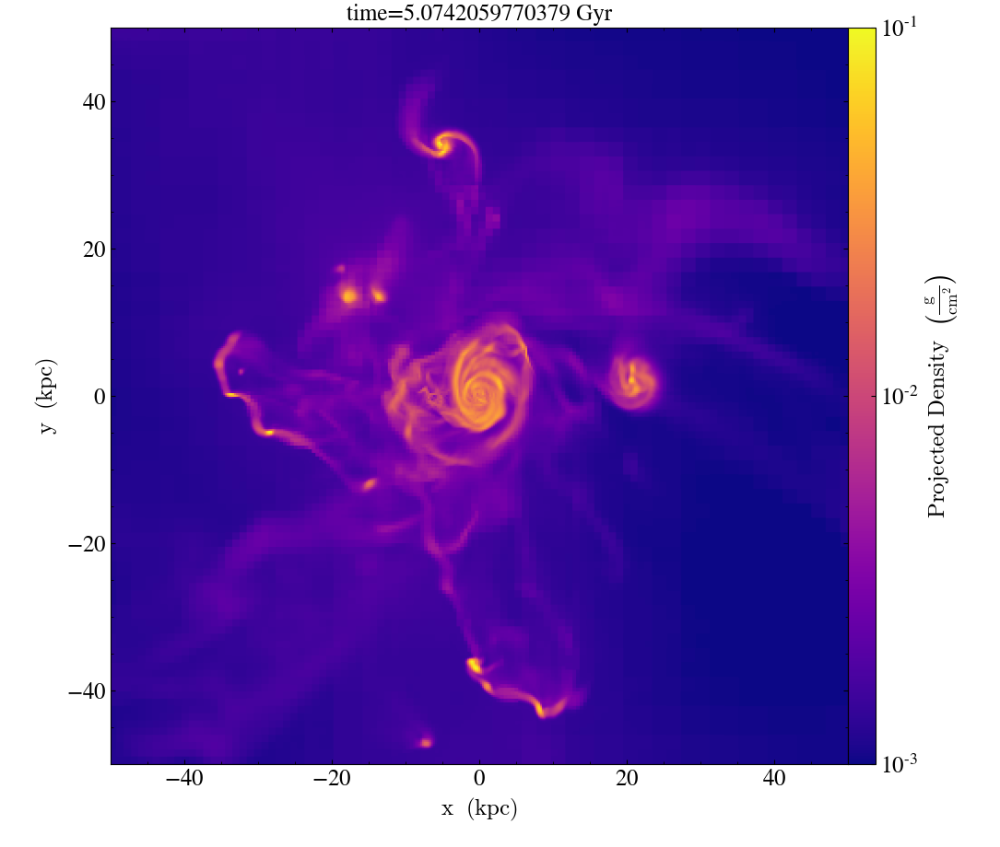

yt : [INFO     ] 2021-11-02 09:54:25,939 Parameters: current_time              = 236.81660281079
yt : [INFO     ] 2021-11-02 09:54:25,941 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:54:25,942 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:54:25,943 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:54:25,953 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:54:25,955 Parameters: current_redshift          = 1.2297406300633
yt : [INFO     ] 2021-11-02 09:54:25,956 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:54:25,957 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:54:25,958 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:54:25,959 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3739/3739 [00:00<00:00, 5824.76it/s] 
yt : [INFO     ] 2021-11-


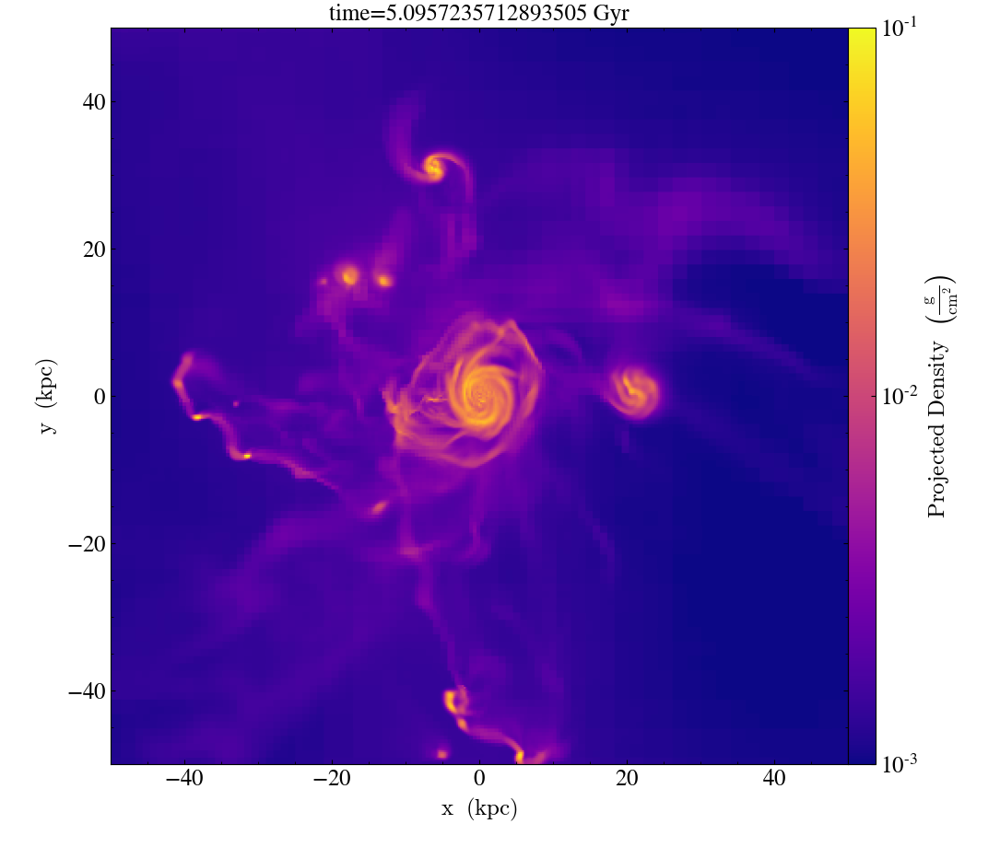

yt : [INFO     ] 2021-11-02 09:55:19,202 Parameters: current_time              = 237.81660281079
yt : [INFO     ] 2021-11-02 09:55:19,203 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:55:19,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:55:19,214 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:55:19,216 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:55:19,217 Parameters: current_redshift          = 1.2230442419153
yt : [INFO     ] 2021-11-02 09:55:19,218 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:55:19,219 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:55:19,220 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:55:19,221 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3734/3734 [00:01<00:00, 3223.41it/s]
yt : [INFO     ] 2021-11-0


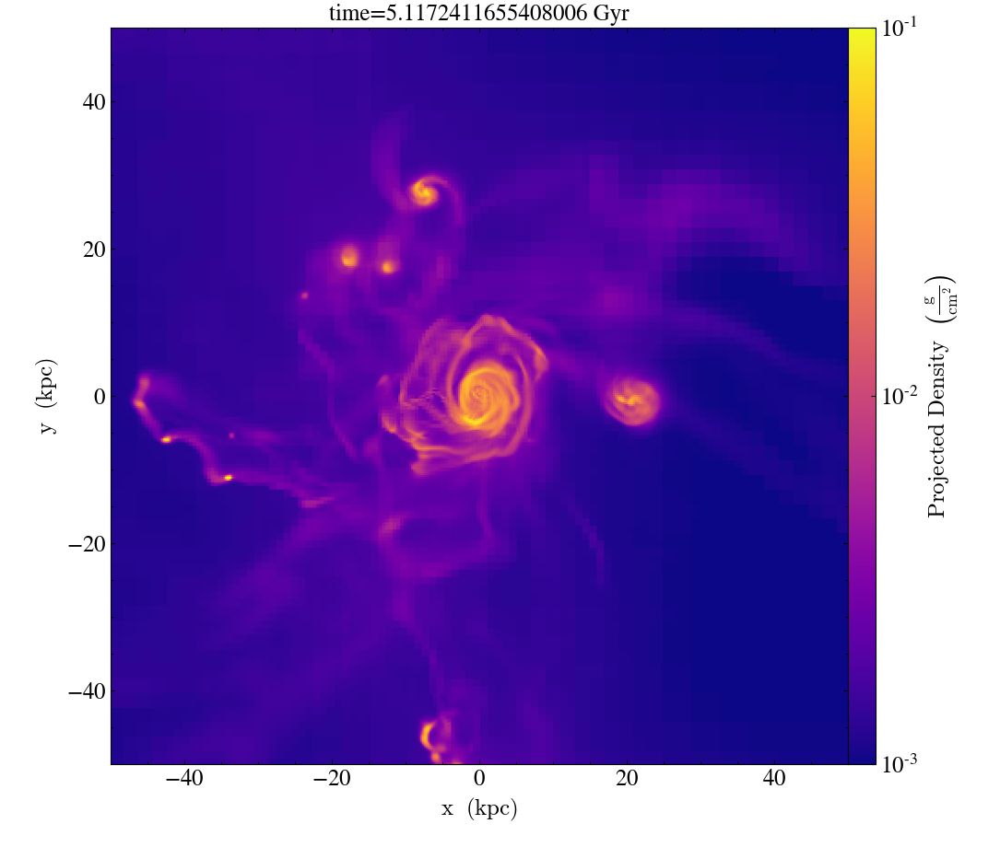

yt : [INFO     ] 2021-11-02 09:56:10,953 Parameters: current_time              = 238.81660281079
yt : [INFO     ] 2021-11-02 09:56:10,955 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:56:10,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:56:10,957 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:56:10,958 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:56:10,959 Parameters: current_redshift          = 1.2163959369233
yt : [INFO     ] 2021-11-02 09:56:10,960 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:56:10,962 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:56:10,963 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:56:10,964 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3710/3710 [00:00<00:00, 5168.31it/s]
yt : [INFO     ] 2021-11-0


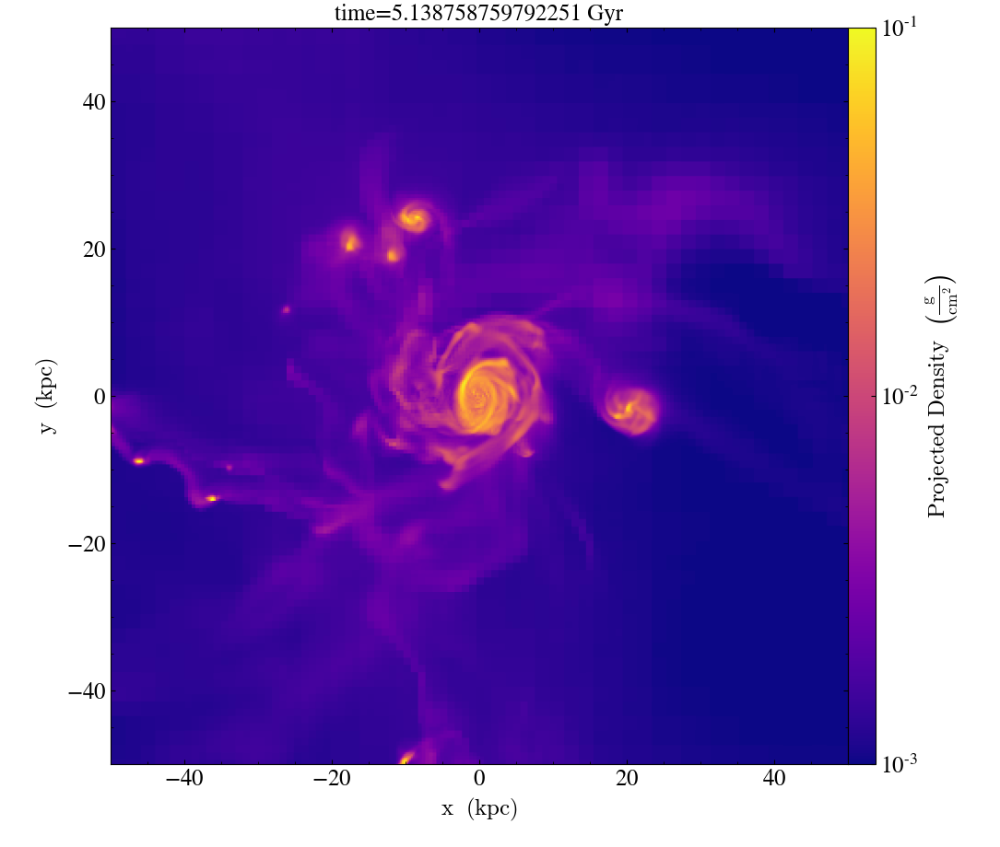

yt : [INFO     ] 2021-11-02 09:57:14,619 Parameters: current_time              = 239.81660281079
yt : [INFO     ] 2021-11-02 09:57:14,620 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:57:14,621 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:57:14,622 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:57:14,624 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:57:14,625 Parameters: current_redshift          = 1.2097951706485
yt : [INFO     ] 2021-11-02 09:57:14,626 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:57:14,627 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:57:14,628 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:57:14,629 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3798/3798 [00:00<00:00, 5020.00it/s]
yt : [INFO     ] 2021-11-0


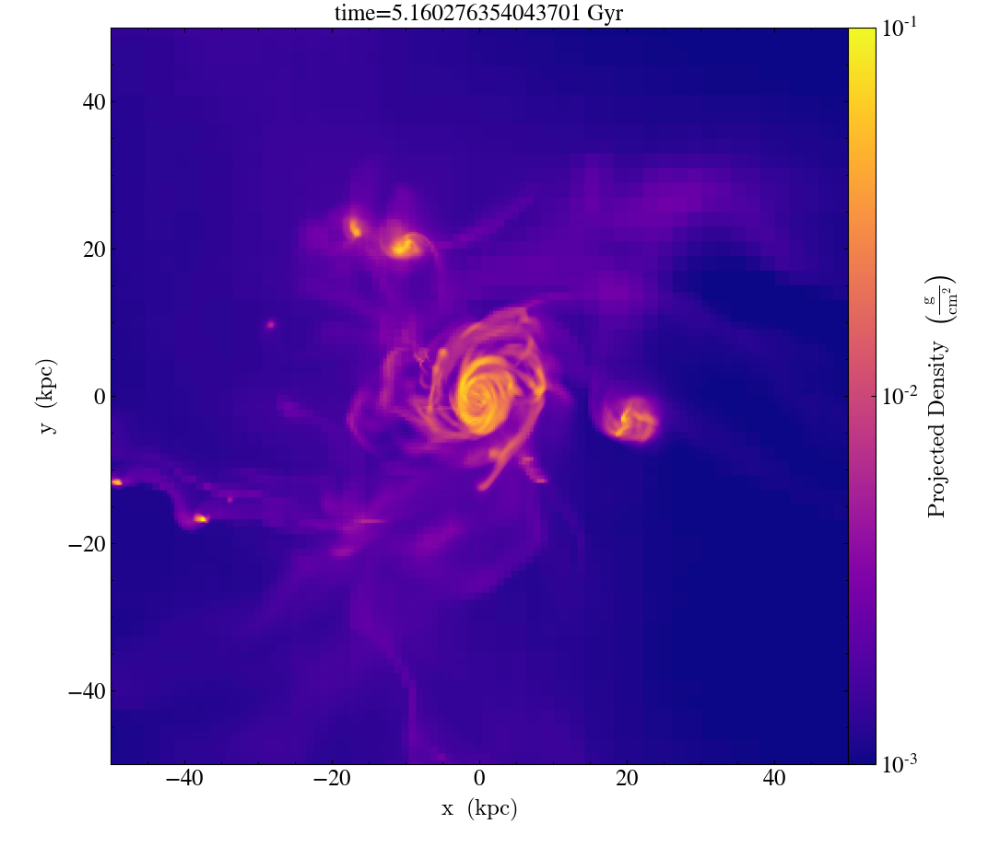

yt : [INFO     ] 2021-11-02 09:58:11,116 Parameters: current_time              = 240.81660281079
yt : [INFO     ] 2021-11-02 09:58:11,118 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:58:11,119 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:58:11,120 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:58:11,122 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:58:11,123 Parameters: current_redshift          = 1.2032414070537
yt : [INFO     ] 2021-11-02 09:58:11,124 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:58:11,125 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:58:11,126 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:58:11,127 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3735/3735 [00:00<00:00, 5616.88it/s] 
yt : [INFO     ] 2021-11-


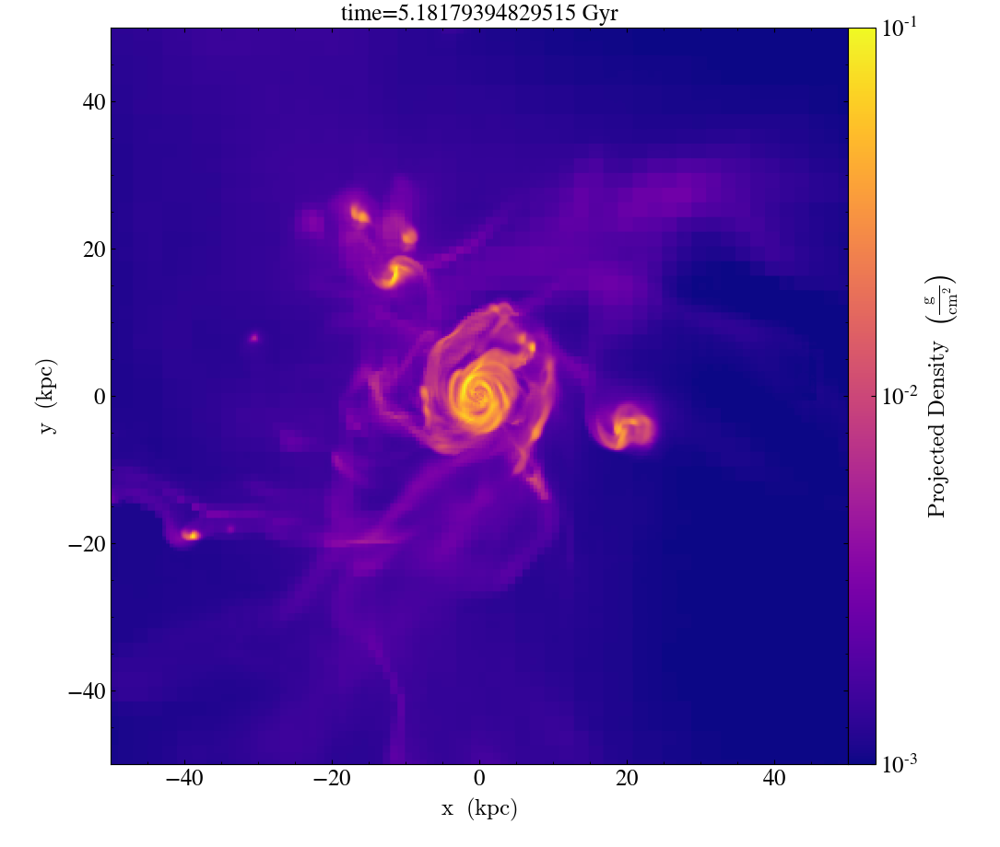

yt : [INFO     ] 2021-11-02 09:59:05,154 Parameters: current_time              = 241.81655308264
yt : [INFO     ] 2021-11-02 09:59:05,156 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:59:05,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:59:05,159 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:59:05,160 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:59:05,161 Parameters: current_redshift          = 1.1967271078703
yt : [INFO     ] 2021-11-02 09:59:05,162 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:59:05,163 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:59:05,164 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:59:05,165 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3750/3750 [00:00<00:00, 5411.83it/s] 
yt : [INFO     ] 2021-11-


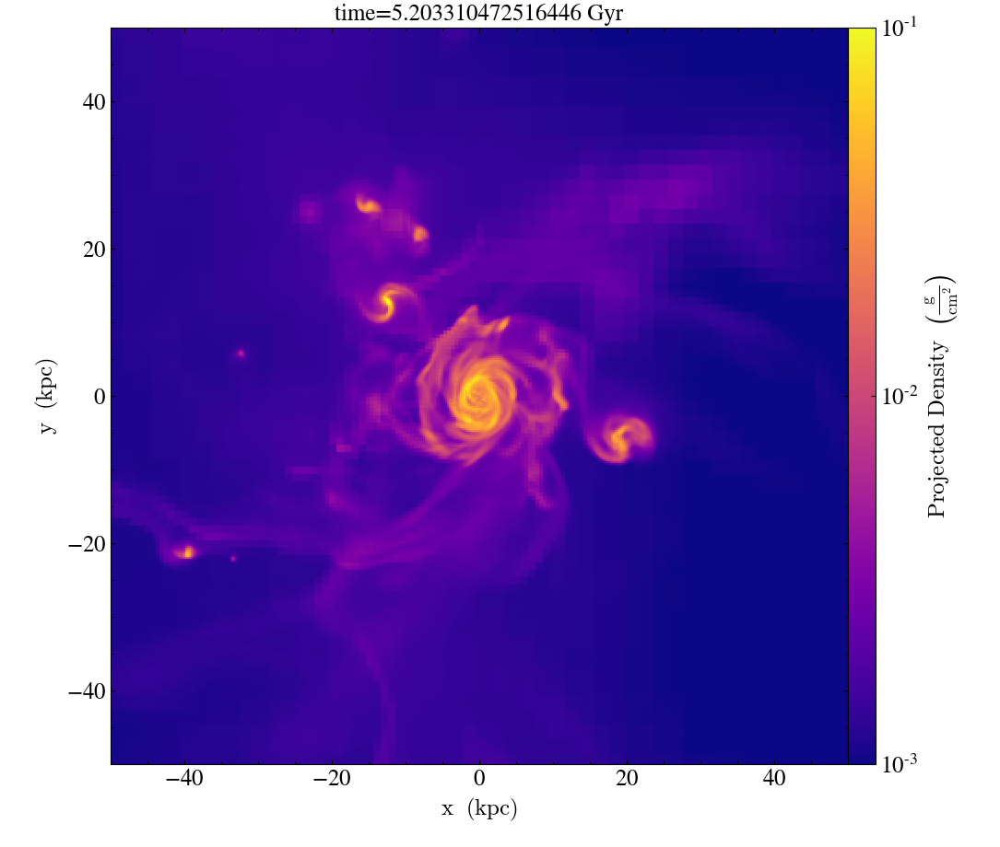

yt : [INFO     ] 2021-11-02 09:59:53,733 Parameters: current_time              = 242.81660281576
yt : [INFO     ] 2021-11-02 09:59:53,742 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 09:59:53,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 09:59:53,745 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 09:59:53,746 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 09:59:53,747 Parameters: current_redshift          = 1.1902489117629
yt : [INFO     ] 2021-11-02 09:59:53,748 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 09:59:53,749 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 09:59:53,751 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 09:59:53,752 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3741/3741 [00:01<00:00, 3140.58it/s]
yt : [INFO     ] 2021-11-0


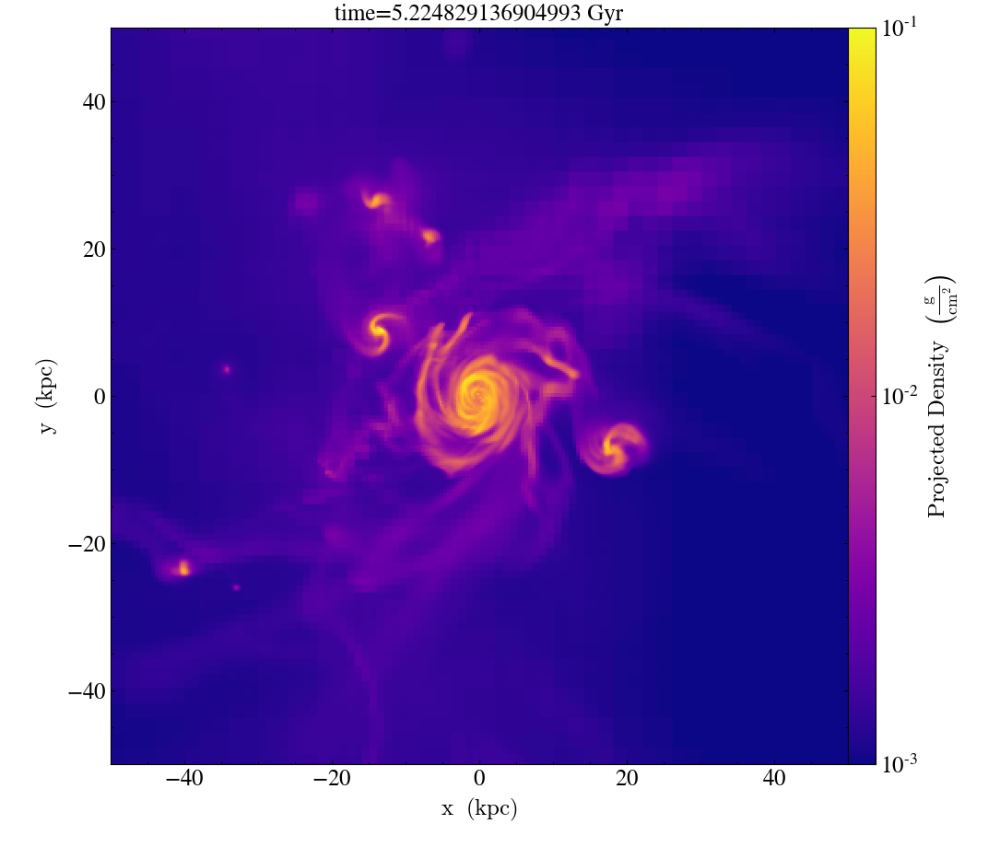

yt : [INFO     ] 2021-11-02 10:00:47,021 Parameters: current_time              = 243.81660281079
yt : [INFO     ] 2021-11-02 10:00:47,024 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:00:47,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:00:47,026 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:00:47,027 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:00:47,028 Parameters: current_redshift          = 1.183816647208
yt : [INFO     ] 2021-11-02 10:00:47,029 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:00:47,031 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:00:47,032 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:00:47,033 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3733/3733 [00:00<00:00, 5450.42it/s] 
yt : [INFO     ] 2021-11-0


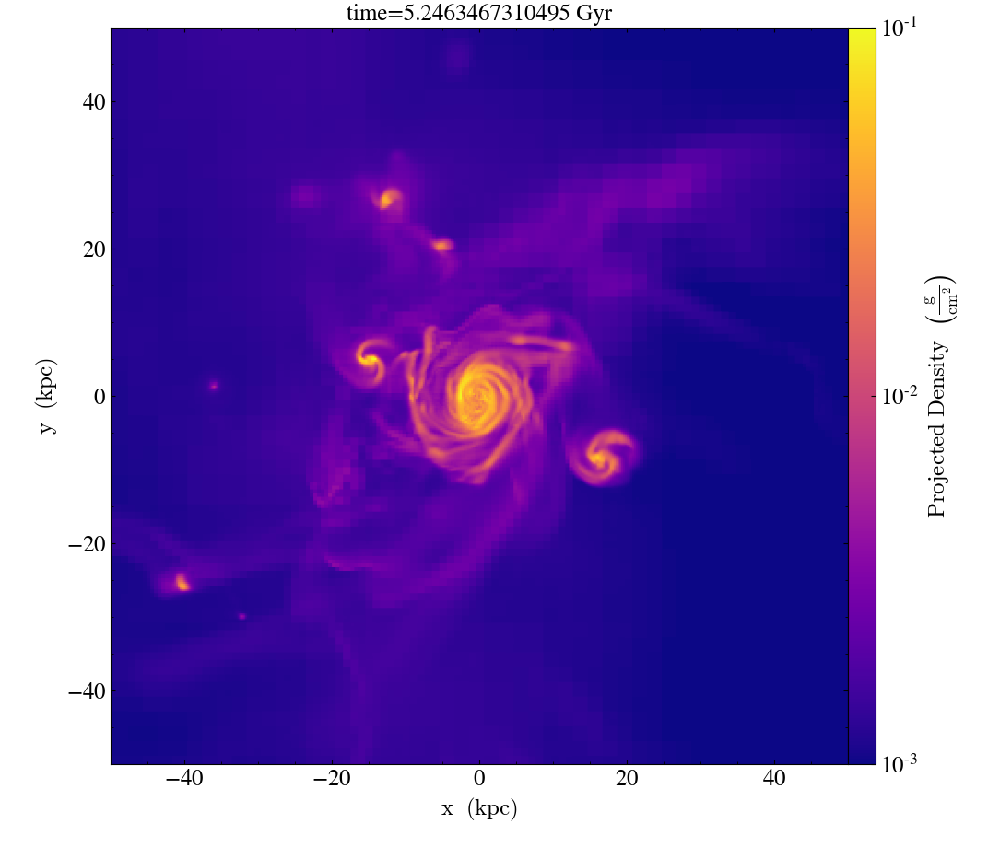

yt : [INFO     ] 2021-11-02 10:01:38,725 Parameters: current_time              = 244.81660281079
yt : [INFO     ] 2021-11-02 10:01:38,726 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:01:38,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:01:38,729 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:01:38,730 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:01:38,731 Parameters: current_redshift          = 1.1774294846324
yt : [INFO     ] 2021-11-02 10:01:38,732 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:01:38,733 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:01:38,734 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:01:38,736 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3737/3737 [00:01<00:00, 3670.58it/s]
yt : [INFO     ] 2021-11-0


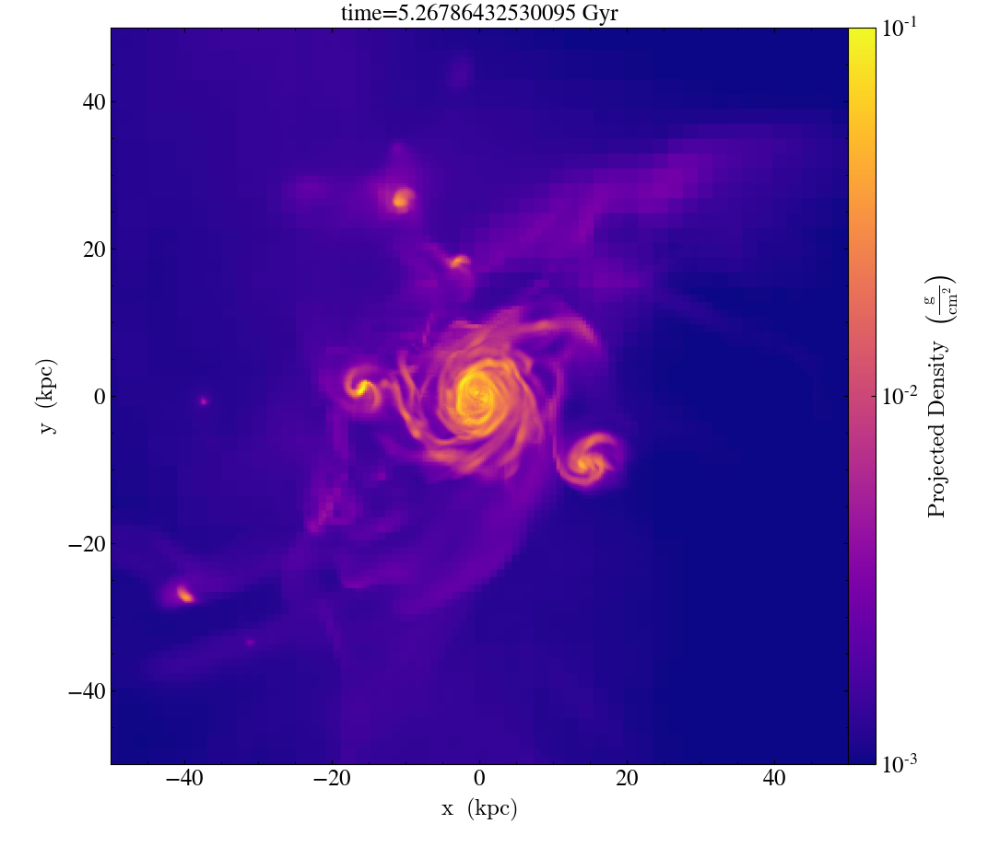

yt : [INFO     ] 2021-11-02 10:02:50,358 Parameters: current_time              = 245.81660281079
yt : [INFO     ] 2021-11-02 10:02:50,359 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:02:50,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:02:50,373 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:02:50,374 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:02:50,375 Parameters: current_redshift          = 1.1710869255225
yt : [INFO     ] 2021-11-02 10:02:50,376 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:02:50,377 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:02:50,378 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:02:50,380 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3733/3733 [00:00<00:00, 5637.30it/s]
yt : [INFO     ] 2021-11-0


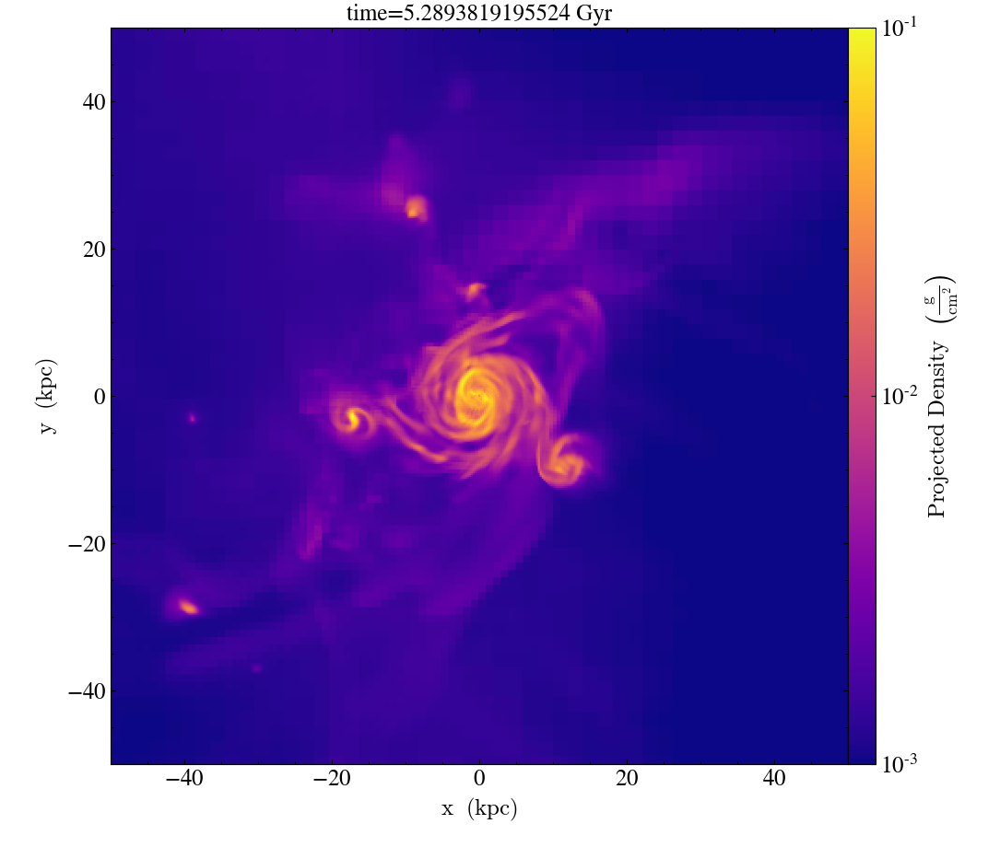

yt : [INFO     ] 2021-11-02 10:03:44,453 Parameters: current_time              = 246.81660281079
yt : [INFO     ] 2021-11-02 10:03:44,455 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:03:44,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:03:44,457 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:03:44,458 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:03:44,459 Parameters: current_redshift          = 1.1647763089707
yt : [INFO     ] 2021-11-02 10:03:44,461 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:03:44,462 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:03:44,463 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:03:44,464 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3782/3782 [00:00<00:00, 5588.74it/s] 
yt : [INFO     ] 2021-11-


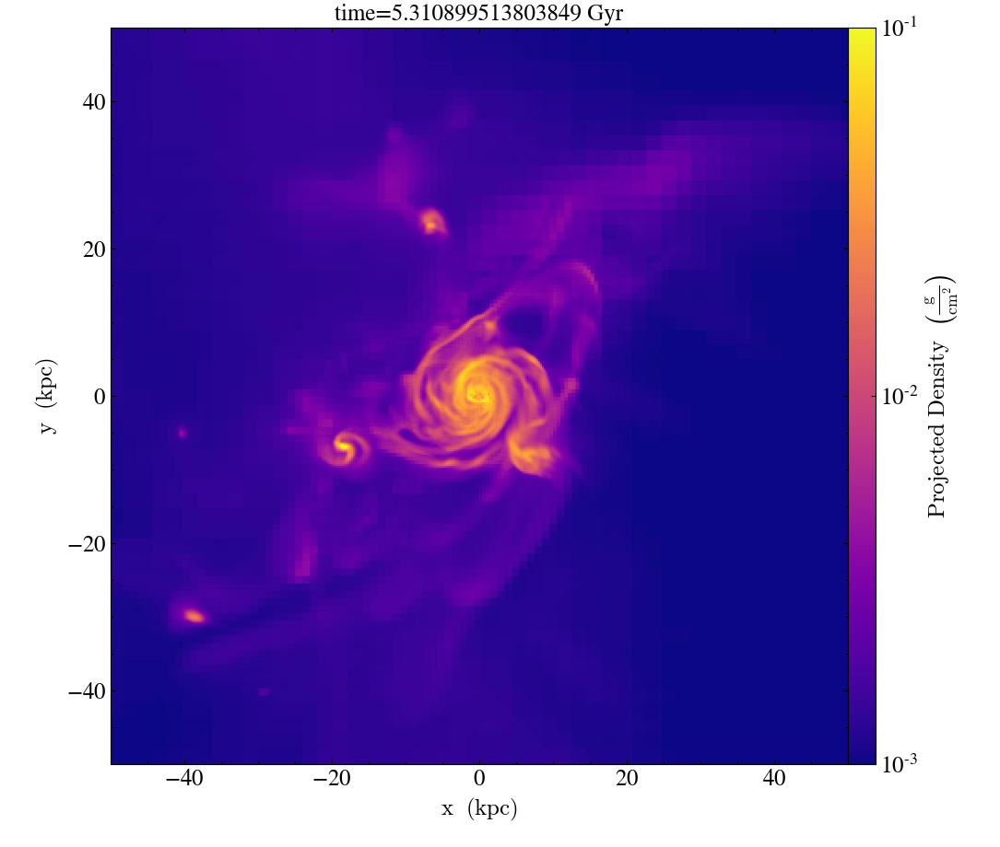

yt : [INFO     ] 2021-11-02 10:04:37,854 Parameters: current_time              = 247.81660281079
yt : [INFO     ] 2021-11-02 10:04:37,855 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:04:37,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:04:37,858 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:04:37,859 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:04:37,860 Parameters: current_redshift          = 1.158504966967
yt : [INFO     ] 2021-11-02 10:04:37,861 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:04:37,862 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:04:37,863 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:04:37,864 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3746/3746 [00:00<00:00, 4318.23it/s] 
yt : [INFO     ] 2021-11-0


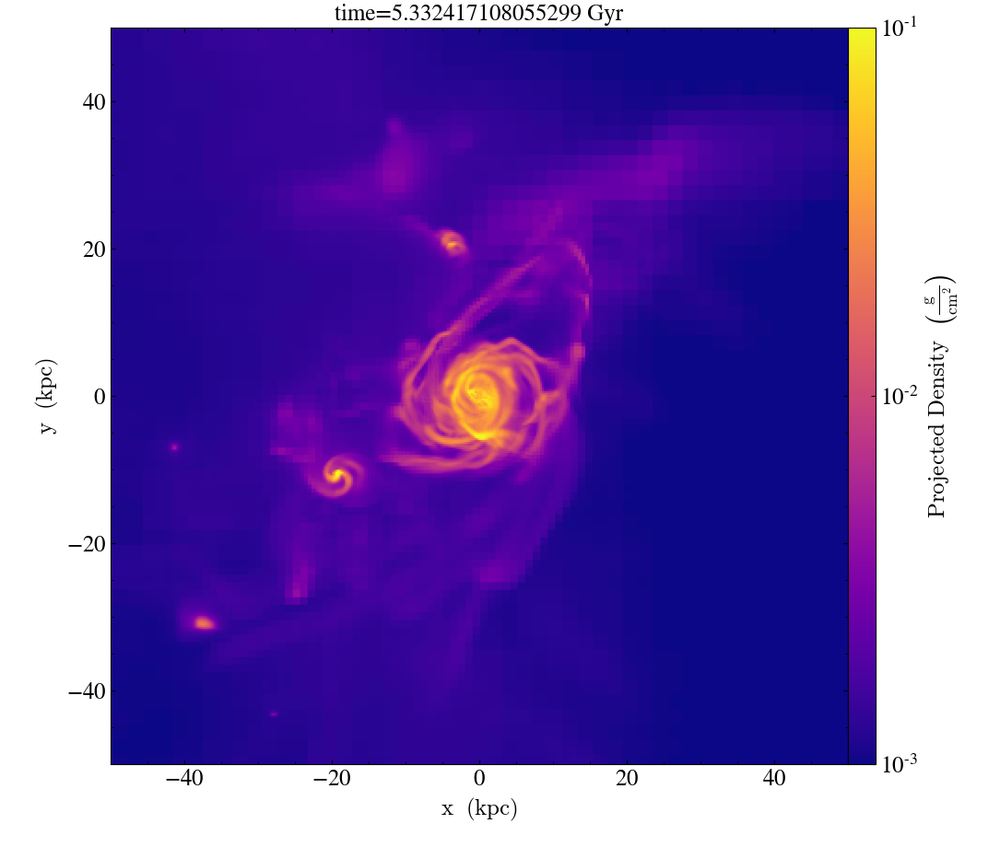

yt : [INFO     ] 2021-11-02 10:05:31,041 Parameters: current_time              = 248.81660281079
yt : [INFO     ] 2021-11-02 10:05:31,043 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:05:31,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:05:31,045 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:05:31,046 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:05:31,048 Parameters: current_redshift          = 1.1522769389638
yt : [INFO     ] 2021-11-02 10:05:31,049 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:05:31,050 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:05:31,051 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:05:31,052 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3687/3687 [00:00<00:00, 5316.32it/s] 
yt : [INFO     ] 2021-11-


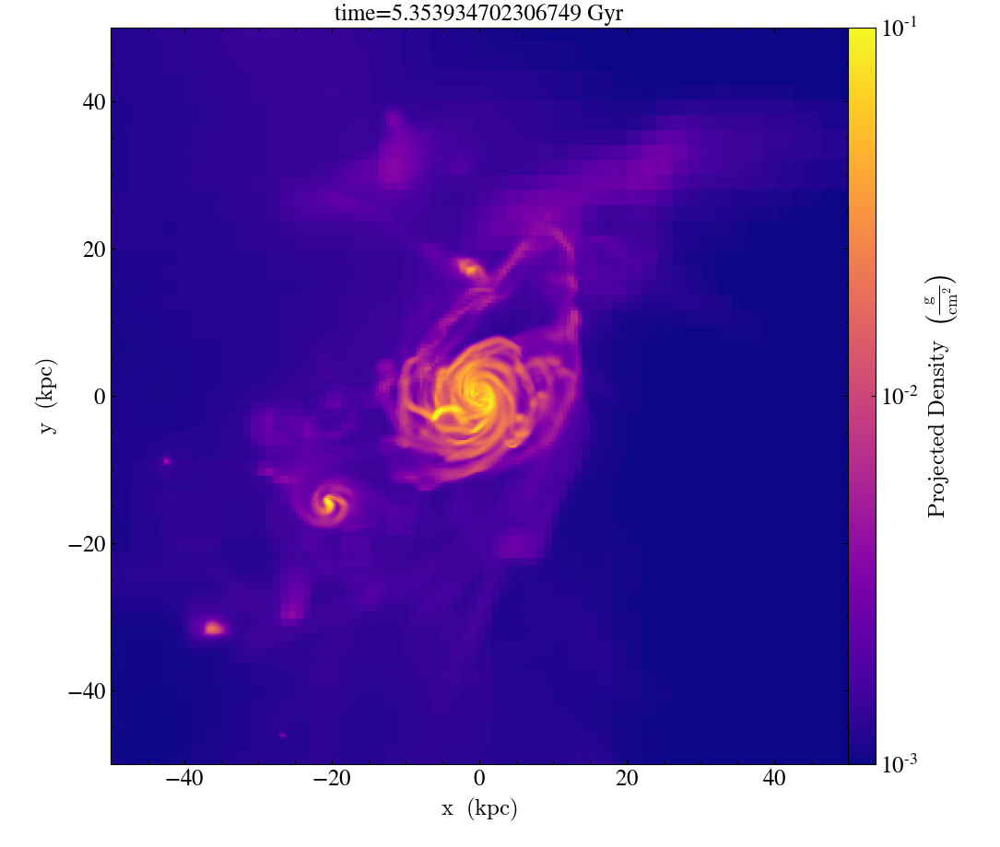

yt : [INFO     ] 2021-11-02 10:06:25,309 Parameters: current_time              = 249.81660281079
yt : [INFO     ] 2021-11-02 10:06:25,311 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:06:25,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:06:25,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:06:25,315 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:06:25,316 Parameters: current_redshift          = 1.146091753523
yt : [INFO     ] 2021-11-02 10:06:25,317 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:06:25,318 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:06:25,319 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:06:25,320 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3645/3645 [00:01<00:00, 3539.29it/s]
yt : [INFO     ] 2021-11-02


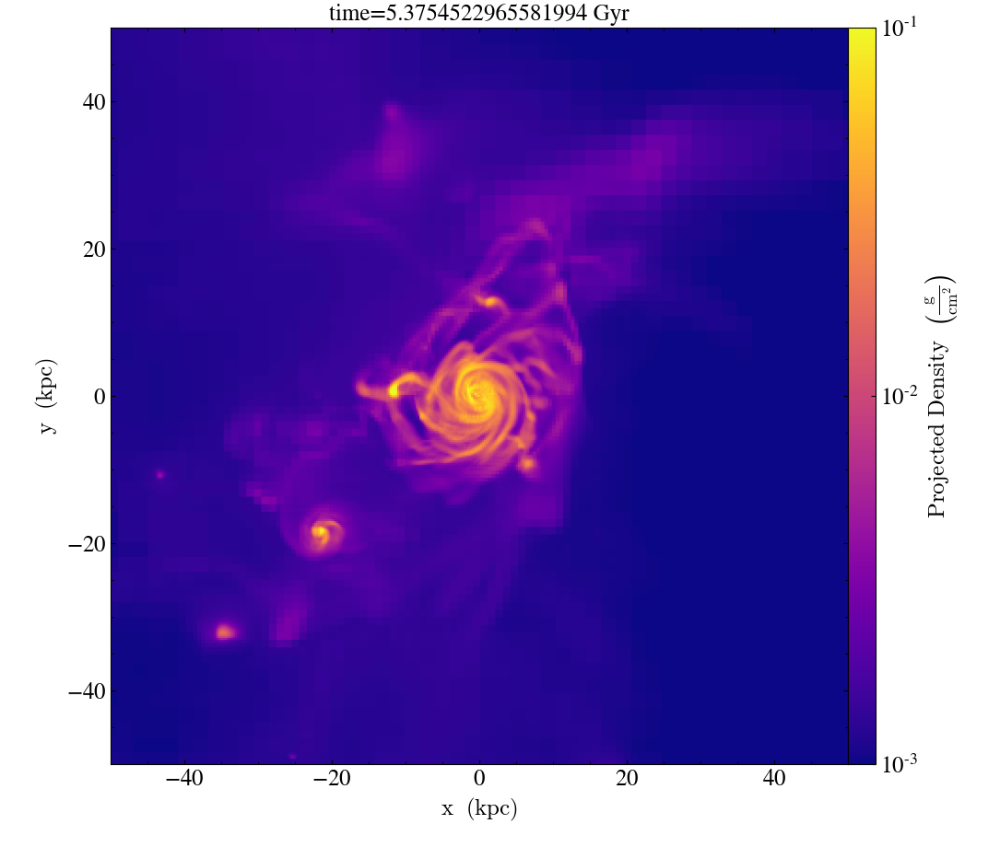

yt : [INFO     ] 2021-11-02 10:07:37,178 Parameters: current_time              = 250.81660281079
yt : [INFO     ] 2021-11-02 10:07:37,180 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:07:37,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:07:37,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:07:37,184 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:07:37,185 Parameters: current_redshift          = 1.1399489461974
yt : [INFO     ] 2021-11-02 10:07:37,186 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:07:37,187 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:07:37,188 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:07:37,189 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3707/3707 [00:00<00:00, 5566.72it/s]
yt : [INFO     ] 2021-11-0


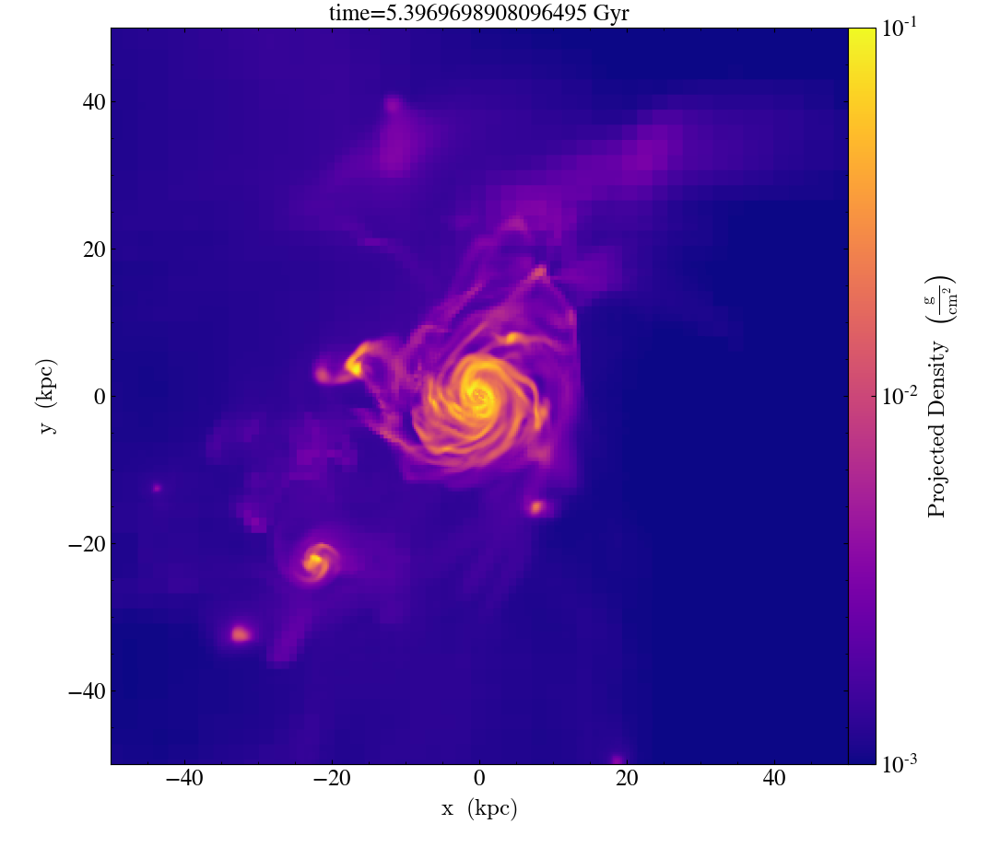

yt : [INFO     ] 2021-11-02 10:08:30,650 Parameters: current_time              = 251.81660281079
yt : [INFO     ] 2021-11-02 10:08:30,652 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:08:30,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:08:30,663 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:08:30,665 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:08:30,666 Parameters: current_redshift          = 1.1338323641692
yt : [INFO     ] 2021-11-02 10:08:30,667 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:08:30,668 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:08:30,669 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:08:30,670 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3673/3673 [00:00<00:00, 5632.57it/s] 
yt : [INFO     ] 2021-11-


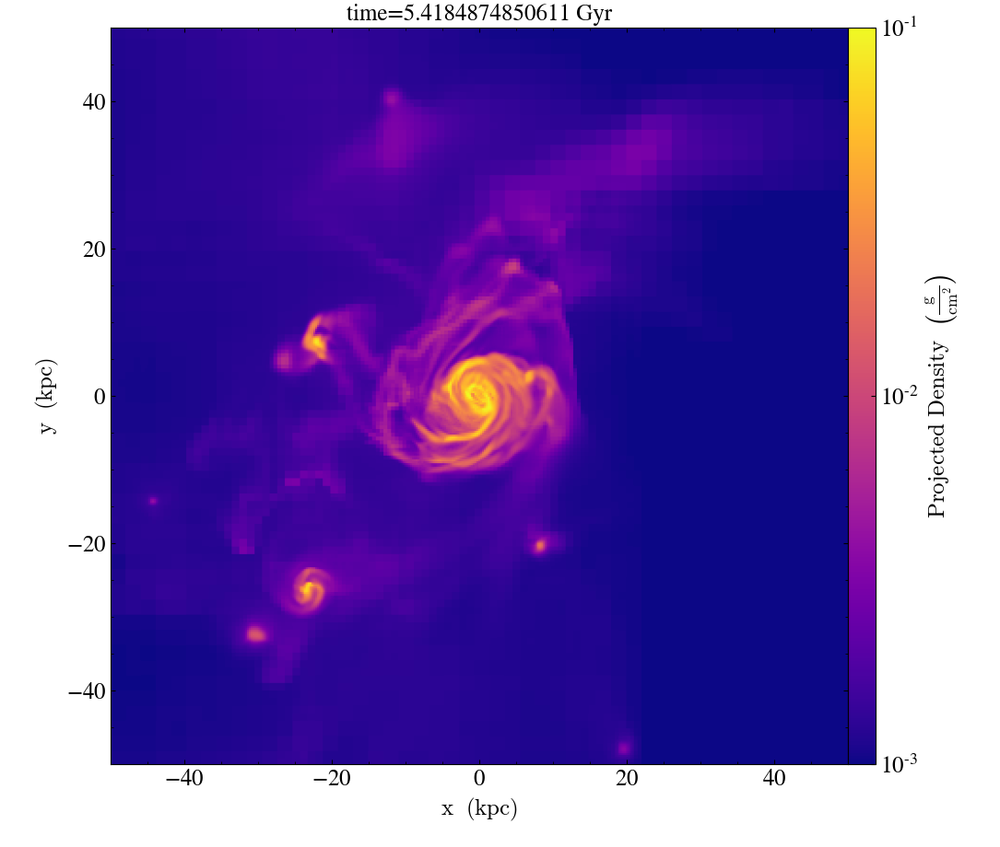

yt : [INFO     ] 2021-11-02 10:09:27,799 Parameters: current_time              = 252.81660281079
yt : [INFO     ] 2021-11-02 10:09:27,801 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:09:27,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:09:27,803 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:09:27,805 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:09:27,806 Parameters: current_redshift          = 1.1277564267526
yt : [INFO     ] 2021-11-02 10:09:27,807 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:09:27,808 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:09:27,809 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:09:27,810 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3727/3727 [00:00<00:00, 3993.91it/s] 
yt : [INFO     ] 2021-11-


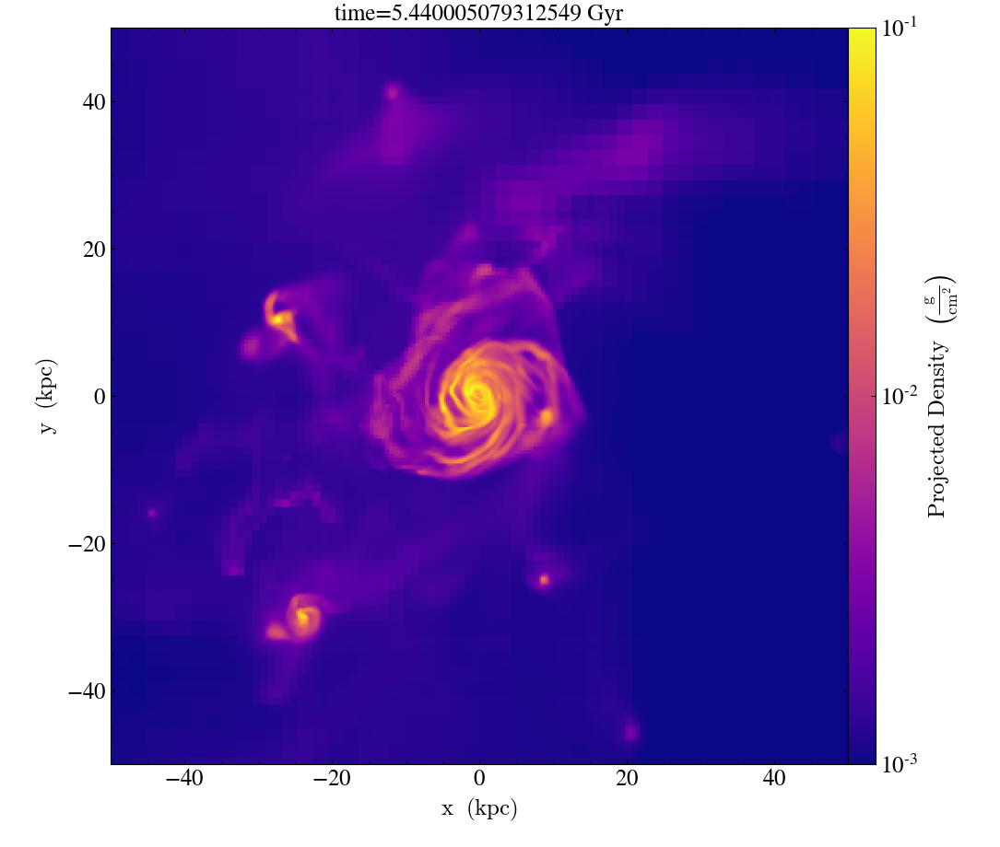

yt : [INFO     ] 2021-11-02 10:10:19,219 Parameters: current_time              = 253.81660281079
yt : [INFO     ] 2021-11-02 10:10:19,221 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:10:19,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:10:19,223 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:10:19,224 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:10:19,226 Parameters: current_redshift          = 1.1217216735032
yt : [INFO     ] 2021-11-02 10:10:19,227 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:10:19,228 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:10:19,229 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:10:19,230 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3721/3721 [00:01<00:00, 3135.08it/s]
yt : [INFO     ] 2021-11-0


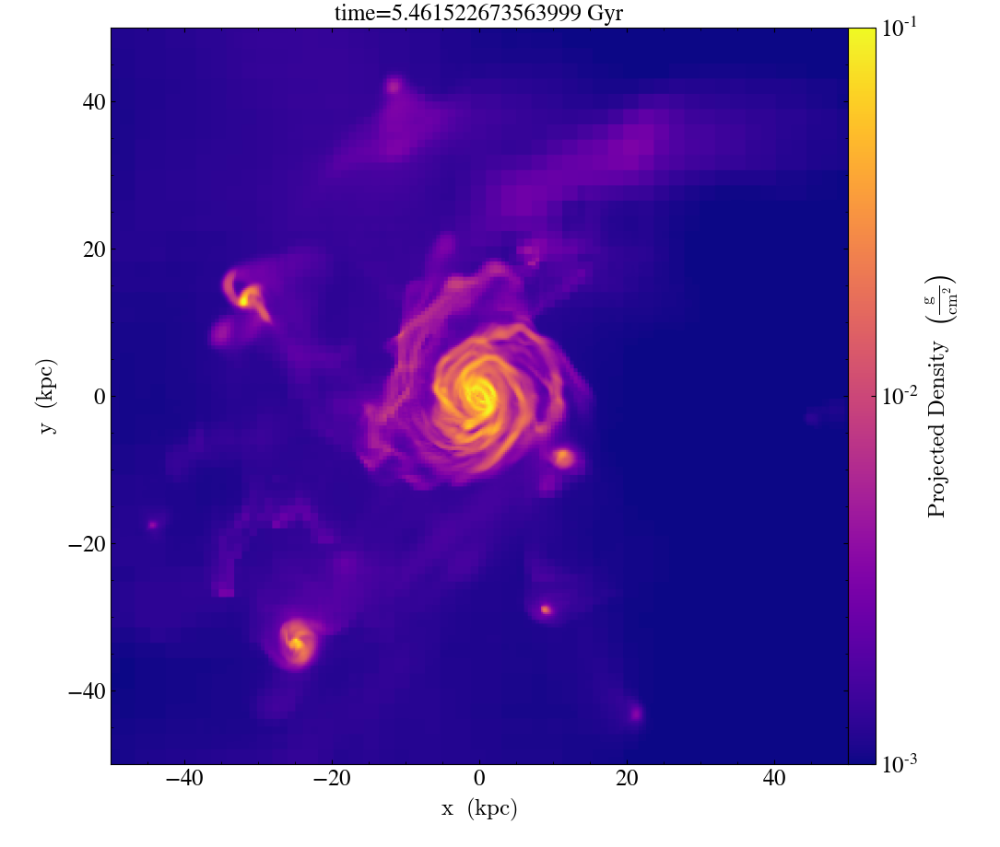

yt : [INFO     ] 2021-11-02 10:11:11,388 Parameters: current_time              = 254.81660281079
yt : [INFO     ] 2021-11-02 10:11:11,389 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:11:11,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:11:11,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:11:11,393 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:11:11,394 Parameters: current_redshift          = 1.1157276646489
yt : [INFO     ] 2021-11-02 10:11:11,395 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:11:11,396 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:11:11,397 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:11:11,399 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3701/3701 [00:00<00:00, 6091.80it/s]
yt : [INFO     ] 2021-11-0


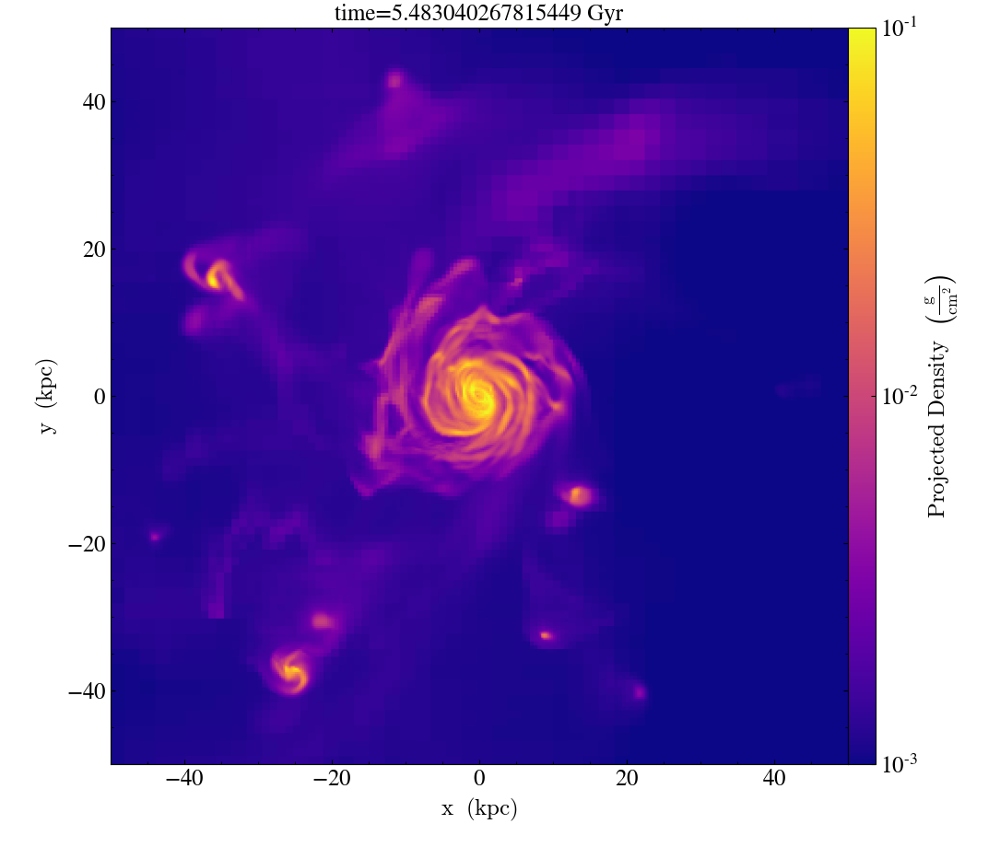

yt : [INFO     ] 2021-11-02 10:12:30,111 Parameters: current_time              = 255.81660281079
yt : [INFO     ] 2021-11-02 10:12:30,113 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:12:30,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:12:30,115 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:12:30,117 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:12:30,118 Parameters: current_redshift          = 1.1097727533079
yt : [INFO     ] 2021-11-02 10:12:30,119 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:12:30,120 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:12:30,121 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:12:30,122 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3750/3750 [00:00<00:00, 5635.17it/s] 
yt : [INFO     ] 2021-11-


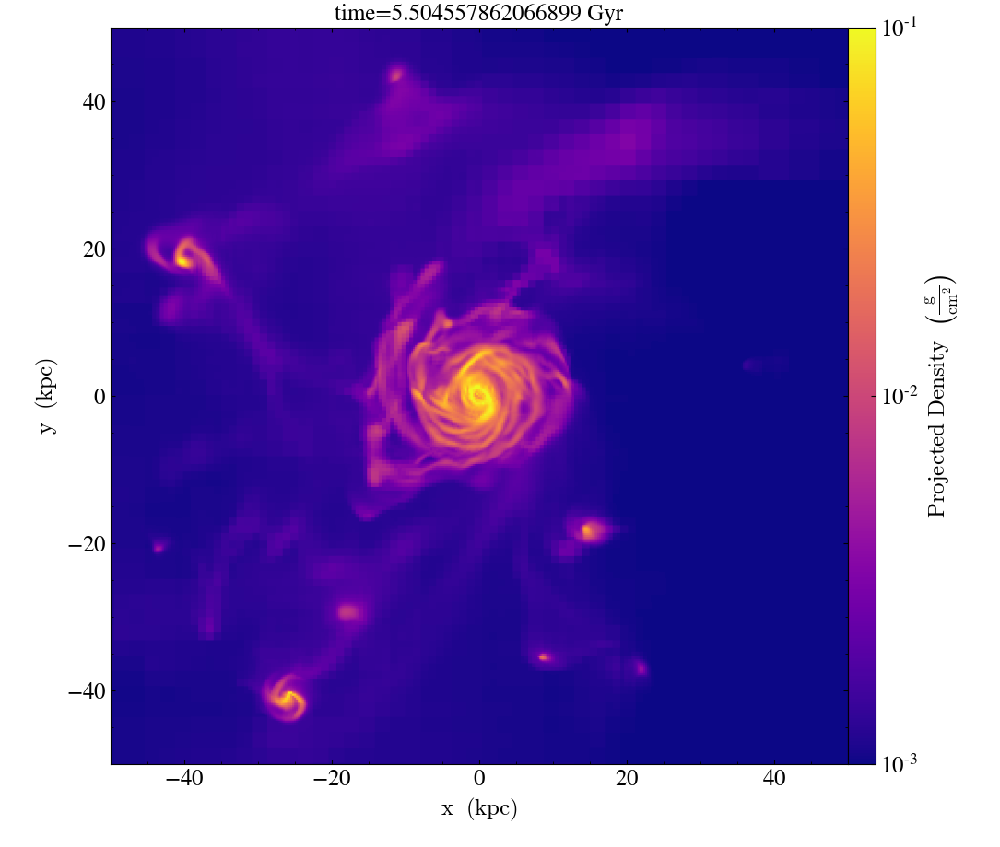

yt : [INFO     ] 2021-11-02 10:13:25,518 Parameters: current_time              = 256.81660281079
yt : [INFO     ] 2021-11-02 10:13:25,520 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:13:25,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:13:25,522 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:13:25,524 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:13:25,525 Parameters: current_redshift          = 1.103842254268
yt : [INFO     ] 2021-11-02 10:13:25,526 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:13:25,527 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:13:25,528 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:13:25,529 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3734/3734 [00:00<00:00, 3787.88it/s]
yt : [INFO     ] 2021-11-02


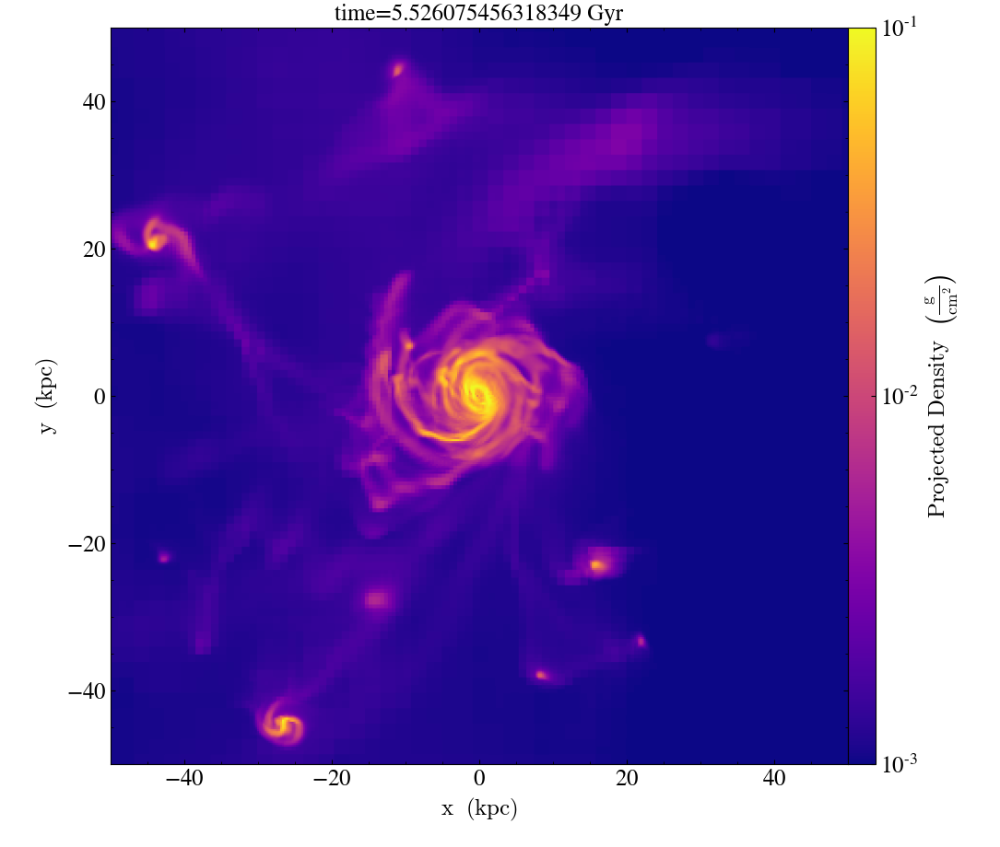

yt : [INFO     ] 2021-11-02 10:14:17,018 Parameters: current_time              = 257.81653765639
yt : [INFO     ] 2021-11-02 10:14:17,020 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:14:17,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:14:17,022 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:14:17,024 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:14:17,025 Parameters: current_redshift          = 1.097951758738
yt : [INFO     ] 2021-11-02 10:14:17,026 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:14:17,027 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:14:17,028 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:14:17,029 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3743/3743 [00:01<00:00, 3148.96it/s]
yt : [INFO     ] 2021-11-02


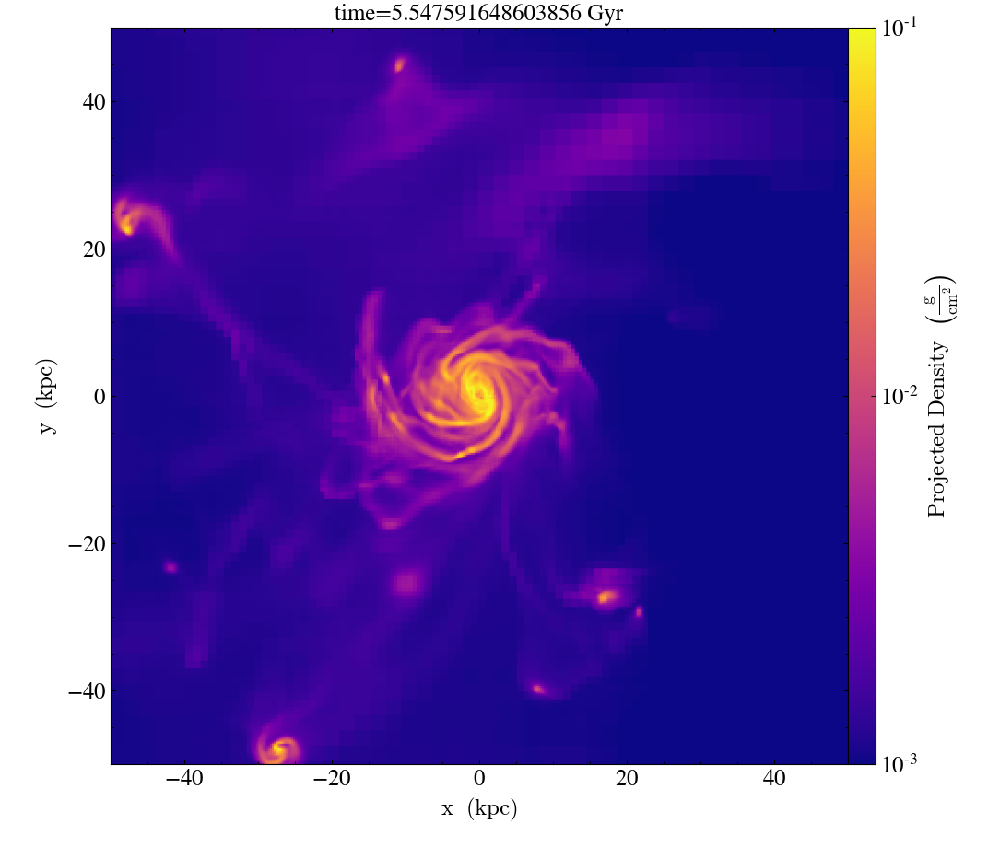

yt : [INFO     ] 2021-11-02 10:15:13,034 Parameters: current_time              = 258.81660281731
yt : [INFO     ] 2021-11-02 10:15:13,036 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:15:13,037 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:15:13,038 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:15:13,039 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:15:13,040 Parameters: current_redshift          = 1.0920997022269
yt : [INFO     ] 2021-11-02 10:15:13,042 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:15:13,043 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:15:13,044 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:15:13,045 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3754/3754 [00:00<00:00, 4466.37it/s]
yt : [INFO     ] 2021-11-0


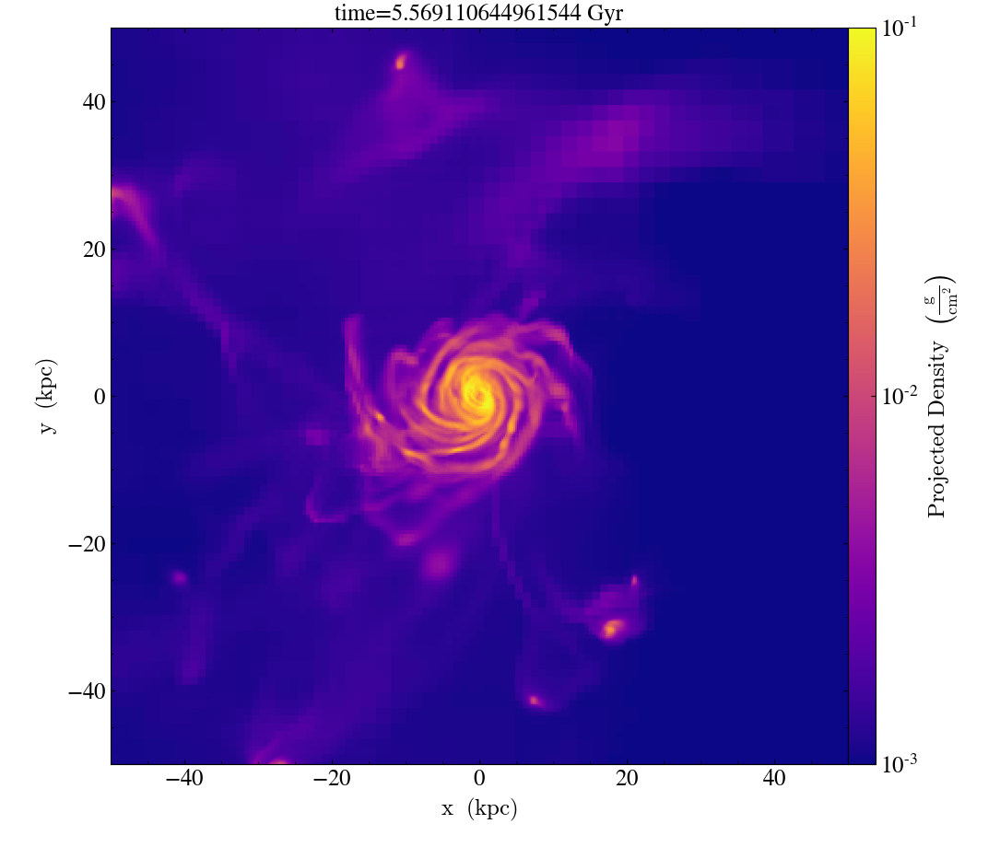

yt : [INFO     ] 2021-11-02 10:16:03,917 Parameters: current_time              = 259.81660281079
yt : [INFO     ] 2021-11-02 10:16:03,919 Parameters: domain_dimensions         = [256 256 256]
yt : [INFO     ] 2021-11-02 10:16:03,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2021-11-02 10:16:03,921 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2021-11-02 10:16:03,922 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2021-11-02 10:16:03,923 Parameters: current_redshift          = 1.0862868215803
yt : [INFO     ] 2021-11-02 10:16:03,925 Parameters: omega_lambda              = 0.715
yt : [INFO     ] 2021-11-02 10:16:03,926 Parameters: omega_matter              = 0.285
yt : [INFO     ] 2021-11-02 10:16:03,927 Parameters: omega_radiation           = 0
yt : [INFO     ] 2021-11-02 10:16:03,928 Parameters: hubble_constant           = 0.695
Parsing Hierarchy : 100%|██████████| 3777/3777 [00:00<00:00, 5386.73it/s] 
yt : [INFO     ] 2021-11-


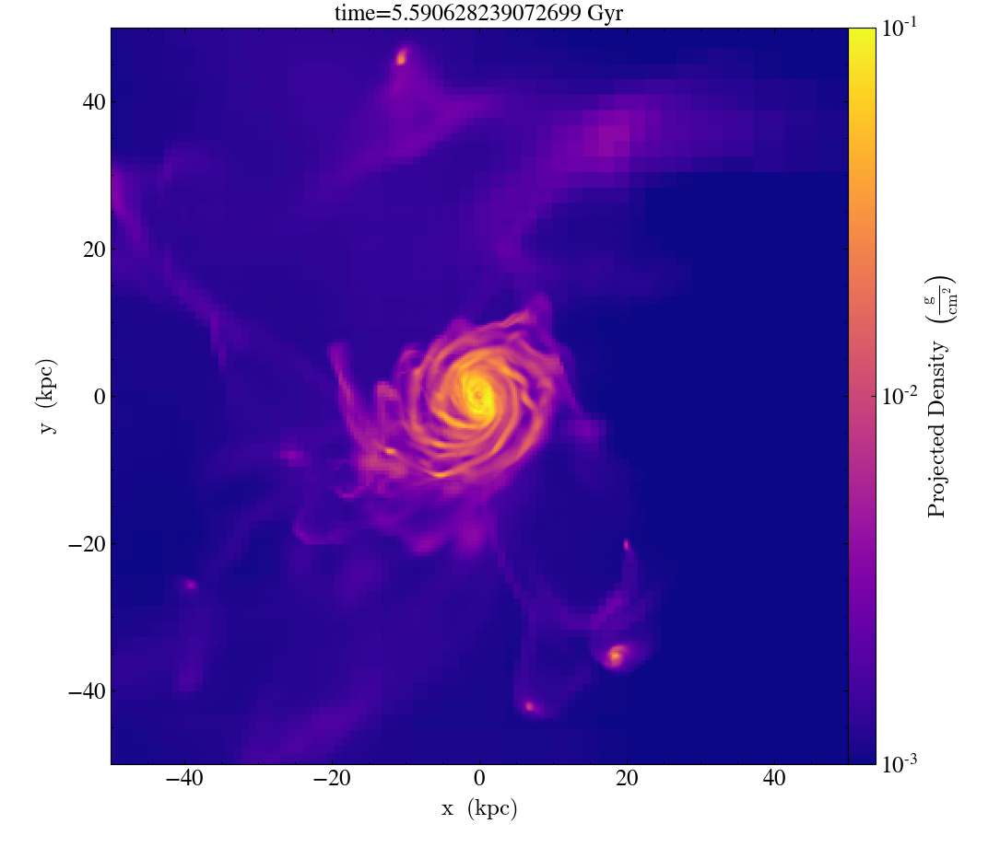

In [17]:
import yt
from yt.analysis_modules.halo_analysis.api import HaloCatalog
from yt.analysis_modules.halo_finding.api import HOPHaloFinder
from yt.data_objects.particle_filters import add_particle_filter

def dark_matter(pfilter, data):
    filter = (data["DarkMatter", "particle_type"] == 1)
    return filter
add_particle_filter("dark_matter", function=dark_matter, filtered_type='DarkMatter',
                    requires=["particle_type"])
for n in range(200,260):
    fn='%04d'%n
    fd='/DD'+str(fn)
    ff='/DD'+str(fn)
    fpath = '/mnt/scratch/deovratd/Cosmological/eff_3-e3'+fd+ff
    data_ds = yt.load(fpath)
    data_ds.add_particle_filter('dark_matter')
    ad = data_ds.all_data() 
    time = data_ds.current_time.in_units('Gyr') 
    prj = yt.ProjectionPlot(data_ds, "z", "density",center=("max","Dark_Matter_Density"), width=(100,'kpc'))
    #prj = yt.ProjectionPlot(data_ds, "z", "density",center=([0.5078220367431642,0.5084171295166016,0.4893665313720703]), width=(100,'kpc'))
    colorbar = prj.set_cmap(field='density', cmap='plasma')
    prj.set_zlim('density', 1.0e-3,1.0e-1)
    #prj.hide_colorbar()
    #prj.hide_axes()
    #prj.set_zlim('entropy', 1.0e-2,1.0e4)
    #prj.annotate_title("Narrow AGN JET")
    prj.annotate_title("time="+str(time))
    prj.save("/mnt/scratch/deovratd/Cosmological/eff_3-e3/zax_"+str(fn))
    prj.show()

yt : [INFO     ] 2020-01-22 21:30:52,684 Max Value is 5.41915e+08 at 0.5109844207763672 0.5147457122802735 0.4841022491455079
yt : [INFO     ] 2020-01-22 21:31:26,936 Projection completed
yt : [INFO     ] 2020-01-22 21:31:26,938 xlim = 0.513856 0.515634
yt : [INFO     ] 2020-01-22 21:31:26,940 ylim = 0.483213 0.484991
yt : [INFO     ] 2020-01-22 21:31:26,942 xlim = 0.513856 0.515634
yt : [INFO     ] 2020-01-22 21:31:26,944 ylim = 0.483213 0.484991
yt : [INFO     ] 2020-01-22 21:31:26,946 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800



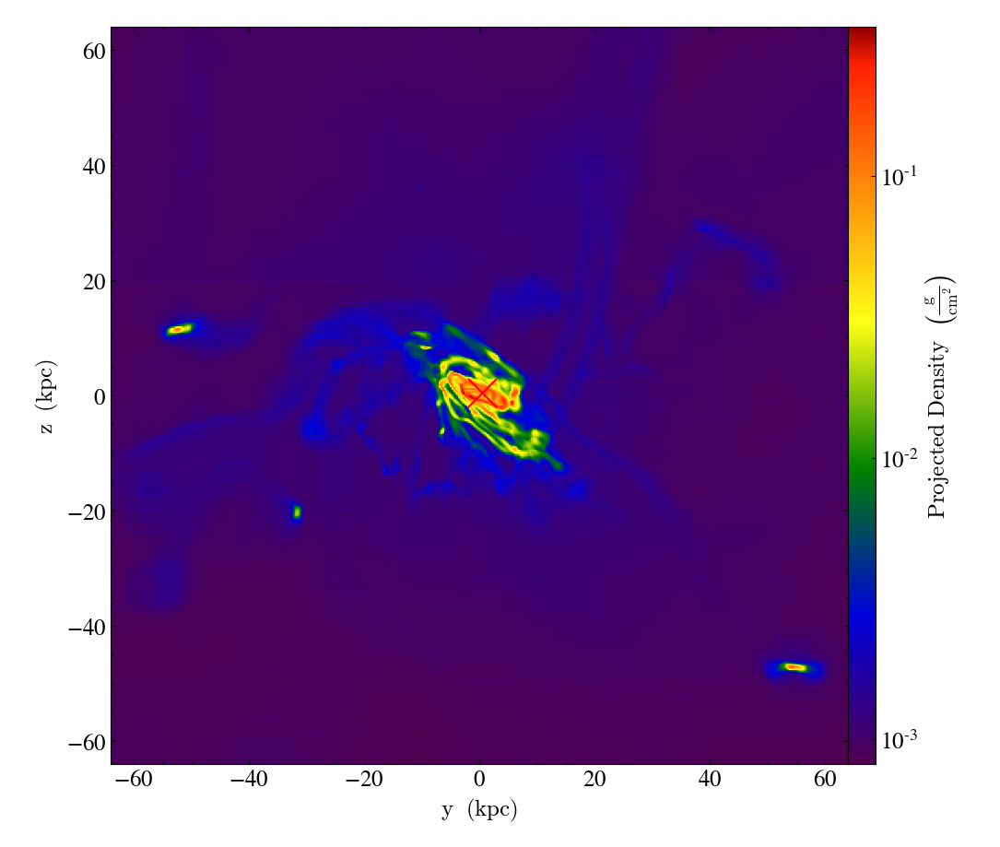

In [28]:
d, c = data_ds.find_max("Dark_Matter_Density")
prj = yt.ProjectionPlot(data_ds, "x", "density", center==("max","Dark_Matter_Density"), width=(100,'kpc'))    
colorbar = prj.set_cmap(field='density', cmap='bds_highcontrast')
#prj.annotate_particles((10,'kpc'))
#prj.annotate_marker((c[1],c[2]), coord_system='plot',
#                  plot_args={'color':'red','s':500})
prj.hide_colorbar()
prj.hide_axes()
prj.show()

yt : [INFO     ] 2020-01-07 16:39:29,346 Projection completed
yt : [INFO     ] 2020-01-07 16:39:29,349 xlim = 0.510290 0.511678
yt : [INFO     ] 2020-01-07 16:39:29,351 ylim = 0.514051 0.515439
yt : [INFO     ] 2020-01-07 16:39:29,353 xlim = 0.510290 0.511678
yt : [INFO     ] 2020-01-07 16:39:29,355 ylim = 0.514051 0.515439
yt : [INFO     ] 2020-01-07 16:39:29,358 Making a fixed resolution buffer of (('enzo', 'Dark_Matter_Density')) 800 by 800



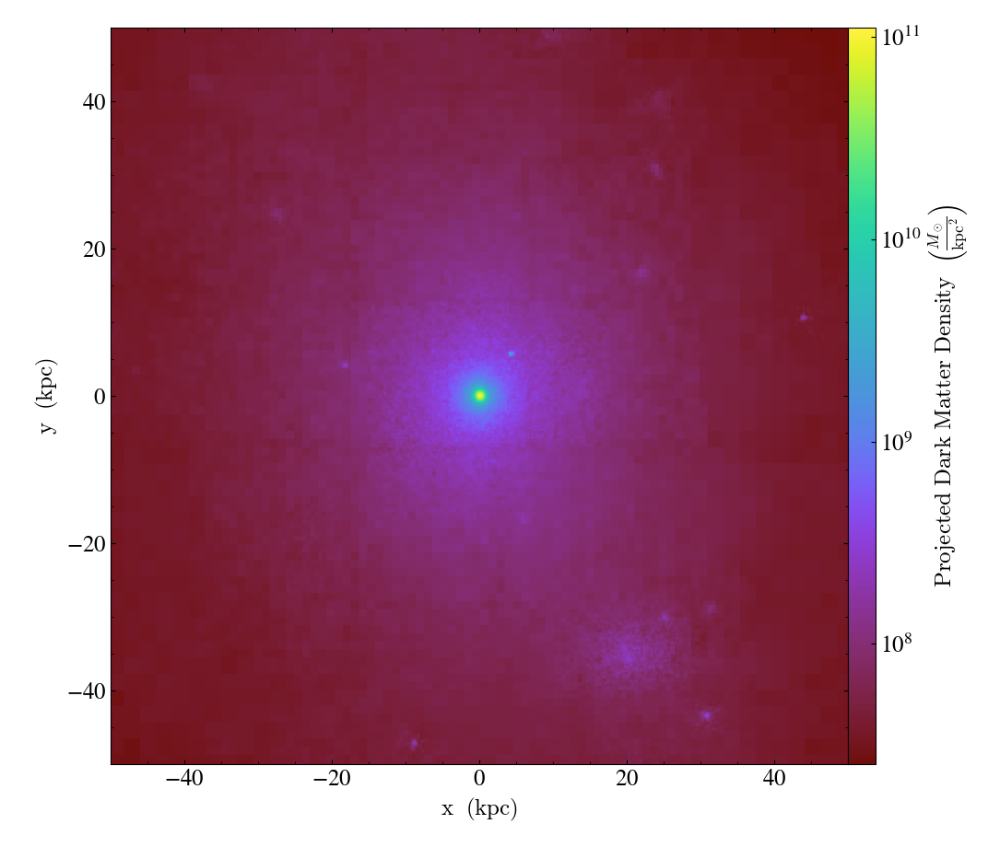

In [69]:
p = yt.ProjectionPlot(data_ds,'x','Dark_Matter_Density', width=(100, 'kpc'), center=[0.510984,0.514745,0.484102])
p.set_unit('Dark_Matter_Density', 'Msun/kpc**2')
p.show()

yt : [INFO     ] 2020-01-07 16:23:07,207 xlim = 0.510290 0.511678
yt : [INFO     ] 2020-01-07 16:23:07,208 ylim = 0.514051 0.515439
yt : [INFO     ] 2020-01-07 16:23:07,210 xlim = 0.510290 0.511678
yt : [INFO     ] 2020-01-07 16:23:07,211 ylim = 0.514051 0.515439
yt : [INFO     ] 2020-01-07 16:23:07,213 Splatting (('stars', 'particle_mass')) onto a 800 by 800 mesh
/mnt/home/deovratd/yt_cos_ap/lib/python3.7/site-packages/matplotlib/colors.py:1110: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0



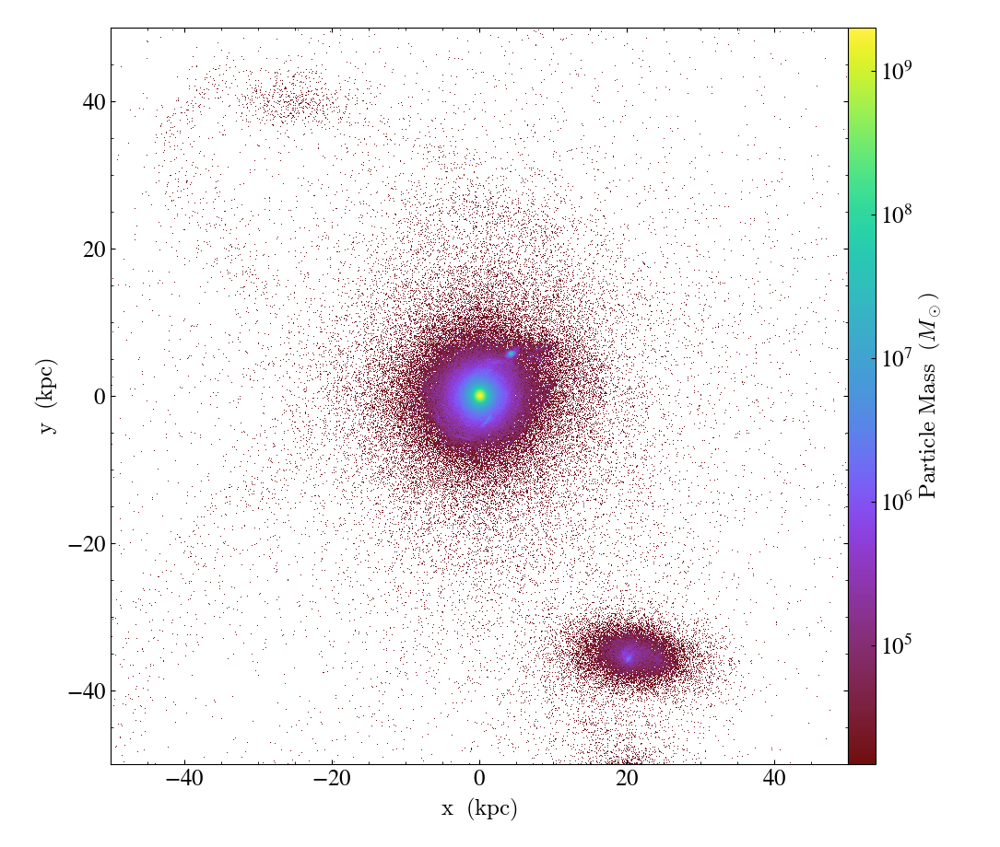

In [64]:
p = yt.ParticleProjectionPlot(data_ds,'x',[('stars','particle_mass')], width=(100, 'kpc'), center=[0.510984,0.514745,0.484102])
#colorbar = prj.set_cmap(field='density', cmap='bds_highcontrast')
p.set_unit([('stars','particle_mass')], 'Msun')
p.show()

In [18]:
d, c = data_ds.find_max("Dark_Matter_Density")

yt : [INFO     ] 2020-01-07 14:09:16,929 Max Value is 5.41716e+08 at 0.5109844207763672 0.5147457122802735 0.4841022491455079


In [ ]:
halos = HOPHaloFinder(data_ds, dm_only=False, ptype='DarkMatter')

Parsing Hierarchy : 100%|██████████| 3770/3770 [00:00<00:00, 5269.47it/s]
yt : [INFO     ] 2020-01-06 15:14:03,159 Gathering a field list (this may take a moment.)


> /mnt/home/deovratd/yt_ap/yt/frontends/enzo/data_structures.py(397)_detect_active_particle_fields()
-> self.io._array_fields[field] = (sh[1], )
(Pdb) print(node)
<HDF5 group "/Grid00002230/ActiveParticles" (1 members)>
(Pdb) print(ptype)
AGNParticle
(Pdb) print(self)
(Pdb) print(self.dataset["AppendActiveParticleType"])
['AGNParticle', 'DarkMatter']


In [8]:
hc = HaloCatalog(data_ds=data_ds, finder_method='hop')
hc.create()

yt : [INFO     ] 2019-10-09 10:25:34,467 Max Value is 5.41914e+08 at 0.5109844207763672 0.5147457122802735 0.4841022491455079
yt : [INFO     ] 2019-10-09 10:25:41,977 Projection completed
yt : [INFO     ] 2019-10-09 10:25:42,141 xlim = 0.372140 0.649829
yt : [INFO     ] 2019-10-09 10:25:42,142 ylim = 0.375901 0.653590
yt : [INFO     ] 2019-10-09 10:25:42,143 xlim = 0.372140 0.649829
yt : [INFO     ] 2019-10-09 10:25:42,144 ylim = 0.375901 0.653590
yt : [INFO     ] 2019-10-09 10:25:42,180 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800



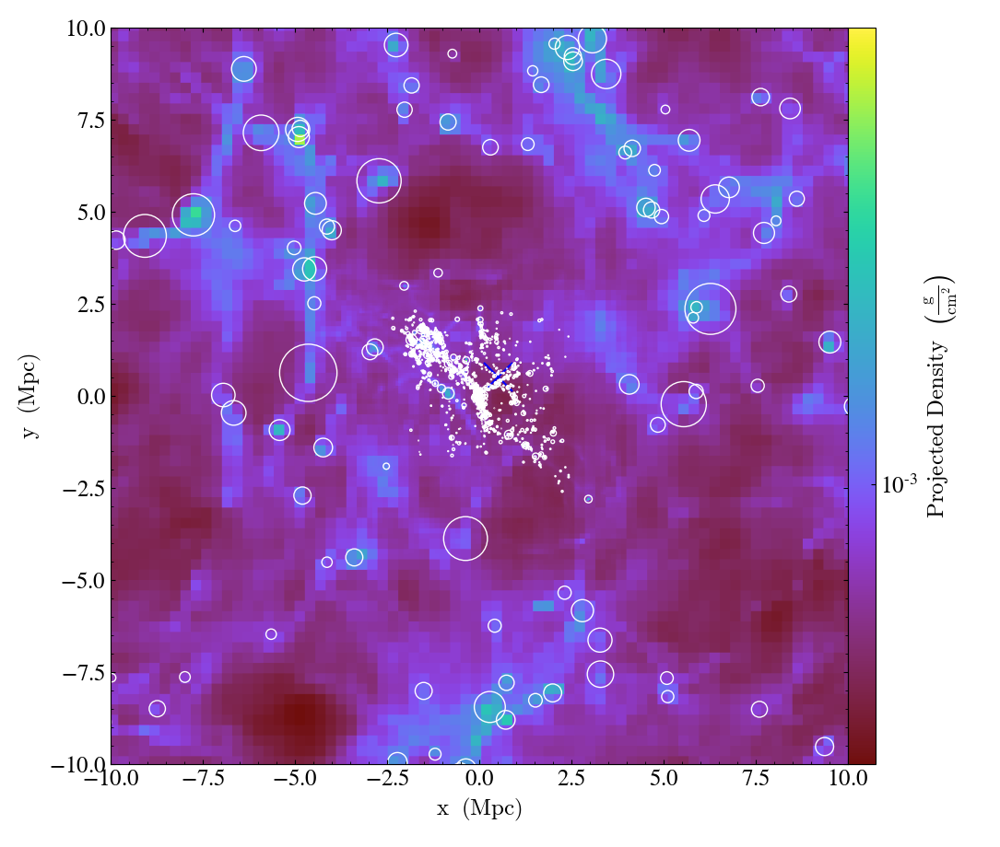

In [4]:
d, c = data_ds.find_max("Dark_Matter_Density")
prj = yt.ProjectionPlot(data_ds, 'z', 'density',center=[c[0],c[1],c[2]], width=(20,'Mpc'))
prj.annotate_halos(hc)
prj.annotate_marker((c[0],c[1]), coord_system='plot',
                  plot_args={'color':'blue','s':500})
prj.show()

yt : [INFO     ] 2019-10-09 10:26:00,645 Max Value is 1.37435e-22 at 0.5109615325927734 0.5147457122802735 0.4840908050537109
yt : [INFO     ] 2019-10-09 10:26:07,797 Projection completed
yt : [INFO     ] 2019-10-09 10:26:07,799 xlim = 0.372117 0.649806
yt : [INFO     ] 2019-10-09 10:26:07,801 ylim = 0.375901 0.653590
yt : [INFO     ] 2019-10-09 10:26:07,803 xlim = 0.372117 0.649806
yt : [INFO     ] 2019-10-09 10:26:07,805 ylim = 0.375901 0.653590
yt : [INFO     ] 2019-10-09 10:26:07,807 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800



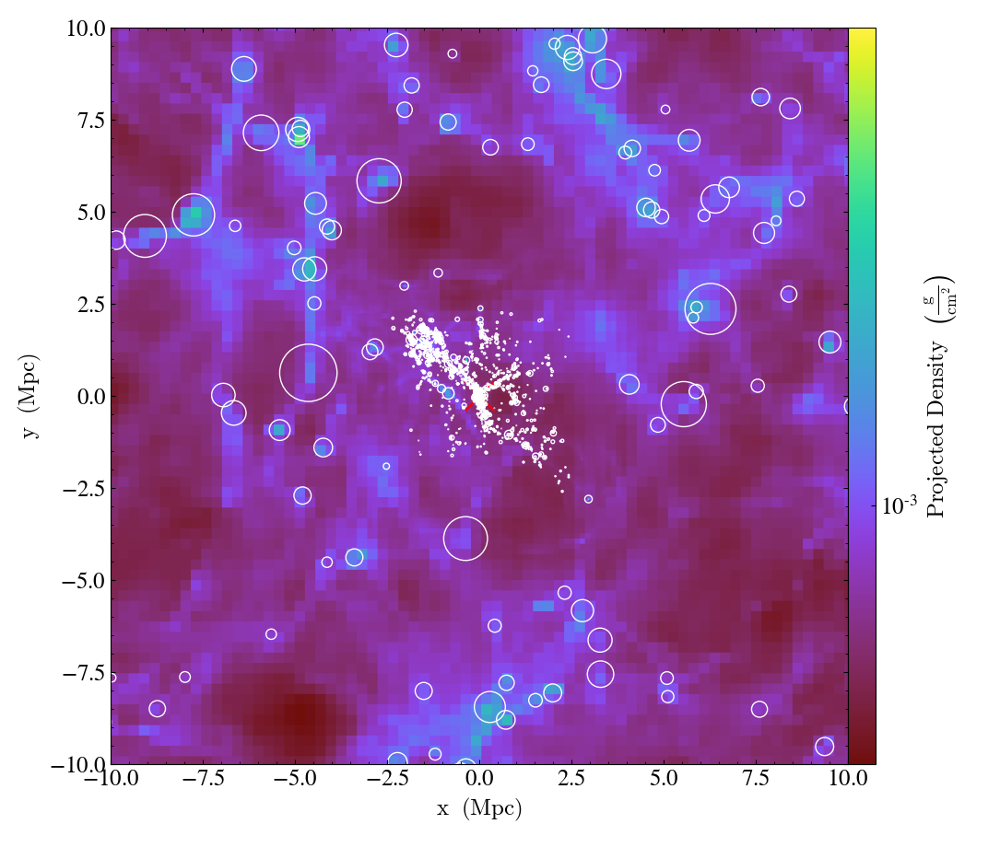

In [5]:
d1, c1 = data_ds.find_max("density")
prj = yt.ProjectionPlot(data_ds, 'z', 'density',center=[c1[0],c1[1],c1[2]], width=(20,'Mpc'))
prj.annotate_halos(hc)
prj.annotate_marker((c1[0],c1[1],c1[2]), coord_system='data',
                  plot_args={'color':'red','s':500})
prj.show()

yt : [INFO     ] 2019-10-09 10:28:24,025 Max Value is 1.37435e-22 at 0.5109615325927734 0.5147457122802735 0.4840908050537109
yt : [INFO     ] 2019-10-09 10:28:31,976 Projection completed
yt : [INFO     ] 2019-10-09 10:28:31,979 xlim = 0.510267 0.511656
yt : [INFO     ] 2019-10-09 10:28:31,981 ylim = 0.514051 0.515440
yt : [INFO     ] 2019-10-09 10:28:31,983 xlim = 0.510267 0.511656
yt : [INFO     ] 2019-10-09 10:28:31,985 ylim = 0.514051 0.515440
yt : [INFO     ] 2019-10-09 10:28:31,987 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800



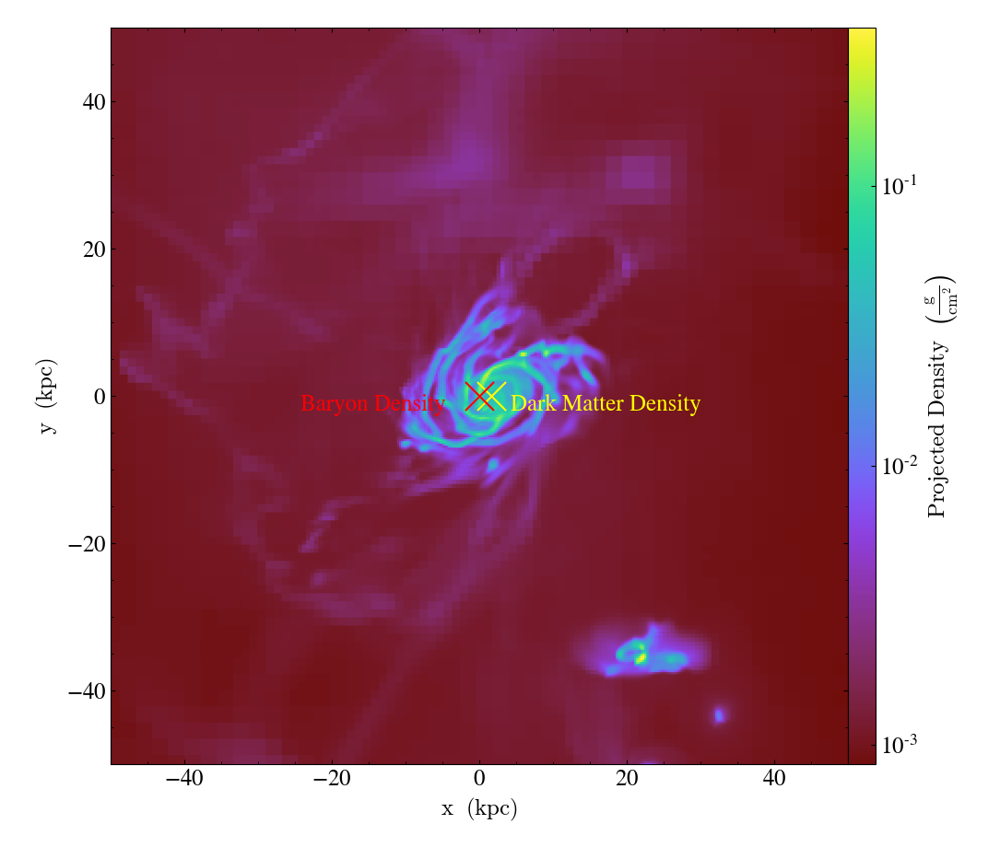

In [6]:
d1, c1 = data_ds.find_max("density")
prj = yt.ProjectionPlot(data_ds, 'z', 'density',center=[c1[0],c1[1],c1[2]], width=(100,'kpc'))
#prj.annotate_halos(hc)
prj.annotate_marker((c[0],c[1],c[2]), coord_system='data',
                  plot_args={'color':'yellow','s':500})
prj.annotate_marker((c1[0],c1[1],c1[2]), coord_system='data',
                  plot_args={'color':'red','s':500})
prj.annotate_text((c[0], c[1]), 'Dark Matter Density', coord_system='figure',
                text_args={'color':'yellow'})
prj.annotate_text((0.3, c1[1]), 'Baryon Density', coord_system='figure',
                text_args={'color':'red'})
prj.show()

yt : [INFO     ] 2019-10-09 10:29:47,585 Max Value is 1.37435e-22 at 0.5109615325927734 0.5147457122802735 0.4840908050537109
yt : [INFO     ] 2019-10-09 10:29:55,111 Projection completed
yt : [INFO     ] 2019-10-09 10:29:55,113 xlim = 0.514051 0.515440
yt : [INFO     ] 2019-10-09 10:29:55,115 ylim = 0.483397 0.484785
yt : [INFO     ] 2019-10-09 10:29:55,117 xlim = 0.514051 0.515440
yt : [INFO     ] 2019-10-09 10:29:55,118 ylim = 0.483397 0.484785
yt : [INFO     ] 2019-10-09 10:29:55,121 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800



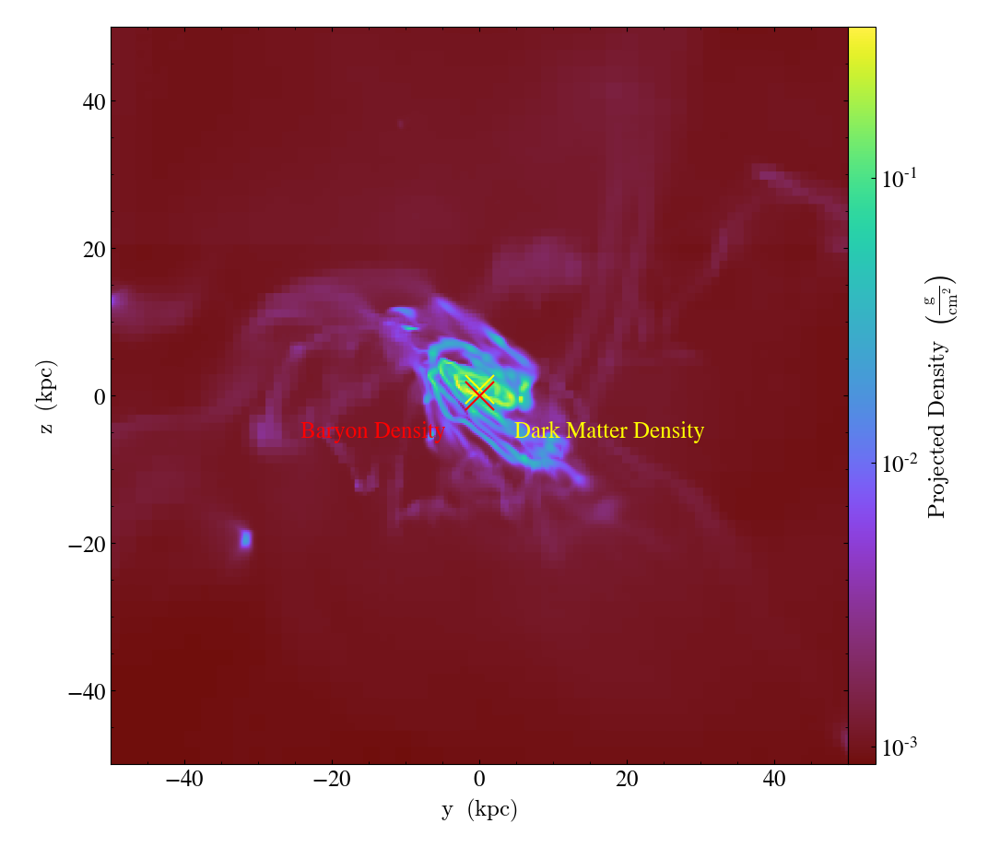

In [8]:
d1, c1 = data_ds.find_max("density")
prj = yt.ProjectionPlot(data_ds, 'x', 'density',center=[c1[0],c1[1],c1[2]], width=(100,'kpc'))
#prj.annotate_halos(hc)
prj.annotate_marker((c[0],c[1],c[2]), coord_system='data',
                  plot_args={'color':'yellow','s':500})
prj.annotate_marker((c1[0],c1[1],c1[2]), coord_system='data',
                  plot_args={'color':'red','s':500})
prj.annotate_text((c[1], c[2]), 'Dark Matter Density', coord_system='figure',
                text_args={'color':'yellow'})
prj.annotate_text((0.3, c1[2]), 'Baryon Density', coord_system='figure',
                text_args={'color':'red'})
prj.show()

yt : [INFO     ] 2019-10-09 10:30:43,064 Max Value is 1.37435e-22 at 0.5109615325927734 0.5147457122802735 0.4840908050537109
yt : [INFO     ] 2019-10-09 10:30:50,587 Projection completed
yt : [INFO     ] 2019-10-09 10:30:50,589 xlim = 0.483397 0.484785
yt : [INFO     ] 2019-10-09 10:30:50,591 ylim = 0.510267 0.511656
yt : [INFO     ] 2019-10-09 10:30:50,593 xlim = 0.483397 0.484785
yt : [INFO     ] 2019-10-09 10:30:50,595 ylim = 0.510267 0.511656
yt : [INFO     ] 2019-10-09 10:30:50,597 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800



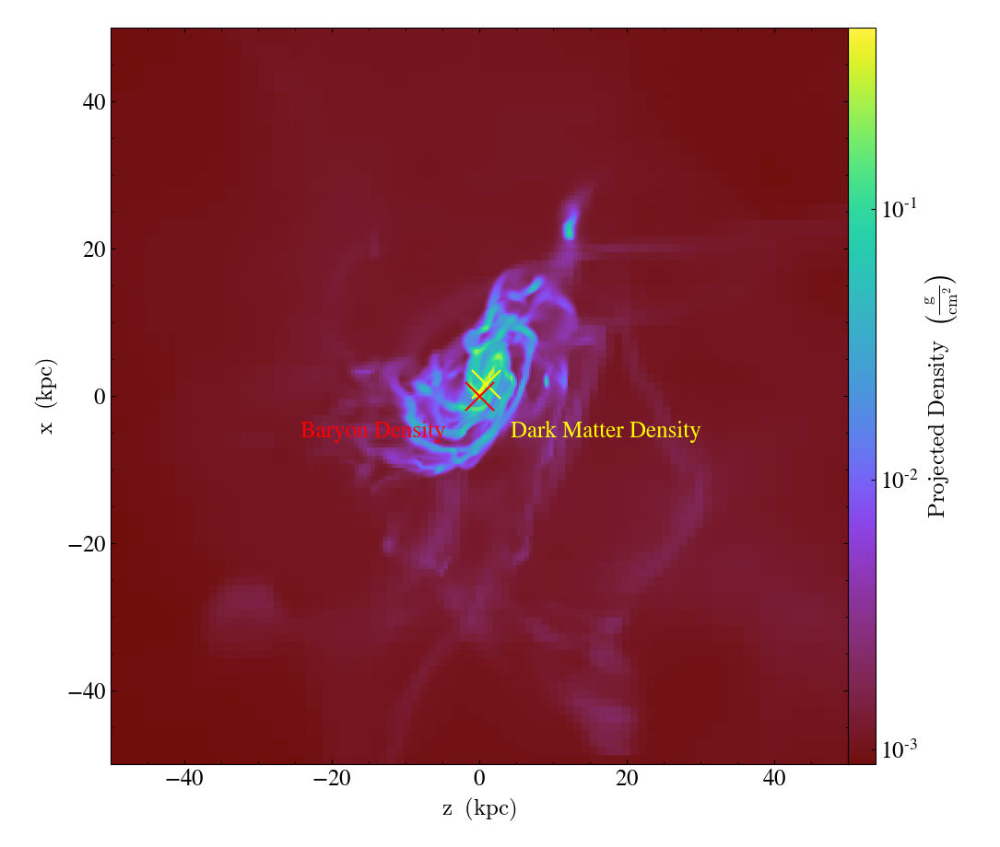

In [9]:
d1, c1 = data_ds.find_max("density")
prj = yt.ProjectionPlot(data_ds, 'y', 'density',center=[c1[0],c1[1],c1[2]], width=(100,'kpc'))
#prj.annotate_halos(hc)
prj.annotate_marker((c[0],c[1],c[2]), coord_system='data',
                  plot_args={'color':'yellow','s':500})
prj.annotate_marker((c1[0],c1[1],c1[2]), coord_system='data',
                  plot_args={'color':'red','s':500})
prj.annotate_text((c[0], c[2]), 'Dark Matter Density', coord_system='figure',
                text_args={'color':'yellow'})
prj.annotate_text((0.3, c1[2]), 'Baryon Density', coord_system='figure',
                text_args={'color':'red'})
prj.show()

In [18]:
pm = hc.add_quantity('center_of_mass')

In [23]:
import numpy as np
np.size(pm)

1

yt : [INFO     ] 2019-10-07 16:54:05,468 Max Value is 1.13075e+43 at 0.0019531250000000 0.0019531250000000 0.0019531250000000
yt : [INFO     ] 2019-10-07 16:54:14,992 Projection completed
yt : [INFO     ] 2019-10-07 16:54:14,995 xlim = -0.136891 0.140798
yt : [INFO     ] 2019-10-07 16:54:14,996 ylim = -0.136891 0.140798
yt : [INFO     ] 2019-10-07 16:54:14,998 xlim = -0.136891 0.140798
yt : [INFO     ] 2019-10-07 16:54:15,000 ylim = -0.136891 0.140798
yt : [INFO     ] 2019-10-07 16:54:15,002 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800
yt : [WARNING  ] 2019-10-07 16:54:16,008 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 16:54:16,040 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 16:54:16,071 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 16:54:16,102 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 16:


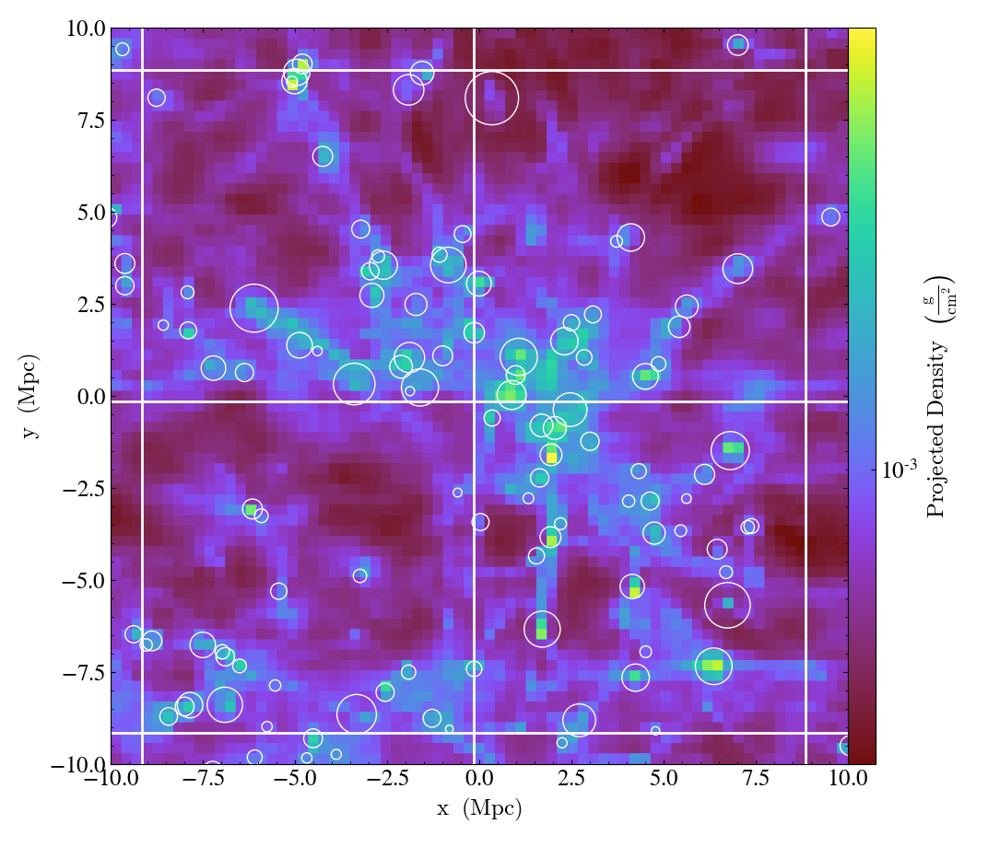

In [38]:
mass, c2 = data_ds.find_max("particle_mass")
prj = yt.ProjectionPlot(data_ds, 'z', 'density',center=[c2[0],c2[1],c2[2]], width=(20,'Mpc'))
prj.annotate_halos(hc)
prj.annotate_grids()
prj.show()

In [25]:
c2

YTArray([0.00195312, 0.00195312, 0.00195312]) code_length

yt : [INFO     ] 2019-10-07 17:01:12,017 Max Value is 1.37435e-22 at 0.5109615325927734 0.5147457122802735 0.4840908050537109
yt : [INFO     ] 2019-10-07 17:01:21,960 Projection completed
yt : [INFO     ] 2019-10-07 17:01:21,962 xlim = 0.510517 0.511406
yt : [INFO     ] 2019-10-07 17:01:21,964 ylim = 0.514301 0.515190
yt : [INFO     ] 2019-10-07 17:01:21,966 xlim = 0.510517 0.511406
yt : [INFO     ] 2019-10-07 17:01:21,967 ylim = 0.514301 0.515190
yt : [INFO     ] 2019-10-07 17:01:21,970 Making a fixed resolution buffer of (('gas', 'density')) 800 by 800
yt : [WARNING  ] 2019-10-07 17:01:22,441 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 17:01:22,485 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 17:01:22,530 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 17:01:22,575 Supplied id_loc but draw_ids is False. Not drawing grid ids
yt : [WARNING  ] 2019-10-07 17:01:2


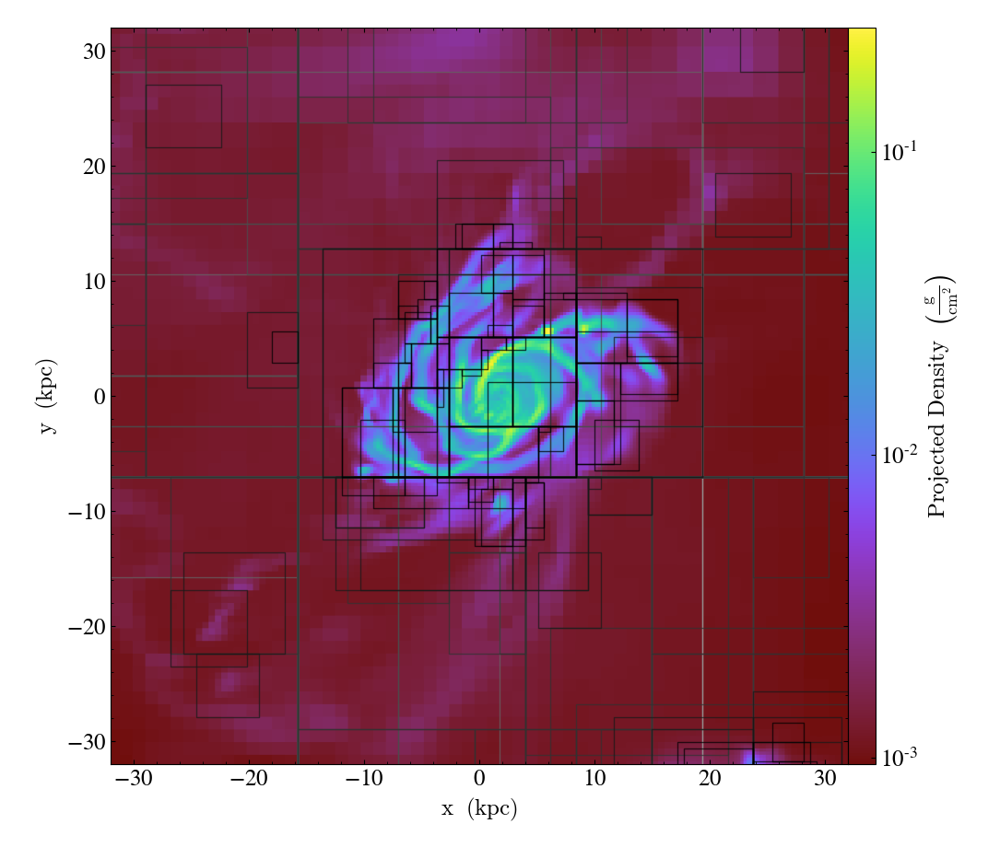

In [43]:
prj = yt.ProjectionPlot(data_ds, 'z', 'density',center='m', width=(64,'kpc'))
#prj.annotate_particles((64,'kpc'))
#prj.annotate_halos(hc)
prj.annotate_grids()
prj.show()

In [4]:
import h5py

In [5]:
handle = h5py.File("/mnt/scratch/deovratd/halo_002878/DD0276/DD0276.cpu0069","r")

In [2]:
print(dir(data_ds.fields))

['AGNParticle', 'DarkMatter', 'all', 'dark_matter', 'deposit', 'enzo', 'gas', 'index']


In [33]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

x = np.linspace(0,500)
y = np.zeros([50,1])
y = y+1.0

fort = np.loadtxt("/mnt/scratch/deovratd/Cosmological/halo_002878/StarFormationRate_16.out")
tm, radius = fort[:,2], fort[:,3]
fort = np.loadtxt("/mnt/scratch/deovratd/Cosmological/halo_002878/StarFormationRate_20.out")
tm1, radius1 = fort[:,2], fort[:,3]
fort = np.loadtxt("/mnt/scratch/deovratd/Cosmological/halo_002878/StarFormationRate_27.out")
tm2, radius2 = fort[:,2], fort[:,3]
fort = np.loadtxt("/mnt/scratch/deovratd/Cosmological/halo_002878/StarFormationRate_38.out")
tm3, radius3 = fort[:,2], fort[:,3]

fig, ax = plt.subplots(dpi=400)
ax.semilogy(tm, radius1, 'r-', label='z=3')
ax.semilogy(tm1, radius1, 'b-', label='z=2')
ax.semilogy(tm2, radius2, 'k-', label='z=1')
ax.semilogy(tm3, radius3, 'k-', label='z=0.2')
ax.legend(frameon=False, loc='upper right', fontsize=14)
ax.tick_params(bottom=True, top=True, left=True, right=True)
ax.tick_params(axis="x", direction="in", length=6, width=1)
ax.tick_params(axis="y", direction="in", length=6, width=1)
ax.tick_params(which='minor', axis="x", direction="in", length=3)
ax.tick_params(which='minor', axis="y", direction="in", length=3)
ax.spines['top'].set_linewidth(2.0)
ax.spines['bottom'].set_linewidth(2.0)
ax.spines['right'].set_linewidth(2.0)
ax.spines['left'].set_linewidth(2.0)
plt.xlim([6,0])
plt.ylim([0.1,500])
plt.xlabel('redshift')
plt.ylabel('SFR (M$_\odot$/yr)')
plt.grid(True,alpha=0.4,zorder=-10)
plt.savefig('/mnt/scratch/deovratd/Cosmological/halo_002878/SFR.pdf',dpi=400)
plt.show()

RuntimeError: latex was not able to process the following string:
b'lp'

Here is the full report generated by latex:
This is pdfTeX, Version 3.1415926-2.5-1.40.14 (TeX Live 2013)
 restricted \write18 enabled.
entering extended mode

(/mnt/home/deovratd/.cache/matplotlib/tex.cache/349983685cc735e1492e5b1ebec5dab
8.tex
LaTeX2e <2011/06/27>
Babel <v3.8m> and hyphenation patterns for english, dumylang, nohyphenation, lo
aded.
(/usr/share/texlive/texmf-dist/tex/latex/base/article.cls
Document Class: article 2007/10/19 v1.4h Standard LaTeX document class
(/usr/share/texlive/texmf-dist/tex/latex/base/size10.clo))

! LaTeX Error: File `type1cm.sty' not found.

Type X to quit or <RETURN> to proceed,
or enter new name. (Default extension: sty)

Enter file name: 
! Emergency stop.
<read *> 
         
l.4 ^^M
       
No pages of output.
Transcript written on 349983685cc735e1492e5b1ebec5dab8.log.




RuntimeError: latex was not able to process the following string:
b'lp'

Here is the full report generated by latex:
This is pdfTeX, Version 3.1415926-2.5-1.40.14 (TeX Live 2013)
 restricted \write18 enabled.
entering extended mode

(/mnt/home/deovratd/.cache/matplotlib/tex.cache/349983685cc735e1492e5b1ebec5dab
8.tex
LaTeX2e <2011/06/27>
Babel <v3.8m> and hyphenation patterns for english, dumylang, nohyphenation, lo
aded.
(/usr/share/texlive/texmf-dist/tex/latex/base/article.cls
Document Class: article 2007/10/19 v1.4h Standard LaTeX document class
(/usr/share/texlive/texmf-dist/tex/latex/base/size10.clo))

! LaTeX Error: File `type1cm.sty' not found.

Type X to quit or <RETURN> to proceed,
or enter new name. (Default extension: sty)

Enter file name: 
! Emergency stop.
<read *> 
         
l.4 ^^M
       
No pages of output.
Transcript written on 349983685cc735e1492e5b1ebec5dab8.log.




<Figure size 2400x1600 with 1 Axes>